In [1]:
import numpy as np
import pandas as pd
import os

%load_ext autoreload
%autoreload 2

In [2]:
pb_df = pd.read_csv('results_final.csv')

In [3]:
pb_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54756 entries, 0 to 54755
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Video Id                54756 non-null  object 
 1   Publish Date            54756 non-null  object 
 2   Channel Id              54756 non-null  object 
 3   Video Title             54756 non-null  object 
 4   Video Description       51130 non-null  object 
 5   Channel Title           54756 non-null  object 
 6   Video Tags              54756 non-null  object 
 7   Default Audio Language  54756 non-null  object 
 8   Video Views             54756 non-null  float64
 9   Video Likes             54756 non-null  float64
 10  Favorite Count          54756 non-null  float64
 11  Comment Count           54756 non-null  float64
 12  Channel Country         54756 non-null  object 
 13  Query                   54756 non-null  object 
 14  Caption Saved           54756 non-null

In [4]:
base_folder = 'D:\\User\\Documents\\AY2024-2025\\THS-ST1\\Pinoy Baiting Data Collection'  # Change to your local file directory
folders = {
    'titles': os.path.join(base_folder, 'titles'),
    'descriptions': os.path.join(base_folder, 'descriptions'),
    'tags': os.path.join(base_folder, 'tags')
}

In [5]:
for folder in folders.values():
    os.makedirs(folder, exist_ok=True)

In [ ]:
import os
import pandas as pd

filtered_df = pb_df[pb_df['Caption Saved'] == 'Yes']

# Define the folder containing the transcripts
transcript_folder = r'D:\User\Documents\AY2024-2025\THS-ST1\Pinoy Baiting Data Collection\1-17-2024 - transcripts & results\Video Captions'

# Define the output folders for titles, descriptions, and tags 
output_folder = r'D:\User\Documents\AY2024-2025\THS-ST1\Pinoy Baiting Data Collection' # Change to your local file directory
titles_folder = os.path.join(output_folder, 'titles')
descriptions_folder = os.path.join(output_folder, 'descriptions')
tags_folder = os.path.join(output_folder, 'tags')

# Create output folders if they don't exist
os.makedirs(titles_folder, exist_ok=True)
os.makedirs(descriptions_folder, exist_ok=True)
os.makedirs(tags_folder, exist_ok=True)

# Function to count the number of words in a string
def count_words(text):
    return len(text.split())

# Loop through the transcripts
for file_name in os.listdir(transcript_folder):
    if "captions" in file_name:  # Check if "captions" is in the file name
        video_id = file_name.split('_captions')[0]  # Extract Video ID from filename
        print(f"Processing Video ID: {video_id}")

        # Load the transcript
        with open(os.path.join(transcript_folder, file_name), 'r', encoding='utf-8') as f:
            transcript = f.read()
        
        # Check if the transcript has at least 50 words
        if count_words(transcript) >= 50:
            print(f"Transcript has {count_words(transcript)} words.")

            row = filtered_df[filtered_df['Video Id'] == video_id]
            if not row.empty:
                #title = str(row['Video Title'].values[0]) if pd.notna(row['Video Title'].values[0]) else ''
                #description = str(row['Video Description'].values[0]) if pd.notna(row['Video Description'].values[0]) else ''
                tags = str(row['Video Tags'].values[0]) if pd.notna(row['Video Tags'].values[0]) else ''
                
               # if title:
                   # with open(os.path.join(titles_folder, f'{video_id}.txt'), 'w', encoding='utf-8') as f:
                       # f.write(title)
                   # print(f"Title file created for Video ID: {video_id}")

                #if description:
                    #with open(os.path.join(descriptions_folder, f'{video_id}.txt'), 'w', encoding='utf-8') as f:
                        #f.write(description)
                    #print(f"Description file created for Video ID: {video_id}")

                if tags:
                    # Convert the tags from a list to a comma-separated string
                    tags_string = ', '.join(eval(tags))  # Use eval to convert the string representation of the list back to a list
                    with open(os.path.join(tags_folder, f'{video_id}.txt'), 'w', encoding='utf-8') as f:
                        f.write(tags_string)
                    print(f"Tags file created for Video ID: {video_id}")
            else:
                print(f"No matching row found for Video ID: {video_id}")
        else:
            print(f"Transcript for Video ID {video_id} does not have at least 50 words.")

print("Processing completed.")


Processing Video ID: --79DZpqC1Q
Transcript has 2131 words.
Tags file created for Video ID: --79DZpqC1Q
Processing Video ID: --8n6A8Q6M0
Transcript has 9475 words.
Tags file created for Video ID: --8n6A8Q6M0
Processing Video ID: --FPAqqHjbk
Transcript for Video ID --FPAqqHjbk does not have at least 50 words.
Processing Video ID: --k-epaIuQc
Transcript has 1433 words.
Tags file created for Video ID: --k-epaIuQc
Processing Video ID: --LaQ3Jped0
Transcript has 1175 words.
Tags file created for Video ID: --LaQ3Jped0
Processing Video ID: --LqkCVvfuY
Transcript has 1249 words.
Tags file created for Video ID: --LqkCVvfuY
Processing Video ID: --mC2v1pwLk
Transcript for Video ID --mC2v1pwLk does not have at least 50 words.
Processing Video ID: --MsO6kI9-4
Transcript has 82 words.
Tags file created for Video ID: --MsO6kI9-4
Processing Video ID: --sGh9Hz9WY
Transcript has 61 words.
Tags file created for Video ID: --sGh9Hz9WY
Processing Video ID: --V4xWmcjZ8
Transcript has 631 words.
Tags file cre

In [7]:
import os

# Define the folder containing the text files
folder_path = r'D:\User\Documents\AY2024-2025\THS-ST1\Pinoy Baiting Data Collection\tags'

# Function to count the number of words in a text
def count_words(text):
    return len(text.split())

# Loop through the files in the folder
for file_name in os.listdir(folder_path):
    if file_name.endswith('.txt'):  # Ensure only .txt files are processed
        file_path = os.path.join(folder_path, file_name)

        # Read the contents of the file
        with open(file_path, 'r', encoding='utf-8') as file:
            content = file.read()
        
        # Count the number of words in the file
        word_count = count_words(content)
        
        # Remove the file if it contains fewer than 6 words
        if word_count < 8:
            print(f"Removing file: {file_name}, Word count: {word_count}")
            os.remove(file_path)

print("Processing completed.")


Removing file: --LqkCVvfuY.txt, Word count: 0
Removing file: --xwCxbgdgA.txt, Word count: 0
Removing file: -0mjAFx-0Q8.txt, Word count: 0
Removing file: -1cDhye9yTI.txt, Word count: 0
Removing file: -2if3y66unk.txt, Word count: 2
Removing file: -2Xb0FltxKg.txt, Word count: 0
Removing file: -3C38rFiKg4.txt, Word count: 7
Removing file: -3rGtR_J1rQ.txt, Word count: 5
Removing file: -49g3nOBmaM.txt, Word count: 0
Removing file: -62AFWMQ1Jw.txt, Word count: 0
Removing file: -74q3iOz9-M.txt, Word count: 3
Removing file: -774ts_3Onc.txt, Word count: 0
Removing file: -7kPJRouYRc.txt, Word count: 7
Removing file: -7xTUvFu9Vw.txt, Word count: 2
Removing file: -8HpqjT4XHc.txt, Word count: 0
Removing file: -8k5nTanrcQ.txt, Word count: 0
Removing file: -8ltg_re9wQ.txt, Word count: 0
Removing file: -9-Yavj_m2A.txt, Word count: 0
Removing file: -a1J7MMUkc4.txt, Word count: 0
Removing file: -aHEBK_Qkq4.txt, Word count: 0
Removing file: -b_-rxhSpvI.txt, Word count: 4
Removing file: -D6ljxFk4yg.txt, Wo

In [ ]:
import os

# Step 1: Define K-pop related keywords
kpop_keywords = ['KPOP', 'BTS', 'Blackpink', 'Twice', 'EXO', 'K-pop', 'Seventeen', 'Stray Kids', 'NCT', 'Kdrama', 'Aespa', 'Taehyung', 'Jimin', 'Jungkook']

# Step 2: Define the directory containing transcript files
transcripts_dir = r'D:\\User\\Documents\\AY2024-2025\\THS-ST1\\Pinoy Baiting Data Collection\\Final\\cleaned_transcripts'
non_kpop_transcripts_dir = r'D:\\User\\Documents\\AY2024-2025\\THS-ST1\\Pinoy Baiting Data Collection\\Final\\filtered'

# Step 3: Create the output folder if it doesn't exist
os.makedirs(non_kpop_transcripts_dir, exist_ok=True)

# Step 4: Function to check if a file contains any K-pop related words
def contains_kpop_keywords(text, keywords):
    return any(keyword in text for keyword in keywords)

# Step 5: List to store filenames containing K-pop-related keywords
kpop_files = []

# Step 6: Iterate through the text files and filter
for file_name in os.listdir(transcripts_dir):
    if file_name.endswith(".txt"):
        file_path = os.path.join(transcripts_dir, file_name)
        with open(file_path, 'r', encoding='utf-8') as file:
            content = file.read()
        
        # Step 7: Check for K-pop keywords and filter accordingly
        if contains_kpop_keywords(content, kpop_keywords):
            kpop_files.append(file_name)  # Store the filename where K-pop keywords are found
        else:
            # If the content does not contain K-pop keywords, copy the file
            non_kpop_file_path = os.path.join(non_kpop_transcripts_dir, file_name)
            with open(non_kpop_file_path, 'w', encoding='utf-8') as non_kpop_file:
                non_kpop_file.write(content)

# Step 8: Print filenames where K-pop related keywords exist
if kpop_files:
    print("Files containing K-pop related keywords:")
    for file in kpop_files:
        print(file)
else:
    print("No files containing K-pop related keywords found.")

print("Filtering complete. Non-Kpop files saved to:", non_kpop_transcripts_dir)


Coherence Score: 0.45568227038835046


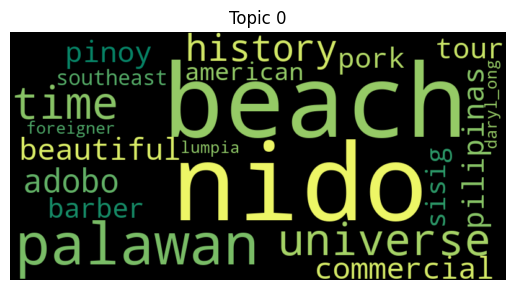

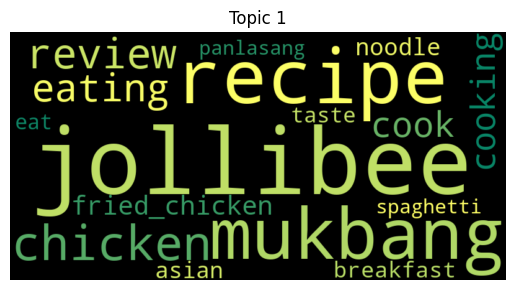

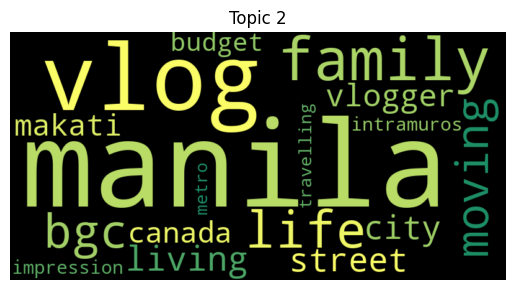

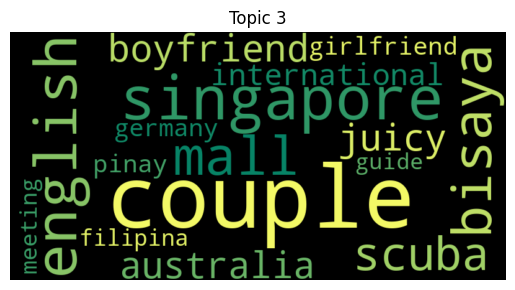

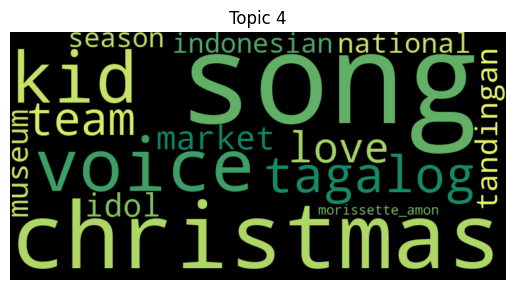

...

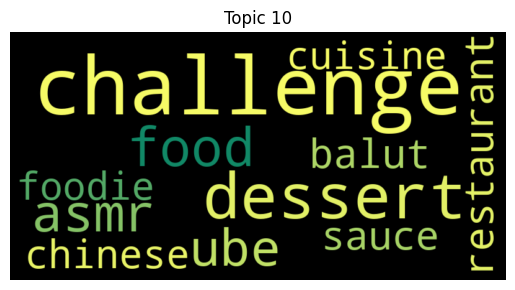

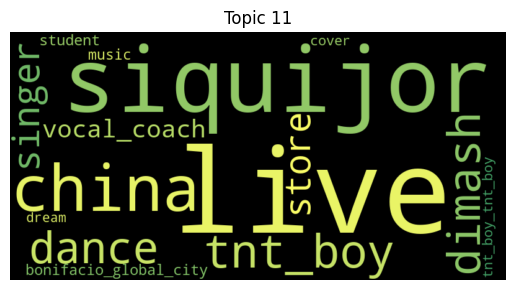

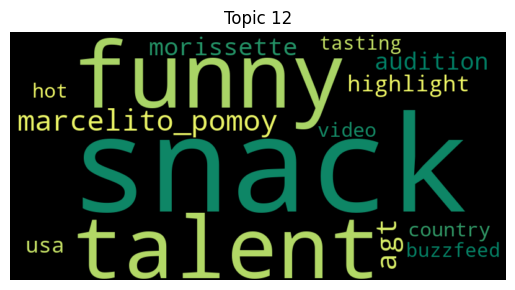

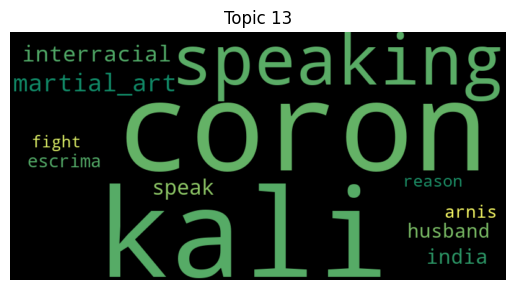

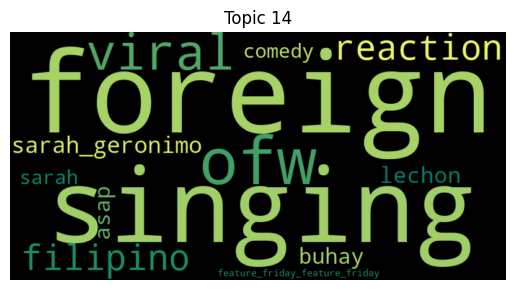

Topic 0:
['nido', 'beach', 'palawan', 'time', 'universe', 'history', 'adobo', 'beautiful', 'commercial', 'pilipinas', 'pinoy', 'tour', 'pork', 'barber', 'sisig', 'american', 'southeast', 'foreigner', 'daryl_ong', 'lumpia']
Topic 1:
['jollibee', 'recipe', 'mukbang', 'chicken', 'review', 'pinoy', 'adobo', 'eating', 'cook', 'cooking', 'fried_chicken', 'pork', 'noodle', 'asian', 'breakfast', 'taste', 'eat', 'time', 'panlasang', 'spaghetti']
Topic 2:
['manila', 'vlog', 'family', 'life', 'foreigner', 'tour', 'bgc', 'moving', 'living', 'street', 'city', 'vlogger', 'makati', 'canada', 'budget', 'time', 'impression', 'intramuros', 'metro', 'travelling']
Topic 3:
['couple', 'vlog', 'singapore', 'english', 'vlogger', 'bisaya', 'mall', 'scuba', 'time', 'foreigner', 'boyfriend', 'juicy', 'australia', 'international', 'girlfriend', 'germany', 'pinay', 'filipina', 'meeting', 'guide']
Topic 4:
['song', 'christmas', 'street', 'voice', 'kid', 'tagalog', 'pinoy', 'team', 'makati', 'love', 'market', 'idol

In [9]:
import os
import random
import nltk
import requests
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from gensim import corpora
from gensim.models import LdaModel, CoherenceModel
from gensim.models.phrases import Phrases, Phraser
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from nltk.stem import WordNetLemmatizer

folder_path = 'tags/'

# Read text files
def load_documents(folder_path, sample_size=None):
    documents = []
    all_files = [file_name for file_name in os.listdir(folder_path) if file_name.endswith('.txt')]
    
    # Randomly select files if sample_size is provided
    if sample_size and len(all_files) > sample_size:
        selected_files = random.sample(all_files, sample_size)
    else:
        selected_files = all_files  # Use all files if sample_size is None or less than total files
    
    for file_name in selected_files:
        with open(os.path.join(folder_path, file_name), 'r', encoding='utf-8') as file:
            documents.append(file.read())
    return documents

# Load a random sample of 1000 documents
documents = load_documents(folder_path, sample_size=1000)

# Function to fetch stopwords from GitHub URL
def fetch_stopwords_from_github(url):
    response = requests.get(url)
    github_stopwords = response.text.splitlines()  # Split by new lines
    return set(github_stopwords)

# GitHub URL for stopwords
github_stopwords_url = 'https://raw.githubusercontent.com/stopwords-iso/stopwords-en/master/stopwords-en.txt'
github_stopwords = fetch_stopwords_from_github(github_stopwords_url)

stop_words = set(stopwords.words('english'))
custom_stop_words = ['like', 'yeah', 'know', 'um', 'uh', 'really', 'one', 'go', 'right', 'okay', 'well', 'said', 'going', 'got', 'na', 'always', 'every', 'each', 'say',
                    'el', 'little', 'still', 'best', 'dutch']
broad_terms = ['philippines', 'philippine', 'british', 'filipino', 'video', 'http', 'korea', 'korean', 'Youtube', 'youtube', 'YouTube', 'Google', 'united', 'america','America', 'american']
kpop_keywords = ['kpop', '필리핀', 'BTS', 'Blackpink', 'Twice', 'EXO', 'K-pop', 'Seventeen', 'Stray Kids', 'NCT', 'Kdrama', 'Aespa', 'Taehyung', 'Jimin', 'Jungkook']
news_doc_keywords = [
    'breaking news', 'report', 'coverage', 'investigation', 'interview', 'documentary', 
    'journalist', 'headline', 'reporter', 'current events', 'special report', 
    'analysis', 'documented', 'broadcast', 'reporting', 'v', 'food', 'travel', 'react','reacts','reaction', 'foreigner', 'thing', 'visit',
    'dc', 'japan', 'first', 'fast', 'asia', 'ang', 'indian', 'thai', 'vietnamese'
]
# Add custom and broad terms
stop_words.update(custom_stop_words, broad_terms, kpop_keywords, news_doc_keywords, github_stopwords)

lemmatizer = WordNetLemmatizer()

# Preprocessing function to tokenize, lemmatize, and remove stopwords
def preprocess_text(doc):
    tokens = word_tokenize(doc.lower())
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word.isalpha() and word not in stop_words]
    return tokens

preprocessed_docs = [preprocess_text(doc) for doc in documents]

# Create bigram and trigram models to detect common phrases
bigram = Phrases(preprocessed_docs, min_count=5, threshold=100)
bigram_mod = Phraser(bigram)
trigram = Phrases(bigram[preprocessed_docs], min_count=5, threshold=100)
trigram_mod = Phraser(trigram)

# Apply bigram and trigram models to documents
preprocessed_docs = [trigram_mod[bigram_mod[doc]] for doc in preprocessed_docs]

# Create dictionary
dictionary = corpora.Dictionary(preprocessed_docs)

# Apply frequency-based filtering
# Filter out words that appear in less than 5 documents or more than 80% of the documents
dictionary.filter_extremes(no_below=5, no_above=0.8)

# Create the corpus
corpus = [dictionary.doc2bow(doc) for doc in preprocessed_docs]

# Train the LDA model
lda_model = LdaModel(corpus, num_topics=15, id2word=dictionary, passes=15, random_state=42, alpha='auto', per_word_topics=True)

import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

# Visualize the topics
lda_display = gensimvis.prepare(lda_model, corpus, dictionary, sort_topics=False)
pyLDAvis.display(lda_display)

# Evaluate the model using coherence score
coherence_model_lda = CoherenceModel(model=lda_model, texts=preprocessed_docs, dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print(f'Coherence Score: {coherence_lda}')

# Initialize a global set to track all assigned words across topics
all_assigned_words = set()

# Generate and display word clouds for each topic while avoiding duplicate words
for topic_id in range(lda_model.num_topics):
    words_with_prob = lda_model.show_topic(topic_id, 20)
    
    # Create a list to store unique words for the current topic
    unique_words = []
    
    # Filter words that are not already assigned to other topics
    for word, prob in words_with_prob:
        if word not in all_assigned_words:
            unique_words.append(word)
            all_assigned_words.add(word)  # Mark this word as assigned
    
    # Create a word frequency dictionary for the word cloud from unique words
    word_freq = {word: prob for word, prob in words_with_prob if word in unique_words}
    
    # Generate and display the word cloud
    if word_freq:  # Check if there are any words to display
        wordcloud = WordCloud(width=800, height=400, colormap='summer').generate_from_frequencies(word_freq)
        plt.figure()
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis("off")
        plt.title(f"Topic {topic_id}")
        plt.show()

# Print the most frequent words in each topic without redundancies
for topic_id in range(lda_model.num_topics):
    words_in_topic = [word for word, prob in lda_model.show_topic(topic_id, topn=20) if word in all_assigned_words]
    print(f"Topic {topic_id}:")
    print(words_in_topic)




Coherence Score: 0.4742037643236913


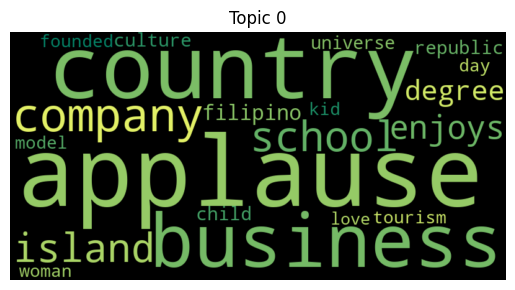

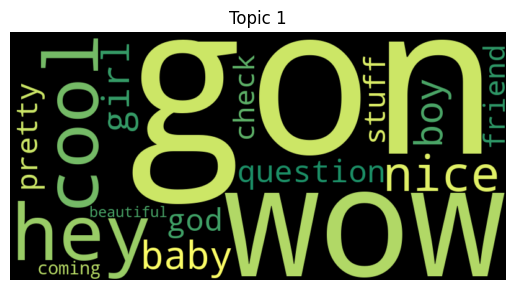

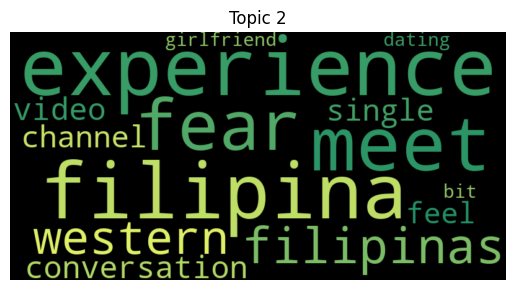

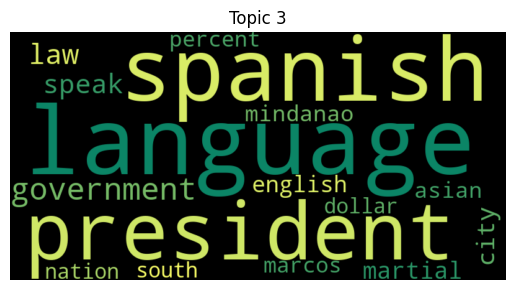

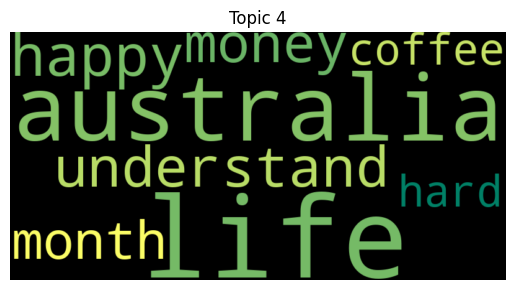

...

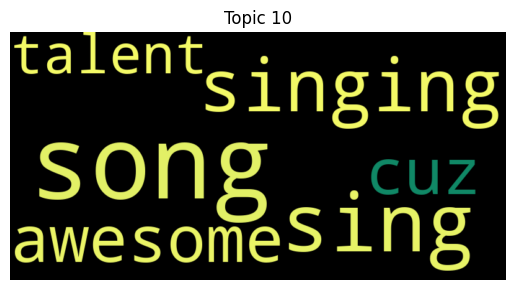

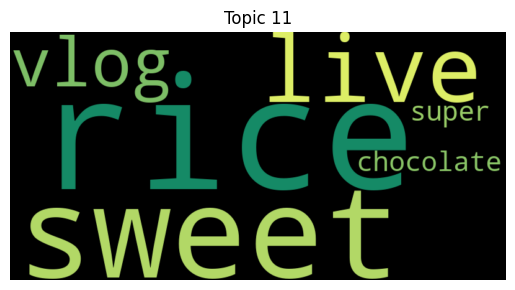

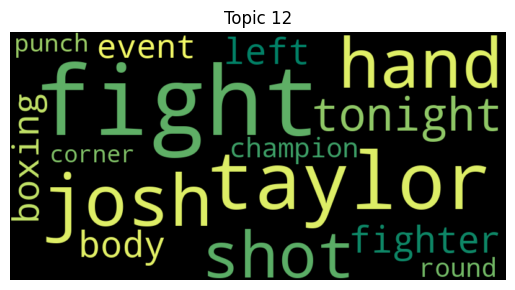

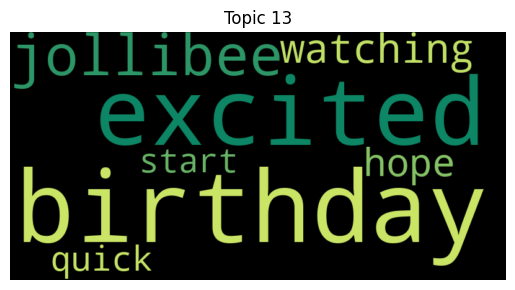

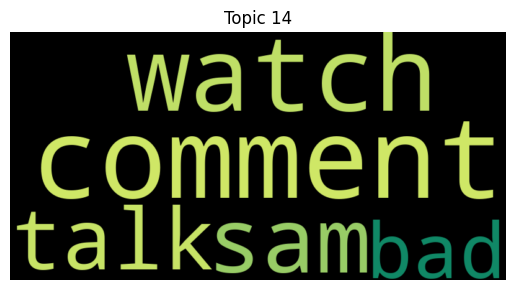

Topic 0:
['applause', 'country', 'business', 'company', 'school', 'island', 'enjoys', 'degree', 'filipino', 'republic', 'child', 'culture', 'universe', 'day', 'model', 'tourism', 'kid', 'founded', 'woman', 'love']
Topic 1:
['gon', 'wow', 'love', 'day', 'woman', 'hey', 'cool', 'nice', 'baby', 'boy', 'girl', 'question', 'god', 'pretty', 'stuff', 'kid', 'friend', 'check', 'coming', 'beautiful']
Topic 2:
['girl', 'experience', 'filipina', 'meet', 'woman', 'fear', 'gon', 'child', 'filipinas', 'western', 'conversation', 'video', 'channel', 'single', 'filipino', 'pretty', 'feel', 'girlfriend', 'dating', 'bit']
Topic 3:
['country', 'language', 'filipino', 'spanish', 'president', 'government', 'law', 'speak', 'city', 'martial', 'english', 'asian', 'mindanao', 'percent', 'marcos', 'south', 'day', 'gon', 'nation', 'dollar']
Topic 4:
['nice', 'cool', 'question', 'day', 'bit', 'gon', 'friend', 'life', 'hey', 'video', 'australia', 'happy', 'love', 'understand', 'money', 'country', 'month', 'business

In [12]:
import os
import random
import nltk
import requests
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from gensim import corpora
from gensim.models import LdaModel, CoherenceModel
from gensim.models.phrases import Phrases, Phraser
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from nltk.stem import WordNetLemmatizer

folder_path = 'test-transcripts/'

# Read text files
def load_documents(folder_path, sample_size=None):
    documents = []
    all_files = [file_name for file_name in os.listdir(folder_path) if file_name.endswith('.txt')]
    
    # Randomly select files if sample_size is provided
    if sample_size and len(all_files) > sample_size:
        selected_files = random.sample(all_files, sample_size)
    else:
        selected_files = all_files  # Use all files if sample_size is None or less than total files
    
    for file_name in selected_files:
        with open(os.path.join(folder_path, file_name), 'r', encoding='utf-8') as file:
            documents.append(file.read())
    return documents

# Load a random sample of 1000 documents
documents = load_documents(folder_path, sample_size=1000)

# Function to fetch stopwords from GitHub URL
def fetch_stopwords_from_github(url):
    response = requests.get(url)
    github_stopwords = response.text.splitlines()  # Split by new lines
    return set(github_stopwords)

# GitHub URL for stopwords
github_stopwords_url = 'https://raw.githubusercontent.com/stopwords-iso/stopwords-en/master/stopwords-en.txt'
github_stopwords = fetch_stopwords_from_github(github_stopwords_url)

stop_words = set(stopwords.words('english'))
custom_stop_words = ['like', 'yeah', 'know', 'um', 'uh', 'really', 'one', 'go', 'right', 'okay', 'well', 'said', 'going', 'got', 'na', 'always', 'every', 'each', 'say',
                    'el', 'little', 'still', 'best', 'dutch']
broad_terms = ['philippines', 'philippine', 'british', 'filipino', 'video', 'http', 'korea', 'korean', 'Youtube', 'youtube', 'YouTube', 'Google', 'united', 'america','America', 'american']
kpop_keywords = ['kpop', '필리핀', 'BTS', 'Blackpink', 'Twice', 'EXO', 'K-pop', 'Seventeen', 'Stray Kids', 'NCT', 'Kdrama', 'Aespa', 'Taehyung', 'Jimin', 'Jungkook']
news_doc_keywords = [
    'news', 'report', 'coverage', 'investigation', 'interview', 'documentary', 
    'journalist', 'headline', 'reporter', 'current events', 'special report', 
    'analysis', 'documented', 'broadcast', 'reporting', 'v', 'food', 'travel', 'react','reacts','reaction', 'foreigner', 'thing', 'visit',
    'dc', 'japan', 'first', 'fast', 'asia', 'ang', 'indian', 'thai', 'vietnamese'
]
# Add custom and broad terms
stop_words.update(custom_stop_words, broad_terms, kpop_keywords, news_doc_keywords, github_stopwords)

lemmatizer = WordNetLemmatizer()

# Preprocessing function to tokenize, lemmatize, and remove stopwords
def preprocess_text(doc):
    tokens = word_tokenize(doc.lower())
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word.isalpha() and word not in stop_words]
    return tokens

preprocessed_docs = [preprocess_text(doc) for doc in documents]

# Create dictionary
dictionary = corpora.Dictionary(preprocessed_docs)

# Apply frequency-based filtering
# Filter out words that appear in less than 5 documents or more than 80% of the documents
dictionary.filter_extremes(no_below=5, no_above=0.8)

# Create the corpus
corpus = [dictionary.doc2bow(doc) for doc in preprocessed_docs]

# Train the LDA model
lda_model = LdaModel(corpus, num_topics=15, id2word=dictionary, passes=15, random_state=42, alpha='auto', per_word_topics=True)

import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

# Visualize the topics
lda_display = gensimvis.prepare(lda_model, corpus, dictionary, sort_topics=False)
pyLDAvis.display(lda_display)

# Evaluate the model using coherence score
coherence_model_lda = CoherenceModel(model=lda_model, texts=preprocessed_docs, dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print(f'Coherence Score: {coherence_lda}')

# Initialize a global set to track all assigned words across topics
all_assigned_words = set()

# Generate and display word clouds for each topic while avoiding duplicate words
for topic_id in range(lda_model.num_topics):
    words_with_prob = lda_model.show_topic(topic_id, 20)
    
    # Create a list to store unique words for the current topic
    unique_words = []
    
    # Filter words that are not already assigned to other topics
    for word, prob in words_with_prob:
        if word not in all_assigned_words:
            unique_words.append(word)
            all_assigned_words.add(word)  # Mark this word as assigned
    
    # Create a word frequency dictionary for the word cloud from unique words
    word_freq = {word: prob for word, prob in words_with_prob if word in unique_words}
    
    # Generate and display the word cloud
    if word_freq:  # Check if there are any words to display
        wordcloud = WordCloud(width=800, height=400, colormap='summer').generate_from_frequencies(word_freq)
        plt.figure()
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis("off")
        plt.title(f"Topic {topic_id}")
        plt.show()

# Print the most frequent words in each topic without redundancies
for topic_id in range(lda_model.num_topics):
    words_in_topic = [word for word, prob in lda_model.show_topic(topic_id, topn=20) if word in all_assigned_words]
    print(f"Topic {topic_id}:")
    print(words_in_topic)




# Comparing LDA with HDP (via coherence scores)

Processing file: uC8iNb9PXnA_captions.txt

LDA Coherence Score for uC8iNb9PXnA_captions.txt: 0.3164
HDP Coherence Score for uC8iNb9PXnA_captions.txt: 0.3431



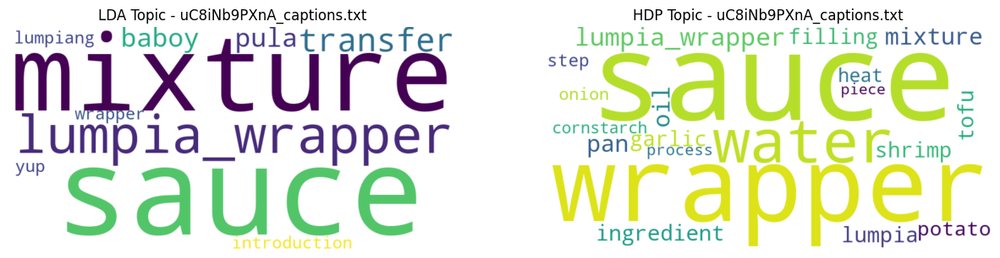

Processing file: 4Ekd1OGwPyE_captions.txt

LDA Coherence Score for 4Ekd1OGwPyE_captions.txt: 0.2737
HDP Coherence Score for 4Ekd1OGwPyE_captions.txt: 0.3263



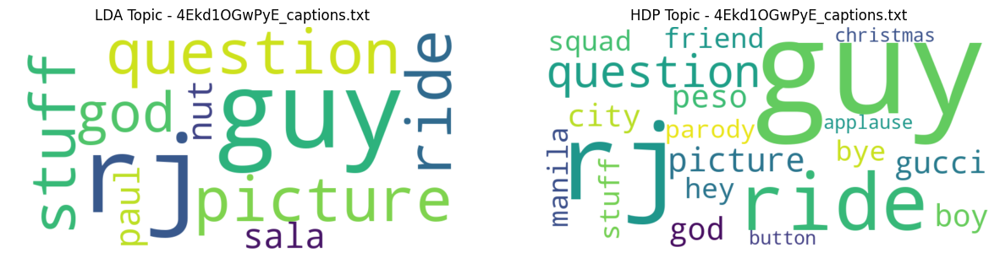

Processing file: L--a9N9OqnA_captions.txt

LDA Coherence Score for L--a9N9OqnA_captions.txt: 0.2814
HDP Coherence Score for L--a9N9OqnA_captions.txt: 0.2771



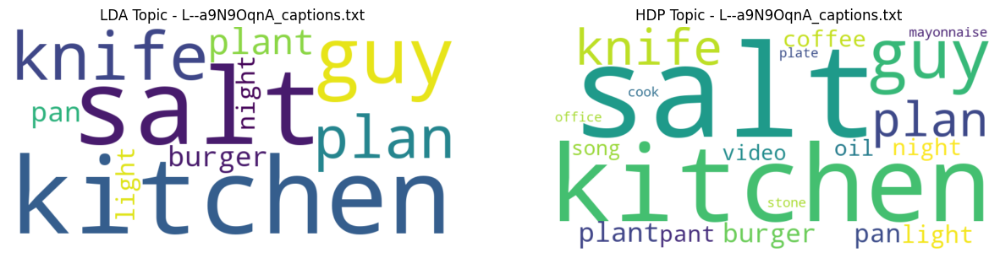

Processing file: 5StlXqODnXY_captions.txt

LDA Coherence Score for 5StlXqODnXY_captions.txt: 0.2917
HDP Coherence Score for 5StlXqODnXY_captions.txt: 0.2406



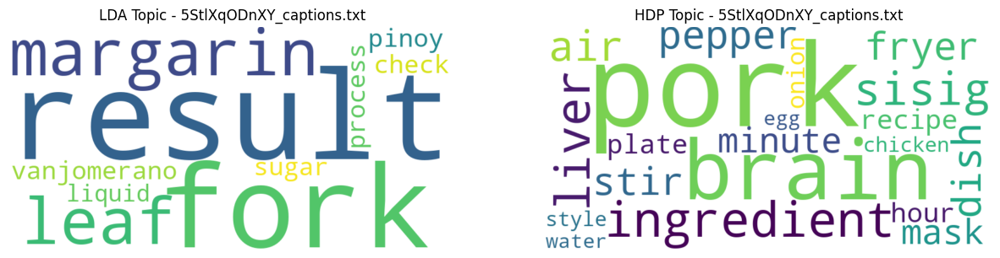

Processing file: 9hWiKgR22YQ_captions.txt

LDA Coherence Score for 9hWiKgR22YQ_captions.txt: 0.7705
HDP Coherence Score for 9hWiKgR22YQ_captions.txt: 0.7838



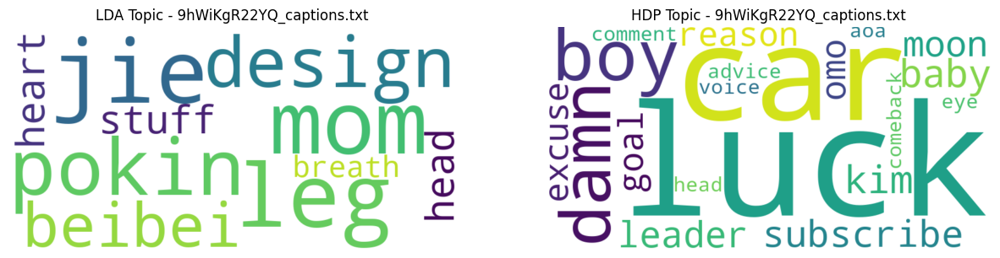

Processing file: mhdQUSXitLU_captions.txt

LDA Coherence Score for mhdQUSXitLU_captions.txt: 0.2880
HDP Coherence Score for mhdQUSXitLU_captions.txt: 0.2297



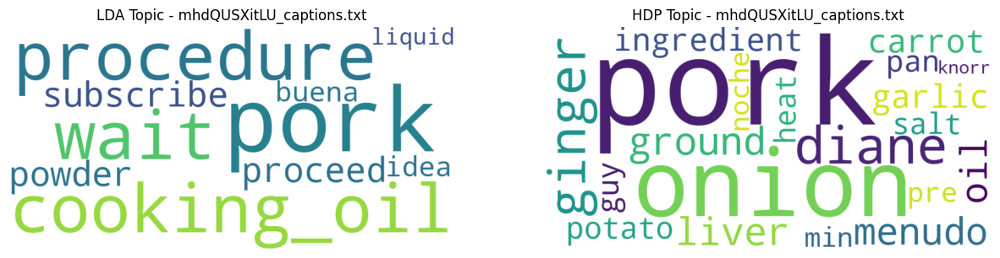

Processing file: S0V6aemmdaY_captions.txt

LDA Coherence Score for S0V6aemmdaY_captions.txt: 1.0000
HDP Coherence Score for S0V6aemmdaY_captions.txt: 1.0000



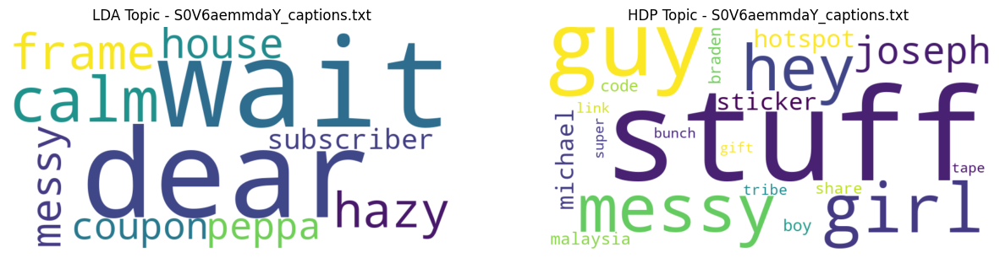

Processing file: CmlXldfVwh8_captions.txt

LDA Coherence Score for CmlXldfVwh8_captions.txt: 0.2518
HDP Coherence Score for CmlXldfVwh8_captions.txt: 0.3730



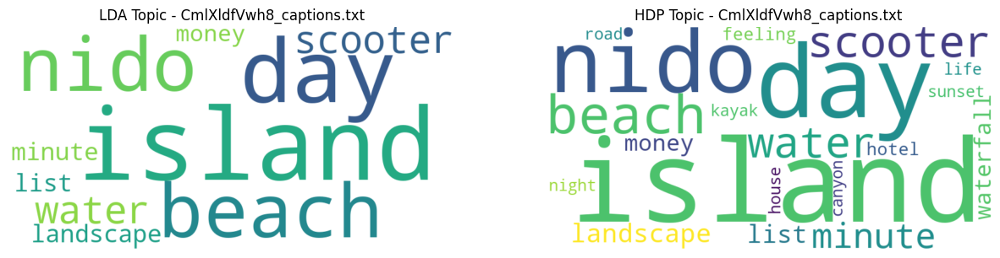

Processing file: 1wXQDBV0nPA_captions.txt

LDA Coherence Score for 1wXQDBV0nPA_captions.txt: 0.7563
HDP Coherence Score for 1wXQDBV0nPA_captions.txt: 0.7468



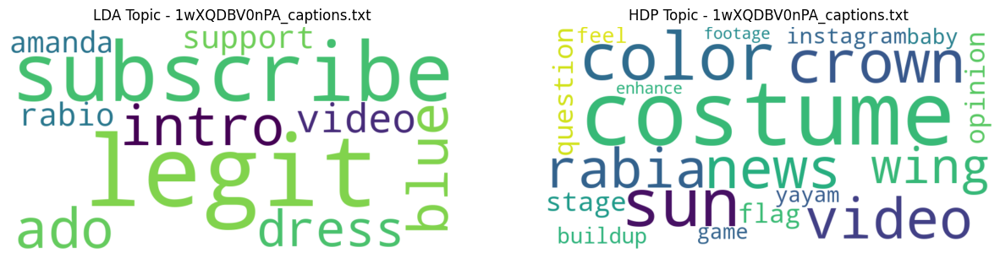

Processing file: WRhCPVU3rOE_captions.txt

LDA Coherence Score for WRhCPVU3rOE_captions.txt: 0.5475
HDP Coherence Score for WRhCPVU3rOE_captions.txt: 0.5789



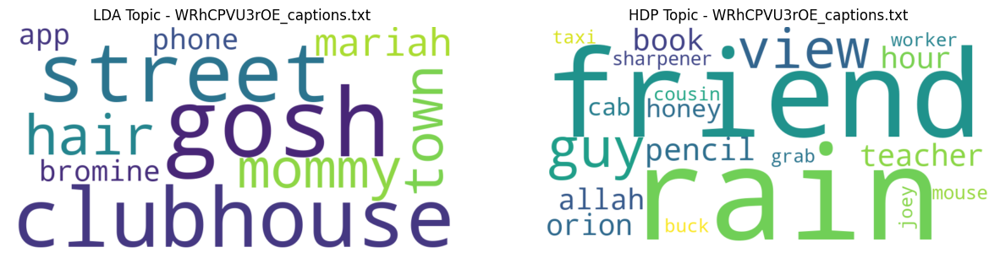

Processing file: kEPd2dQA9ZY_captions.txt

LDA Coherence Score for kEPd2dQA9ZY_captions.txt: 0.4986
HDP Coherence Score for kEPd2dQA9ZY_captions.txt: 0.5216



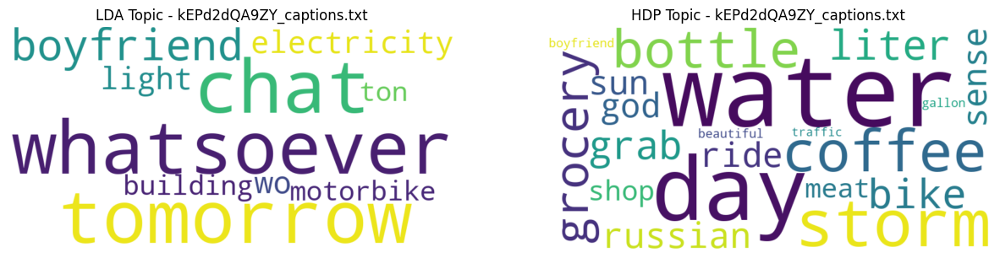

Processing file: 6taB-8ijhSg_captions.txt

LDA Coherence Score for 6taB-8ijhSg_captions.txt: 0.3308
HDP Coherence Score for 6taB-8ijhSg_captions.txt: 0.3630



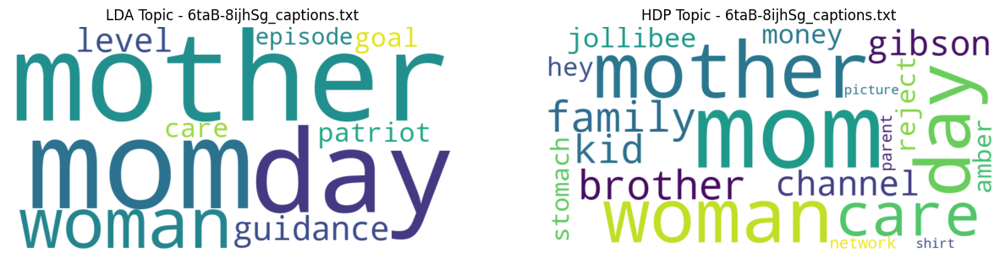

Processing file: VngoWfLpQDo_captions.txt

LDA Coherence Score for VngoWfLpQDo_captions.txt: 0.6003
HDP Coherence Score for VngoWfLpQDo_captions.txt: 0.5896



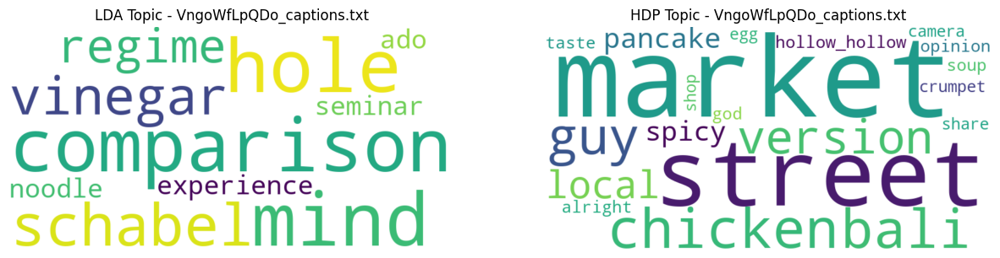

Processing file: lw0W4iSHbaw_captions.txt

LDA Coherence Score for lw0W4iSHbaw_captions.txt: 0.5472
HDP Coherence Score for lw0W4iSHbaw_captions.txt: 0.5413



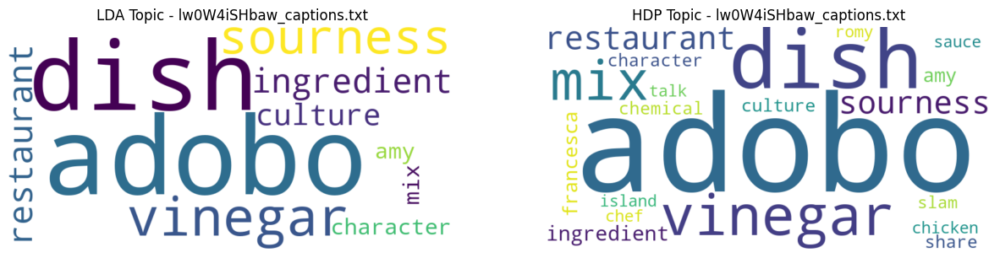

Processing file: 6duXJoSwYFY_captions.txt

LDA Coherence Score for 6duXJoSwYFY_captions.txt: 0.2480
HDP Coherence Score for 6duXJoSwYFY_captions.txt: 0.6544



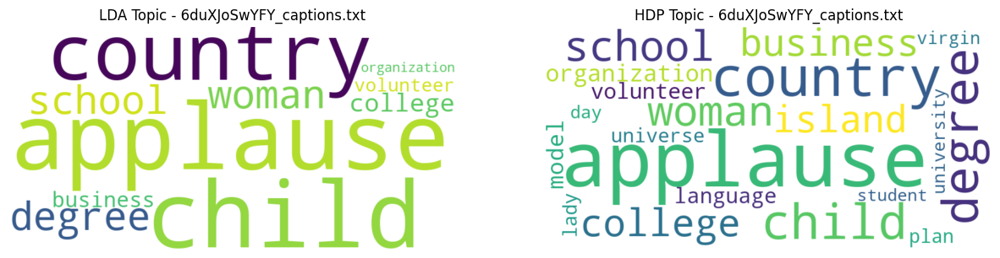

Processing file: cYWfsTwTHN8_captions.txt

LDA Coherence Score for cYWfsTwTHN8_captions.txt: 0.2684
HDP Coherence Score for cYWfsTwTHN8_captions.txt: 0.3651



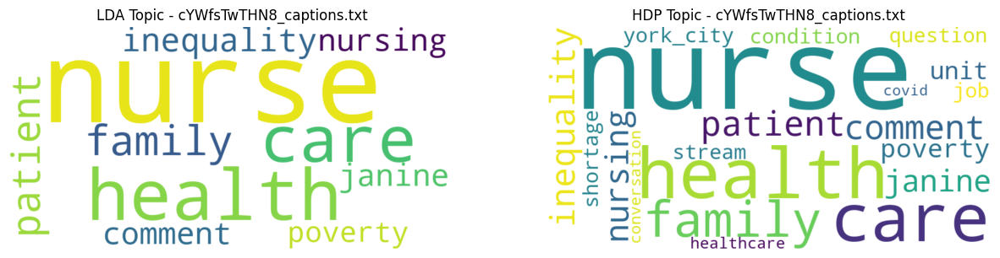

Processing file: UMX1U34ISaU_captions.txt

LDA Coherence Score for UMX1U34ISaU_captions.txt: 0.7225
HDP Coherence Score for UMX1U34ISaU_captions.txt: 0.6553



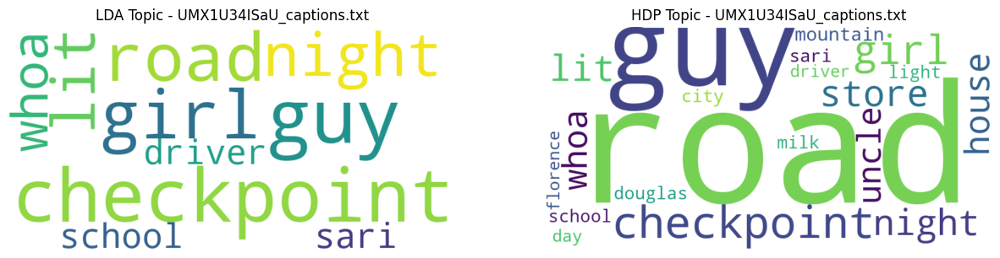

Processing file: 4DoAEVIEu_s_captions.txt

LDA Coherence Score for 4DoAEVIEu_s_captions.txt: 0.2742
HDP Coherence Score for 4DoAEVIEu_s_captions.txt: 0.3172



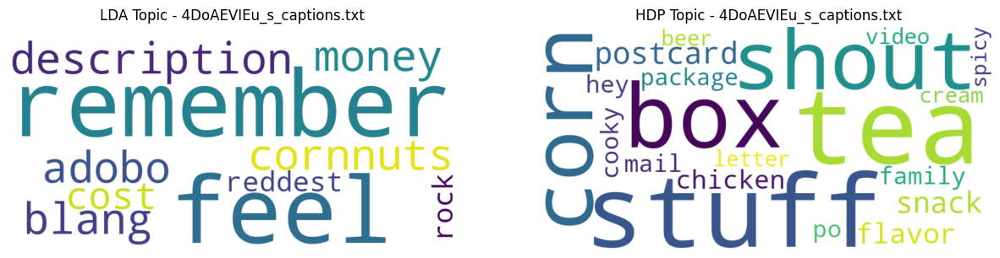

Processing file: eV66hRLAl8A_captions.txt

LDA Coherence Score for eV66hRLAl8A_captions.txt: 0.6443
HDP Coherence Score for eV66hRLAl8A_captions.txt: 0.6389



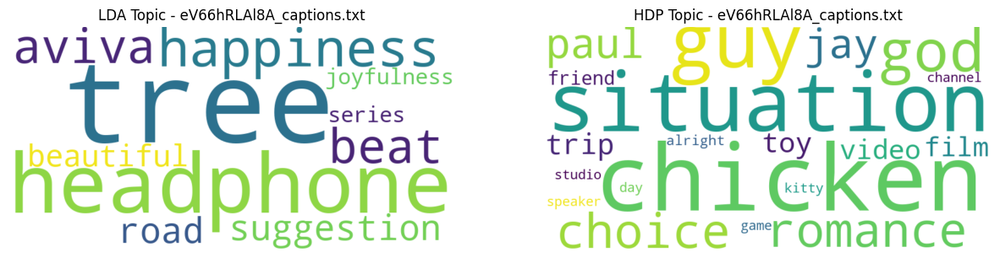

Processing file: VewZ4hRJUmA_captions.txt

LDA Coherence Score for VewZ4hRJUmA_captions.txt: 0.5471
HDP Coherence Score for VewZ4hRJUmA_captions.txt: 0.6118



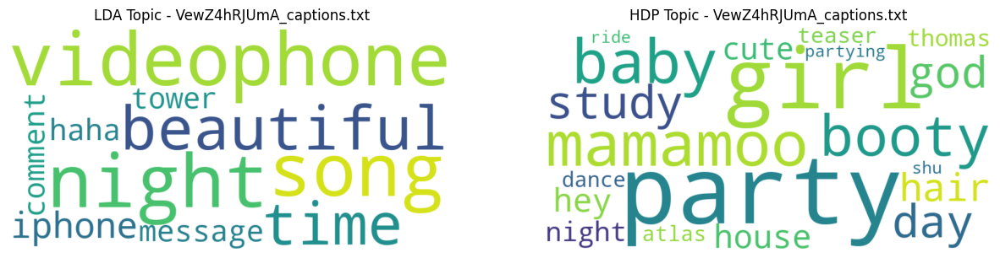

Processing file: o1QveClsSHc_captions.txt

LDA Coherence Score for o1QveClsSHc_captions.txt: 0.3762
HDP Coherence Score for o1QveClsSHc_captions.txt: 0.3082



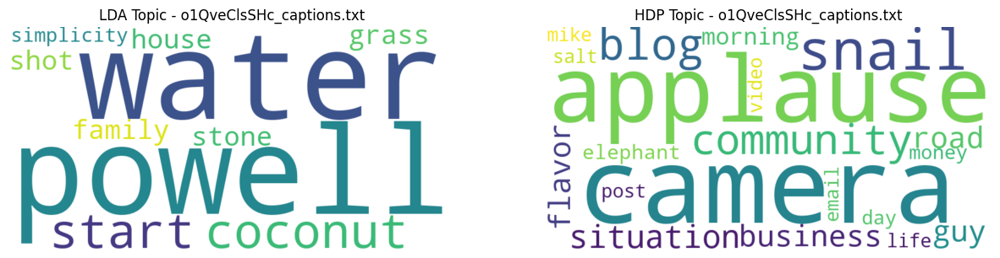

Processing file: 00cjCeXfoFE_captions.txt

LDA Coherence Score for 00cjCeXfoFE_captions.txt: 0.2972
HDP Coherence Score for 00cjCeXfoFE_captions.txt: 0.2415



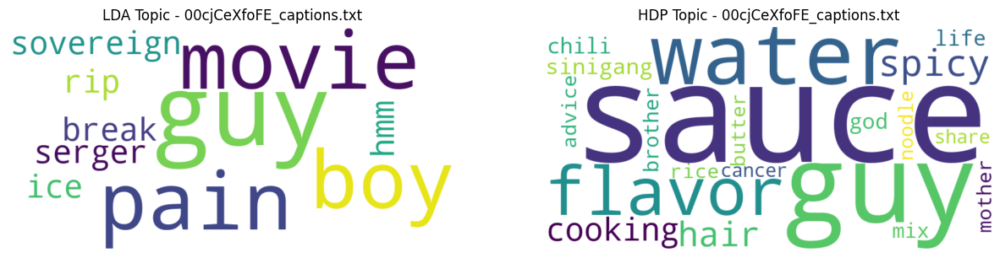

Processing file: 1SPiVRRk_Ho_captions.txt

LDA Coherence Score for 1SPiVRRk_Ho_captions.txt: 0.6732
HDP Coherence Score for 1SPiVRRk_Ho_captions.txt: 0.6549



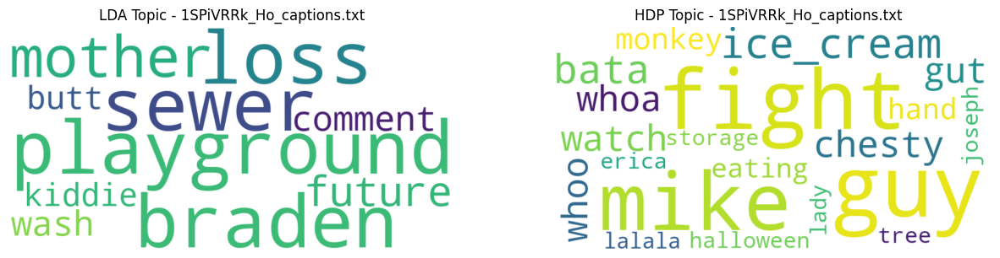

Processing file: yn01Nr8oBuA_captions.txt

LDA Coherence Score for yn01Nr8oBuA_captions.txt: 0.2806
HDP Coherence Score for yn01Nr8oBuA_captions.txt: 0.2716



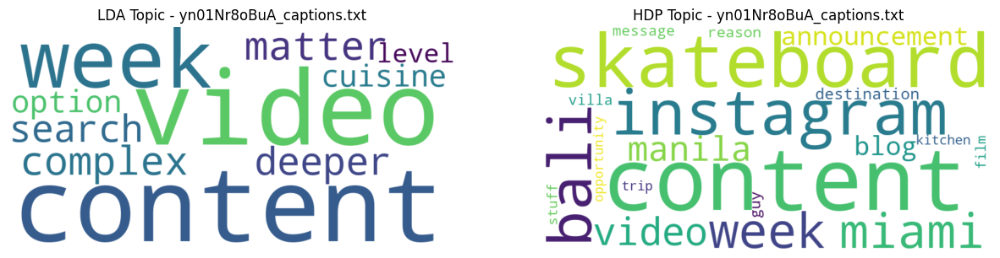

Processing file: Mg58cqXP4q4_captions.txt

LDA Coherence Score for Mg58cqXP4q4_captions.txt: 0.2512
HDP Coherence Score for Mg58cqXP4q4_captions.txt: 0.2514



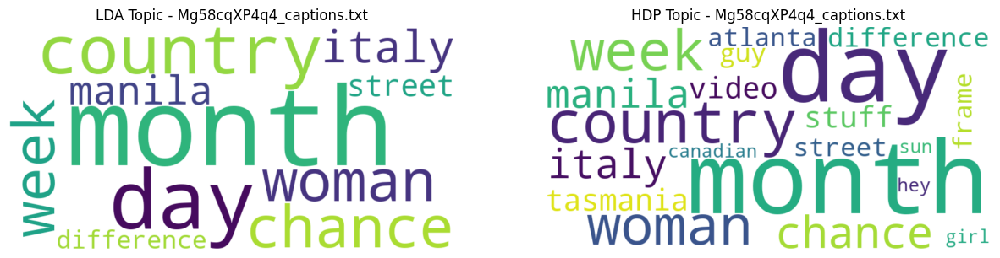

Processing file: t0wAIabbfnk_captions.txt

LDA Coherence Score for t0wAIabbfnk_captions.txt: 0.2314
HDP Coherence Score for t0wAIabbfnk_captions.txt: 0.2720



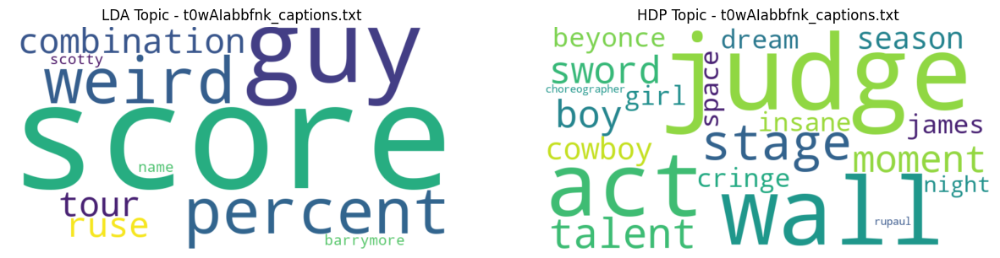

Processing file: ZEKmjwdQjBc_captions.txt

LDA Coherence Score for ZEKmjwdQjBc_captions.txt: 1.0000
HDP Coherence Score for ZEKmjwdQjBc_captions.txt: 1.0000



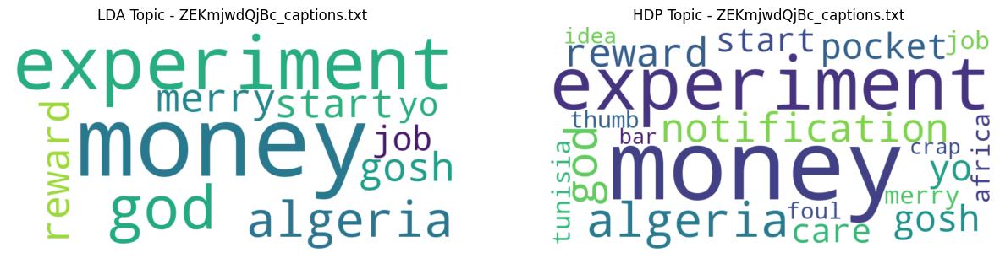

Processing file: 0xsd7DD_-zo_captions.txt

LDA Coherence Score for 0xsd7DD_-zo_captions.txt: 1.0000
HDP Coherence Score for 0xsd7DD_-zo_captions.txt: 1.0000



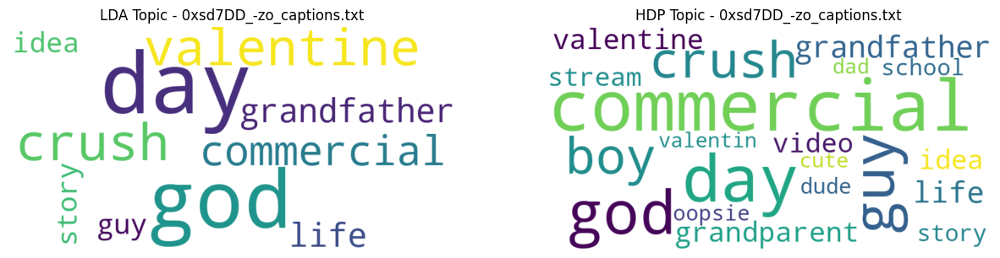

Processing file: MPY9EmLFaR0_captions.txt

LDA Coherence Score for MPY9EmLFaR0_captions.txt: 0.5012
HDP Coherence Score for MPY9EmLFaR0_captions.txt: 0.3864



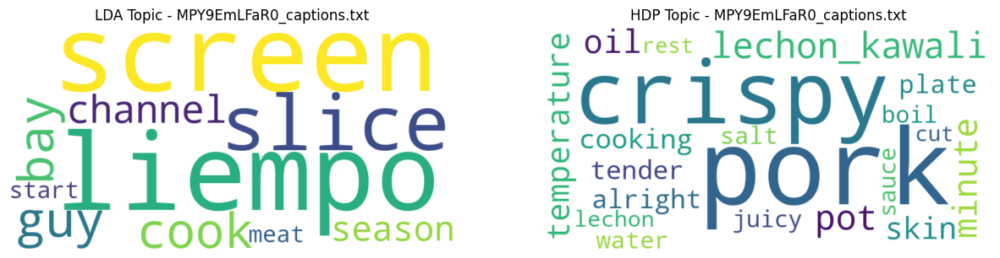

Processing file: Wtv3kgAAw5Q_captions.txt

LDA Coherence Score for Wtv3kgAAw5Q_captions.txt: 0.6731
HDP Coherence Score for Wtv3kgAAw5Q_captions.txt: 0.6827



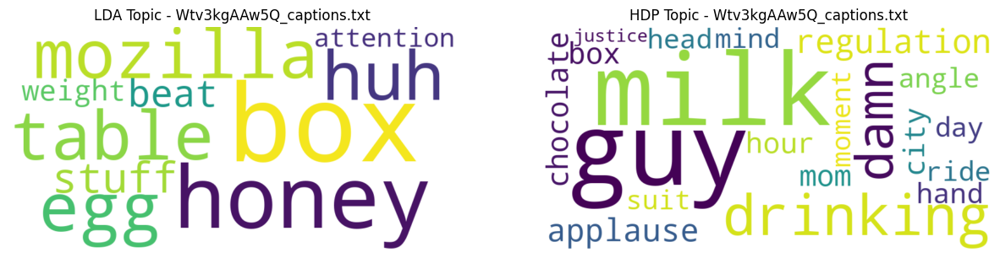

Processing file: b2TsraXmVq4_captions.txt

LDA Coherence Score for b2TsraXmVq4_captions.txt: 0.6173
HDP Coherence Score for b2TsraXmVq4_captions.txt: 0.6242



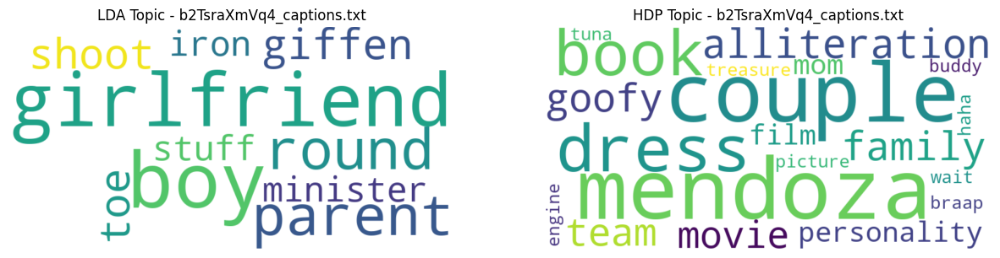

Processing file: OOcBRE4VtsA_captions.txt

LDA Coherence Score for OOcBRE4VtsA_captions.txt: 0.2836
HDP Coherence Score for OOcBRE4VtsA_captions.txt: 0.3091



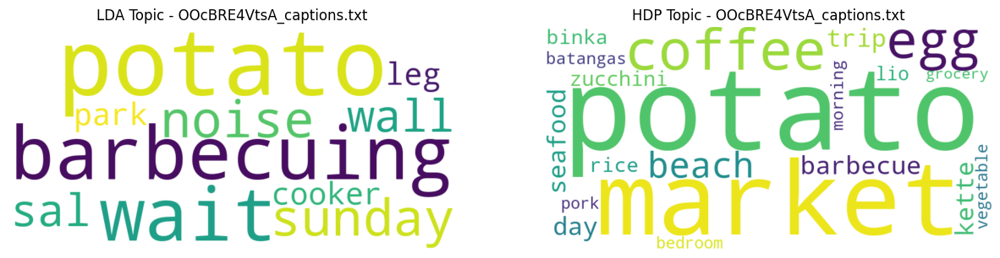

Processing file: uj0IhpcVqw8_captions.txt

LDA Coherence Score for uj0IhpcVqw8_captions.txt: 0.3161
HDP Coherence Score for uj0IhpcVqw8_captions.txt: 0.3647



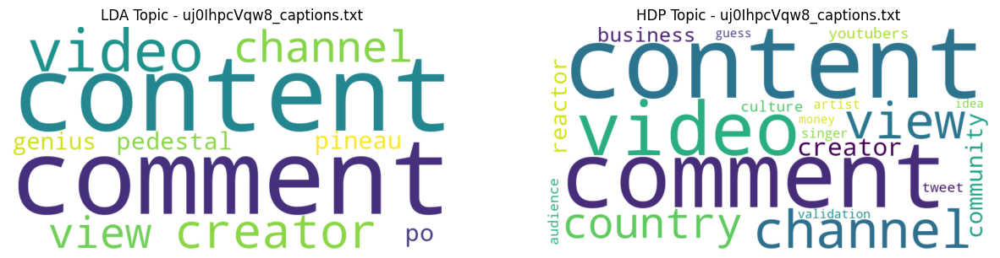

Processing file: A6JjAVj92GE_captions.txt

LDA Coherence Score for A6JjAVj92GE_captions.txt: 0.2143
HDP Coherence Score for A6JjAVj92GE_captions.txt: 0.5817



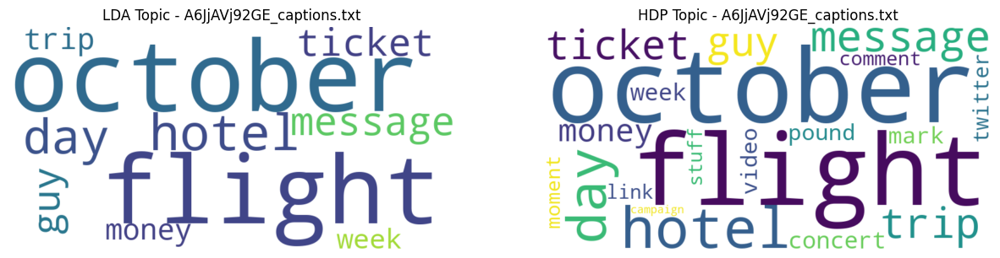

Processing file: 7UmdSTenV7I_captions.txt

LDA Coherence Score for 7UmdSTenV7I_captions.txt: 0.2655
HDP Coherence Score for 7UmdSTenV7I_captions.txt: 0.6097



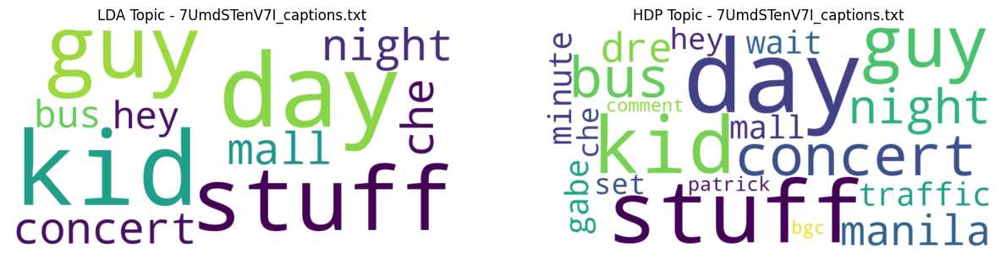

Processing file: bi__9Vzhnc4_captions.txt

LDA Coherence Score for bi__9Vzhnc4_captions.txt: 0.5423
HDP Coherence Score for bi__9Vzhnc4_captions.txt: 0.4357



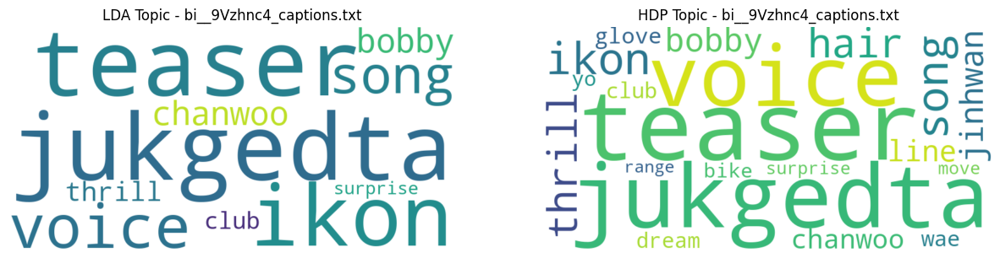

Processing file: Y4BZ9PyuoS8_captions.txt

LDA Coherence Score for Y4BZ9PyuoS8_captions.txt: 0.2606
HDP Coherence Score for Y4BZ9PyuoS8_captions.txt: 0.3567



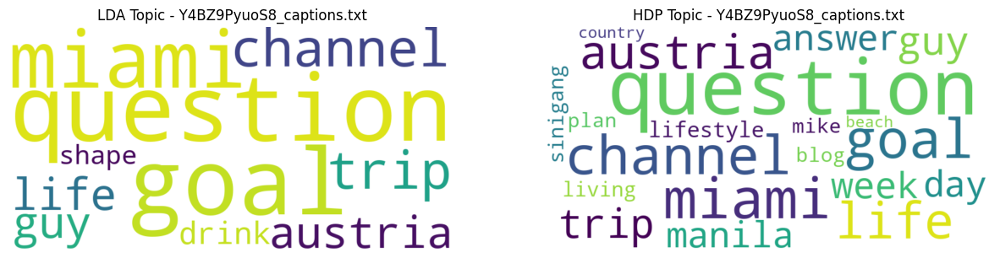

Processing file: 9lmBpGbhD4g_captions.txt

LDA Coherence Score for 9lmBpGbhD4g_captions.txt: 0.2838
HDP Coherence Score for 9lmBpGbhD4g_captions.txt: 0.2424



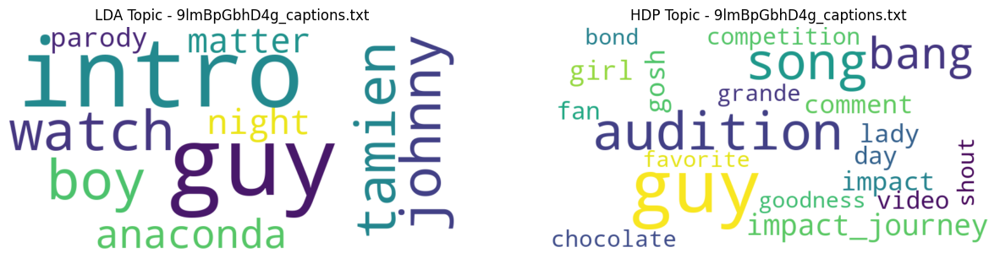

Processing file: _q1Y1ndDXBc_captions.txt

LDA Coherence Score for _q1Y1ndDXBc_captions.txt: 0.3619
HDP Coherence Score for _q1Y1ndDXBc_captions.txt: 0.2480



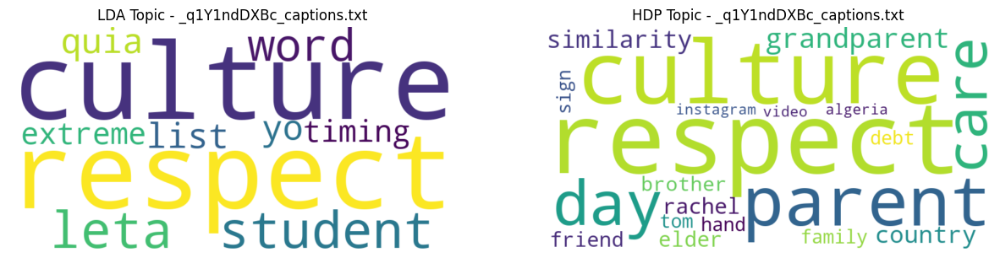

Processing file: ViCLxXvU62w_captions.txt

LDA Coherence Score for ViCLxXvU62w_captions.txt: 0.8210
HDP Coherence Score for ViCLxXvU62w_captions.txt: 0.7909



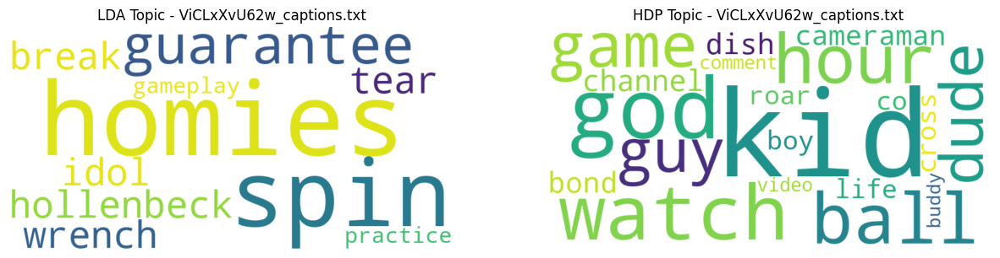

Processing file: mug2fzFkNfY_captions.txt

LDA Coherence Score for mug2fzFkNfY_captions.txt: 0.3393
HDP Coherence Score for mug2fzFkNfY_captions.txt: 0.4082



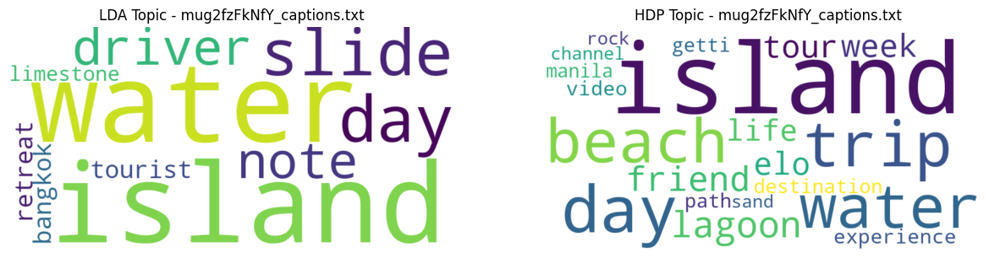

Processing file: N_XcWpa1UPM_captions.txt

LDA Coherence Score for N_XcWpa1UPM_captions.txt: 0.2855
HDP Coherence Score for N_XcWpa1UPM_captions.txt: 0.3693



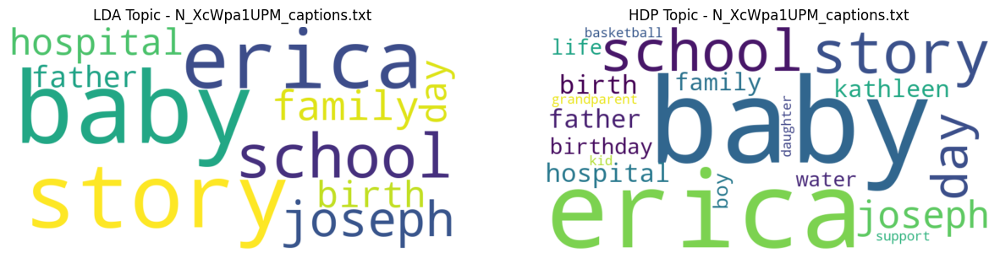

Processing file: t9Kk_obFRhI_captions.txt

LDA Coherence Score for t9Kk_obFRhI_captions.txt: 0.2362
HDP Coherence Score for t9Kk_obFRhI_captions.txt: 0.6406



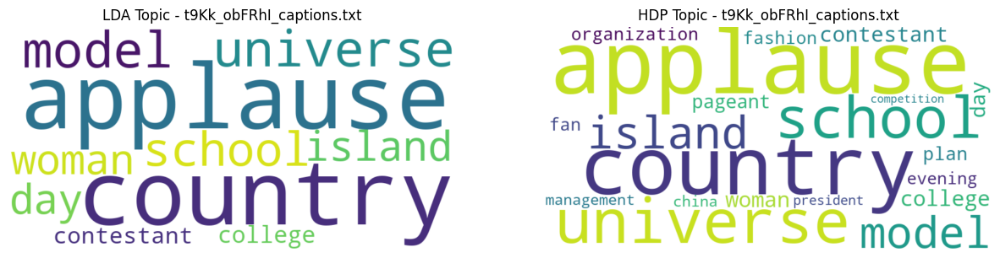

Processing file: qpNNq6QFmuM_captions.txt

LDA Coherence Score for qpNNq6QFmuM_captions.txt: 0.4571
HDP Coherence Score for qpNNq6QFmuM_captions.txt: 0.5024



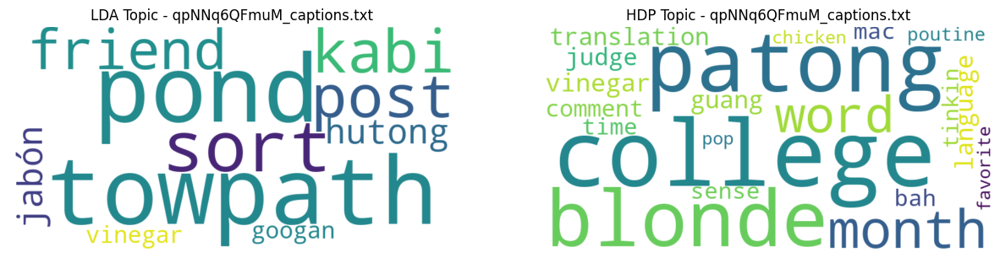

Processing file: o_5Dke3_Edc_captions.txt

LDA Coherence Score for o_5Dke3_Edc_captions.txt: 0.7062
HDP Coherence Score for o_5Dke3_Edc_captions.txt: 0.6806



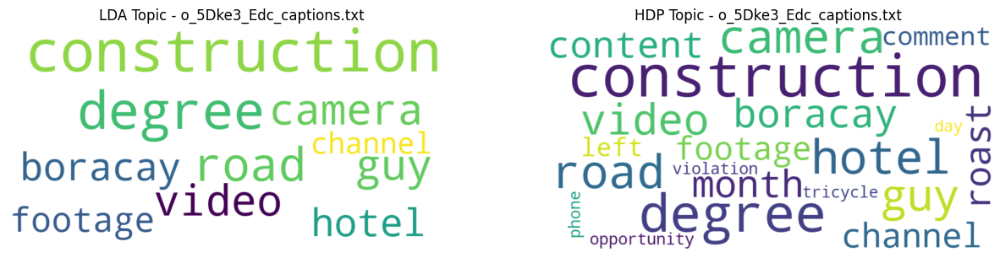

Processing file: QwEDNJWdozE_captions.txt

LDA Coherence Score for QwEDNJWdozE_captions.txt: 0.2530
HDP Coherence Score for QwEDNJWdozE_captions.txt: 0.2766



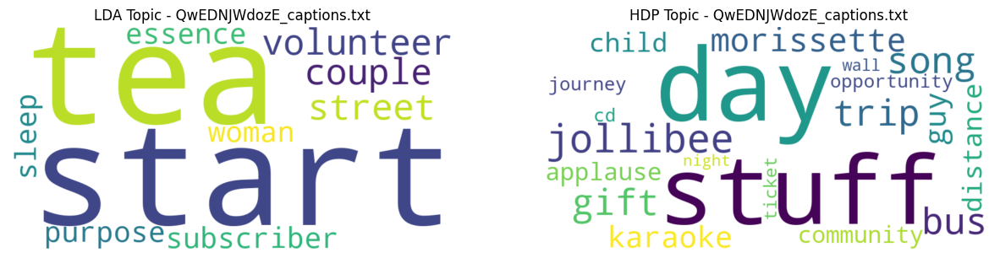

Processing file: wTlERUE8LVw_captions.txt

LDA Coherence Score for wTlERUE8LVw_captions.txt: 0.1502
HDP Coherence Score for wTlERUE8LVw_captions.txt: 0.5849



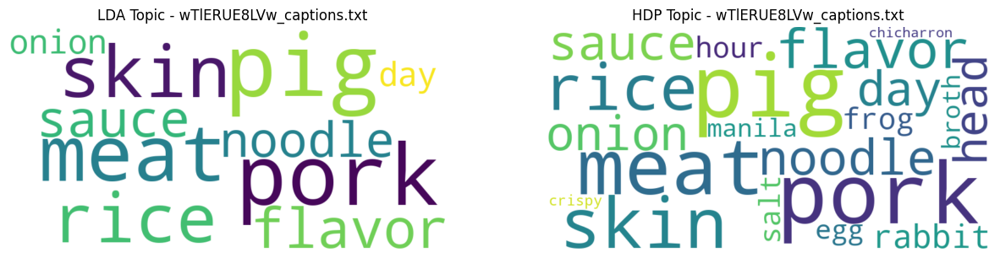

Processing file: MxCDRp4rwXg_captions.txt

LDA Coherence Score for MxCDRp4rwXg_captions.txt: 0.6587
HDP Coherence Score for MxCDRp4rwXg_captions.txt: 0.7092



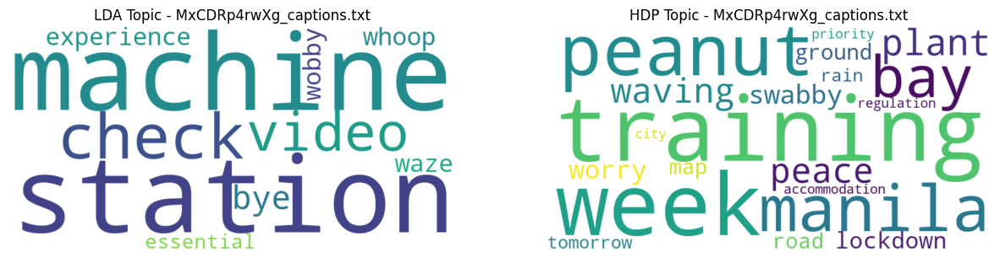

Processing file: 7Dv_TB29xwg_captions.txt

LDA Coherence Score for 7Dv_TB29xwg_captions.txt: 0.4887
HDP Coherence Score for 7Dv_TB29xwg_captions.txt: 0.3920



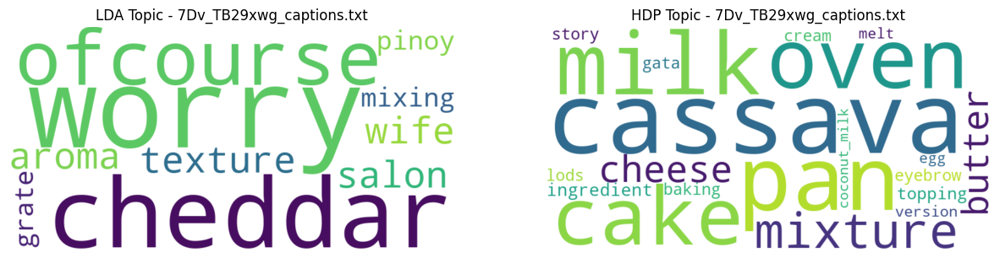

Processing file: Ar0VgO2R6EM_captions.txt

LDA Coherence Score for Ar0VgO2R6EM_captions.txt: 0.3038
HDP Coherence Score for Ar0VgO2R6EM_captions.txt: 0.4708



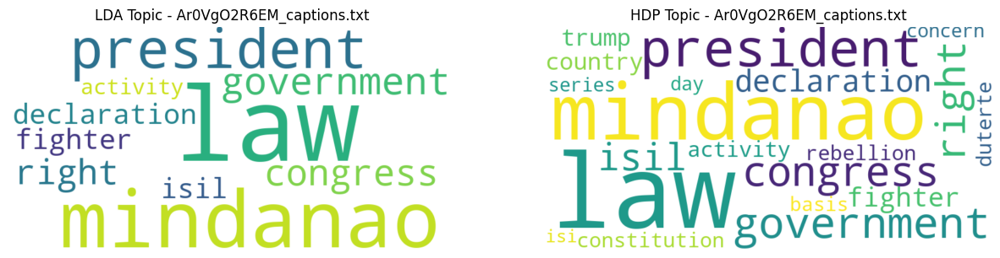

In [3]:
import os
import string
import random
import requests
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk import pos_tag
from gensim import corpora
from gensim.models.ldamodel import LdaModel
from gensim.models.hdpmodel import HdpModel
from gensim.models.phrases import Phrases, Phraser
from gensim.models.coherencemodel import CoherenceModel
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Folder paths
transcripts_folder_path = 'test-transcripts/'
tags_folder_path = 'tags/'  # Update with your tags folder path

# Read random sample of text files with at least 100 words
def load_random_documents(folder_path, sample_size=50):
    all_files = [file_name for file_name in os.listdir(folder_path) if file_name.endswith('.txt')]
    sampled_files = random.sample(all_files, min(sample_size, len(all_files)))  # Randomly sample files

    documents = []
    file_names = []
    for file_name in sampled_files:
        with open(os.path.join(folder_path, file_name), 'r', encoding='utf-8') as file:
            content = file.read().lower()  # Convert text to lowercase while reading
            if len(content.split()) >= 100:  # Only process files with at least 100 words
                documents.append(content)
                file_names.append(file_name)
    return documents, file_names

documents, file_names = load_random_documents(transcripts_folder_path)

# Load video tags
def load_video_tags(folder_path):
    video_tags = {}
    for file_name in os.listdir(folder_path):
        if file_name.endswith('.txt'):
            video_id = file_name.split('_')[0]  # Extract video ID from filename
            with open(os.path.join(folder_path, file_name), 'r', encoding='utf-8') as file:
                tags_content = file.read().lower()  # Read and convert to lowercase
                video_tags[video_id] = tags_content.split()  # Store tags as a list of words
    return video_tags

# Load video tags
video_tags = load_video_tags(tags_folder_path)

# Function to fetch stopwords from GitHub URL
def fetch_stopwords_from_github(url):
    response = requests.get(url)
    github_stopwords = response.text.splitlines()  # Split by new lines
    return set(github_stopwords)

# GitHub URL for stopwords
github_stopwords_url = 'https://raw.githubusercontent.com/stopwords-iso/stopwords-en/master/stopwords-en.txt'
github_stopwords = fetch_stopwords_from_github(github_stopwords_url)

stop_words = set(stopwords.words('english'))
custom_stop_words = ['like', 'yeah', 'know', 'um', 'uh', 'really', 'one', 'go', 'right', 'okay', 'well', 'said', 
                     'going', 'got', 'na', 'always', 'every', 'each', 'say', 'el', 'little', 'still', 
                     'best', 'dutch', 'nice', 'great', 'awesome', 'good', 'cool', 'love', 'amazing', 'wow' ]
broad_terms = ['philippines', 'philippine', 'british', 'filipino', 'video', 'http', 'korea', 'korean', 
               'youtube', 'google', 'united', 'america', 'american']
kpop_keywords = ['kpop', '필리핀', 'bts', 'blackpink', 'twice', 'exo', 'k-pop', 'seventeen', 
                 'stray kids', 'nct', 'kdrama', 'aespa', 'taehyung', 'jimin', 'jungkook']
more_keywords = [
    'breaking news', 'report', 'coverage', 'investigation', 'interview', 'documentary', 
    'journalist', 'headline', 'reporter', 'current events', 'special report', 
    'analysis', 'documented', 'broadcast', 'reporting', 'v', 'food', 'travel', 'react', 
    'reacts', 'reaction', 'foreigner', 'thing', 'visit', 'dc', 'japan', 'first', 'fast', 
    'asia', 'ang', 'indian', 'thai', 'vietnamese', 'russia', 'gon', 'canada', 'canadian', 'russian', 
    'russia', 'guy', 'lot', 'bit', 'diba', 'ola', 'cuz', 'thai', 'thailand', 'person', 'citizen', 'foreigner', 'foreign', 'foreigners',
    'facebook', 'filipinos', 'filipinas', 'vlog', 'vlogs', 'vlogging', 'hashtag', 'india', 'bro', 'dito', 'people', 'time', 'music'
]

# Add custom and broad terms
stop_words.update(custom_stop_words, broad_terms, kpop_keywords, more_keywords, github_stopwords)

# Lemmatizer
lemmatizer = WordNetLemmatizer()

# Function to filter out adjectives, other stopwords, and unwanted patterns like [Music]
def is_valid_word(word, pos):
    # Regex to match patterns like [Music], [Laughter], etc., with optional whitespace
    unwanted_pattern = re.compile(r'^\s*\[.*\]\s*$', re.IGNORECASE)
    return (
        not re.search(r'(.)\1{2,}', word) and  # Avoid repeated characters
        word not in stop_words and            # Check against stop words
        pos not in ['JJ', 'RB', 'JJR', 'JJS', 'VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ'] and  # Avoid certain POS tags
        not unwanted_pattern.match(word)      # Filter out unwanted patterns
    )

# Update preprocess_text function to include tags with increased weight
def preprocess_text_with_tags(doc, video_id, bigram_model, trigram_model, tag_weight=3):
    tokens = word_tokenize(doc.lower())
    tokens_with_pos = pos_tag(tokens)
    tokens = [lemmatizer.lemmatize(word) for word, pos in tokens_with_pos if word.isalpha() and is_valid_word(word, pos)]
    
    # Include video tags for the specific video ID with increased weight
    if video_id in video_tags:
        tags = video_tags[video_id]
        # Add tags multiple times to increase their weight
        tokens += tags * tag_weight  # Repeat tags based on the weight specified
    
    tokens = bigram_model[tokens]
    tokens = trigram_model[tokens]
    return tokens

# Prepare the bigram and trigram models
all_tokens = [word_tokenize(doc.lower()) for doc in documents]
bigram_model = Phrases(all_tokens, min_count=5, threshold=100)  # Higher threshold means fewer phrases
trigram_model = Phrases(bigram_model[all_tokens], threshold=100)

# Convert the bigram and trigram models into efficient Phrasers
bigram_model = Phraser(bigram_model)
trigram_model = Phraser(trigram_model)

## Function to train LDA
def train_lda(preprocessed_doc):
    # Create dictionary and corpus for each document
    dictionary = corpora.Dictionary([preprocessed_doc])
    corpus = [dictionary.doc2bow(preprocessed_doc)]

    # Train LDA model for the individual document
    lda_model = LdaModel(corpus, num_topics=3, id2word=dictionary, passes=50, random_state=42)

    # Calculate coherence score
    coherence_model = CoherenceModel(model=lda_model, texts=[preprocessed_doc], dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model.get_coherence()
    return lda_model, coherence_score

## Function to train HDP
def train_hdp(preprocessed_doc):
    # Create dictionary and corpus for each document
    dictionary = corpora.Dictionary([preprocessed_doc])
    corpus = [dictionary.doc2bow(preprocessed_doc)]

    # Train HDP model for the individual document
    hdp_model = HdpModel(corpus, dictionary, update_every=1, passes=50)

    # Calculate coherence score
    coherence_model = CoherenceModel(model=hdp_model, texts=[preprocessed_doc], dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model.get_coherence()
    return hdp_model, coherence_score

## Process each document for comparison
for i, doc in enumerate(documents):
    video_id = file_names[i].split('_captions')[0]  # Extract video ID including underscores before 'captions'
    print(f"Processing file: {file_names[i]}")

    preprocessed_doc = preprocess_text_with_tags(doc, video_id, bigram_model, trigram_model, tag_weight=3)
    
    if len(preprocessed_doc) > 0:
        # Train LDA
        lda_model, lda_coherence = train_lda(preprocessed_doc)
        
        # Train HDP
        hdp_model, hdp_coherence = train_hdp(preprocessed_doc)
        
        # Print results
        print(f"\nLDA Coherence Score for {file_names[i]}: {lda_coherence:.4f}")
        print(f"HDP Coherence Score for {file_names[i]}: {hdp_coherence:.4f}\n")
        
        # Optionally display WordClouds for each model's topics
        wordcloud_lda = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(dict(lda_model.show_topic(0)))
        wordcloud_hdp = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(dict(hdp_model.show_topic(0)))

        plt.figure(figsize=(15, 8))
        plt.subplot(1, 2, 1)
        plt.imshow(wordcloud_lda, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"LDA Topic - {file_names[i]}")
        
        plt.subplot(1, 2, 2)
        plt.imshow(wordcloud_hdp, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"HDP Topic - {file_names[i]}")
        
        plt.show()


# Hierarchical Dirichlet Process only 

Processing file: uC8iNb9PXnA_captions.txt
HDP Coherence Score for uC8iNb9PXnA_captions.txt: 0.3420



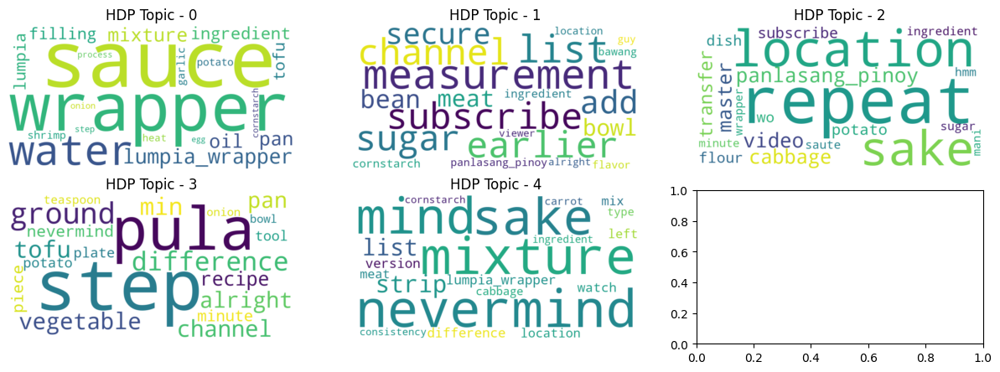

Processing file: 4Ekd1OGwPyE_captions.txt
HDP Coherence Score for 4Ekd1OGwPyE_captions.txt: 0.3339



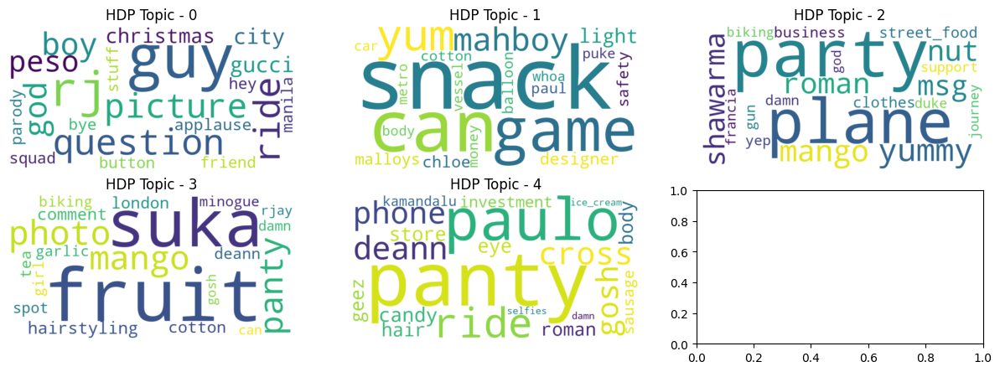

Processing file: L--a9N9OqnA_captions.txt
HDP Coherence Score for L--a9N9OqnA_captions.txt: 0.2793



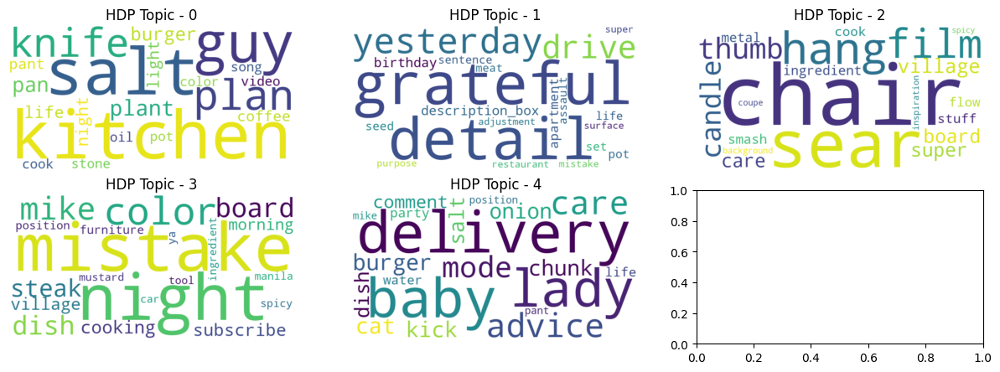

Processing file: 5StlXqODnXY_captions.txt
HDP Coherence Score for 5StlXqODnXY_captions.txt: 0.2477



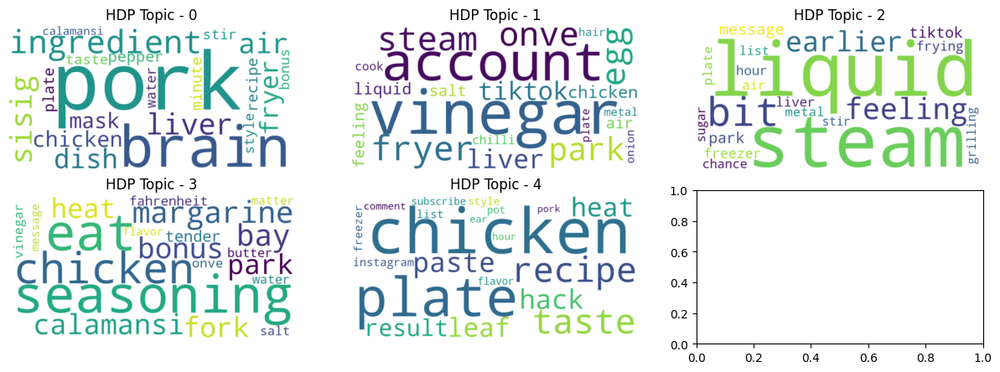

Processing file: 9hWiKgR22YQ_captions.txt
HDP Coherence Score for 9hWiKgR22YQ_captions.txt: 0.7865



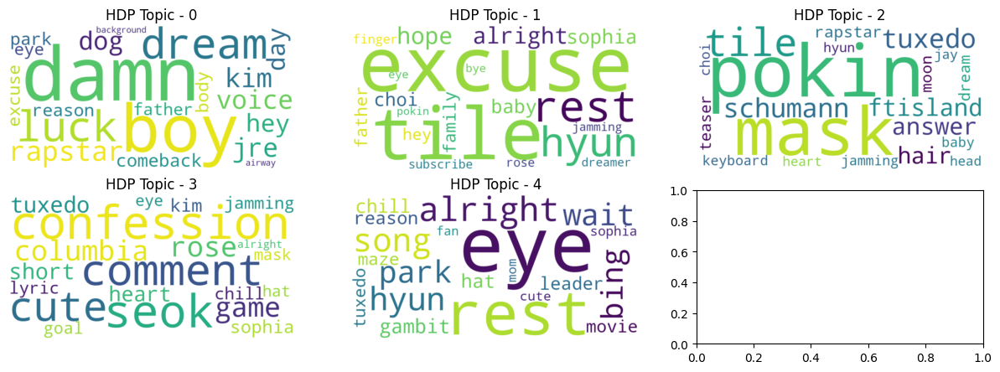

Processing file: mhdQUSXitLU_captions.txt
HDP Coherence Score for mhdQUSXitLU_captions.txt: 0.2334



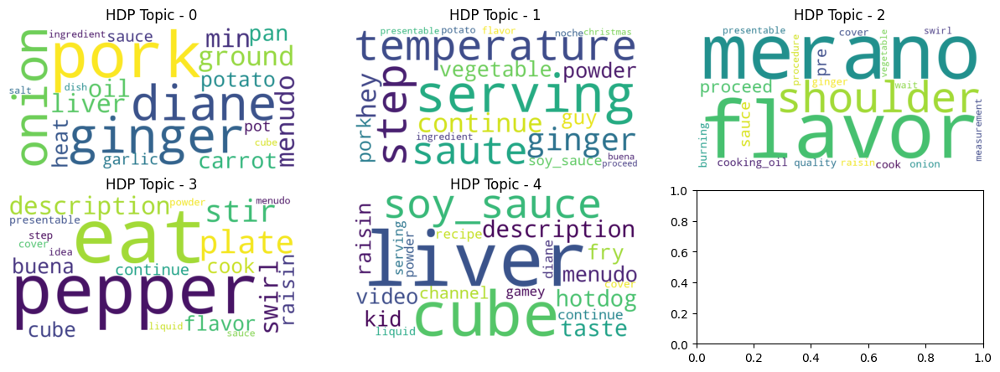

Processing file: S0V6aemmdaY_captions.txt
HDP Coherence Score for S0V6aemmdaY_captions.txt: 1.0000



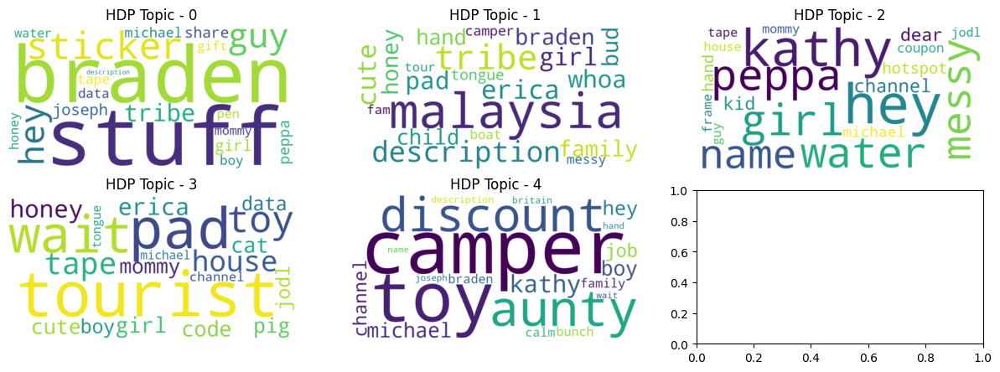

Processing file: CmlXldfVwh8_captions.txt
HDP Coherence Score for CmlXldfVwh8_captions.txt: 0.3744



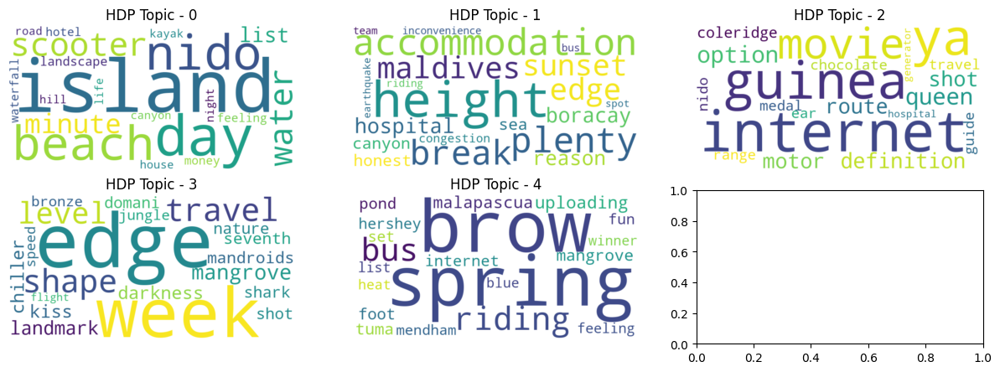

Processing file: 1wXQDBV0nPA_captions.txt
HDP Coherence Score for 1wXQDBV0nPA_captions.txt: 0.7451



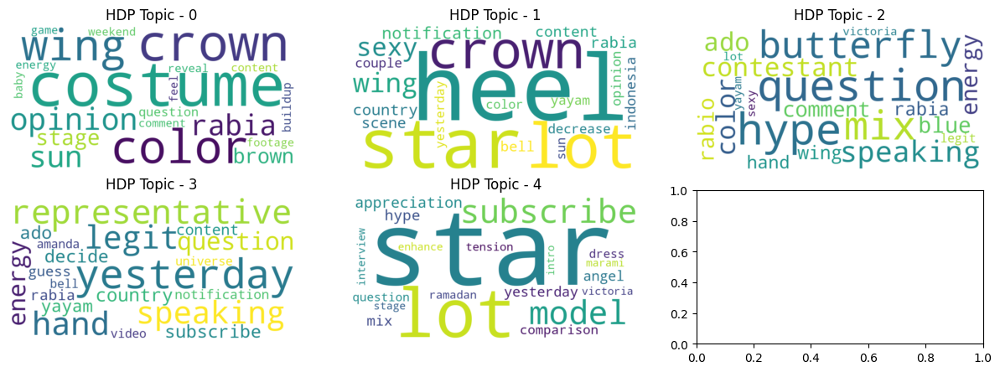

Processing file: WRhCPVU3rOE_captions.txt
HDP Coherence Score for WRhCPVU3rOE_captions.txt: 0.5734



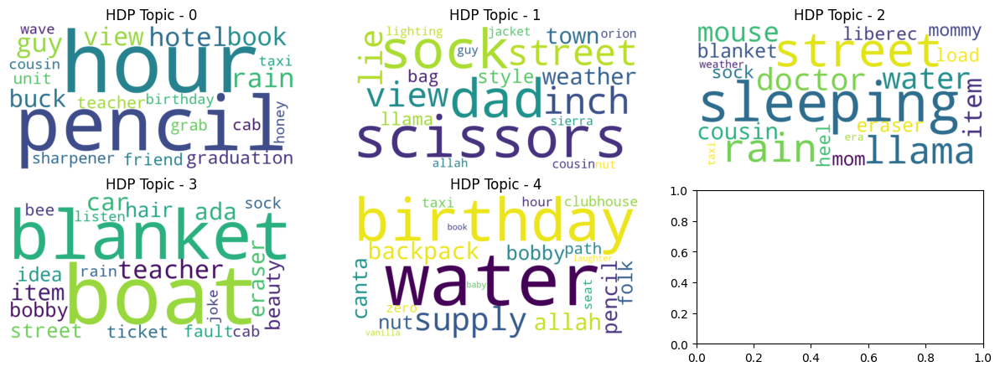

Processing file: kEPd2dQA9ZY_captions.txt
HDP Coherence Score for kEPd2dQA9ZY_captions.txt: 0.5300



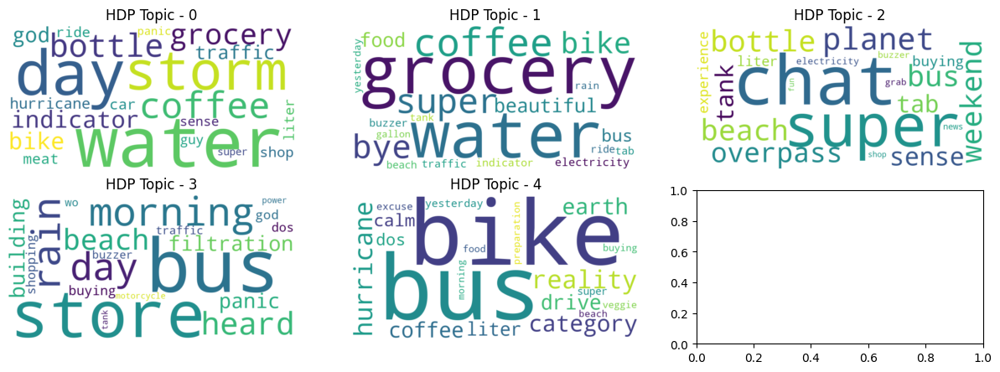

Processing file: 6taB-8ijhSg_captions.txt
HDP Coherence Score for 6taB-8ijhSg_captions.txt: 0.3612



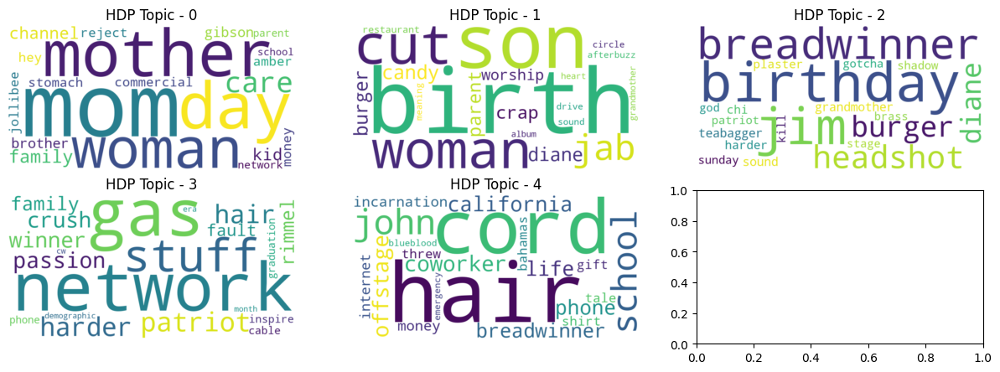

Processing file: VngoWfLpQDo_captions.txt
HDP Coherence Score for VngoWfLpQDo_captions.txt: 0.6031



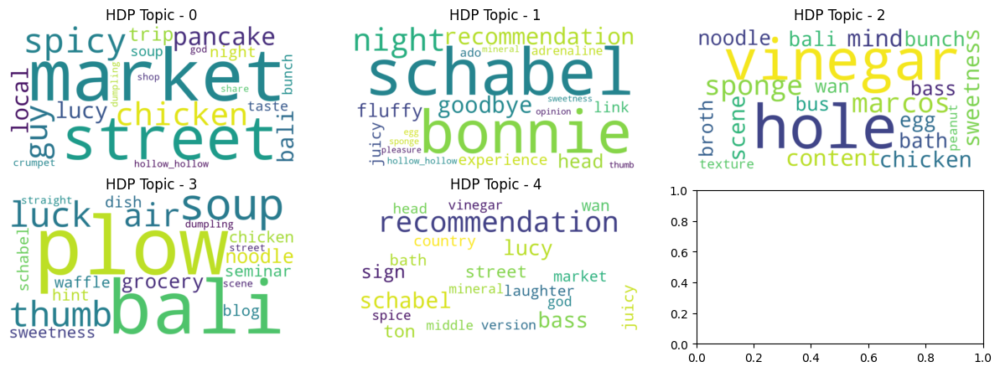

Processing file: lw0W4iSHbaw_captions.txt
HDP Coherence Score for lw0W4iSHbaw_captions.txt: 0.5388



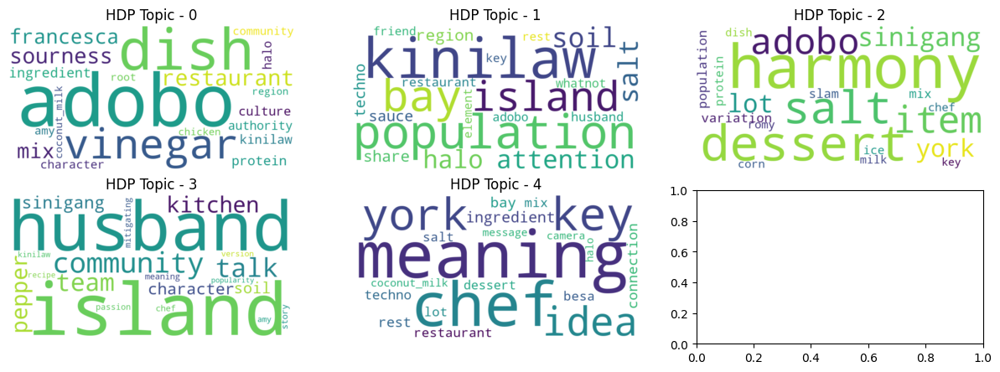

Processing file: 6duXJoSwYFY_captions.txt
HDP Coherence Score for 6duXJoSwYFY_captions.txt: 0.6545



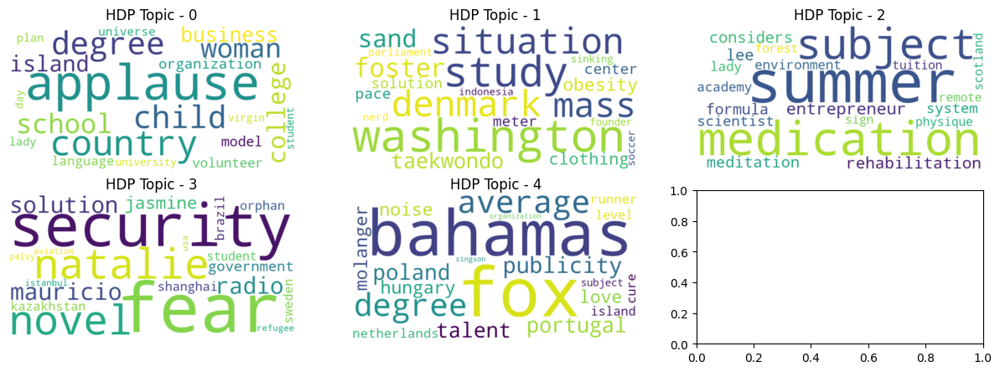

Processing file: cYWfsTwTHN8_captions.txt
HDP Coherence Score for cYWfsTwTHN8_captions.txt: 0.3686



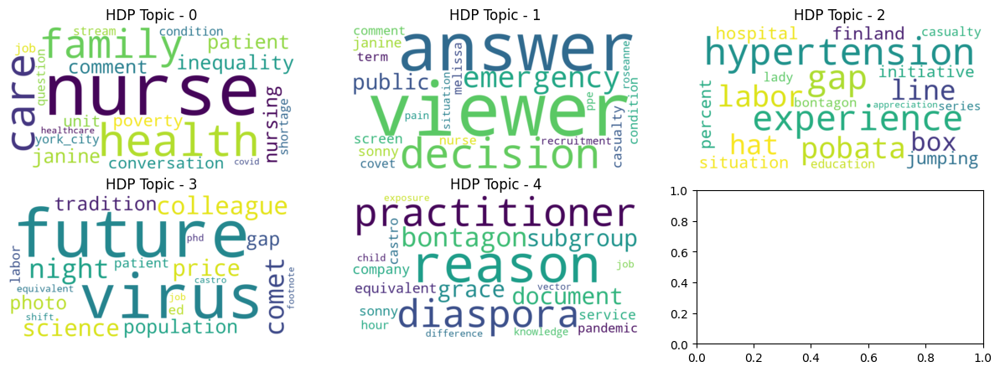

Processing file: UMX1U34ISaU_captions.txt
HDP Coherence Score for UMX1U34ISaU_captions.txt: 0.6489



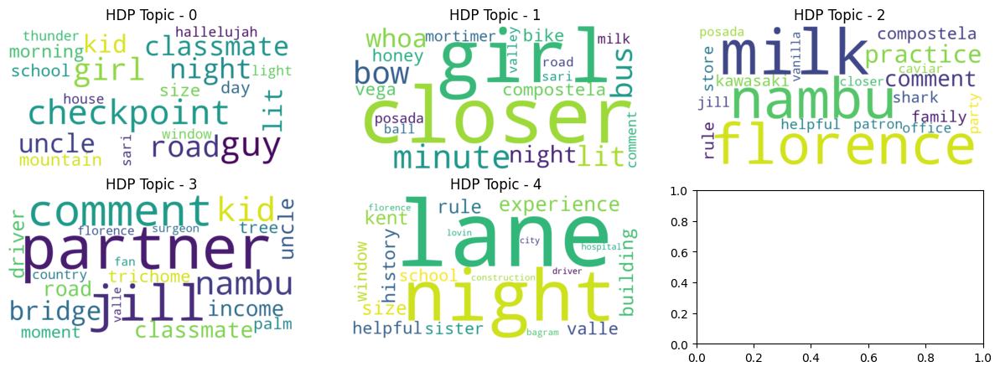

Processing file: 4DoAEVIEu_s_captions.txt
HDP Coherence Score for 4DoAEVIEu_s_captions.txt: 0.3141



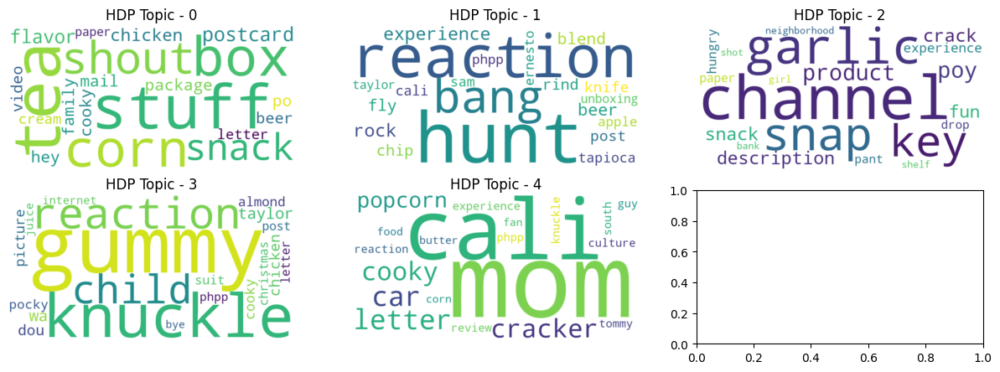

Processing file: eV66hRLAl8A_captions.txt
HDP Coherence Score for eV66hRLAl8A_captions.txt: 0.6379



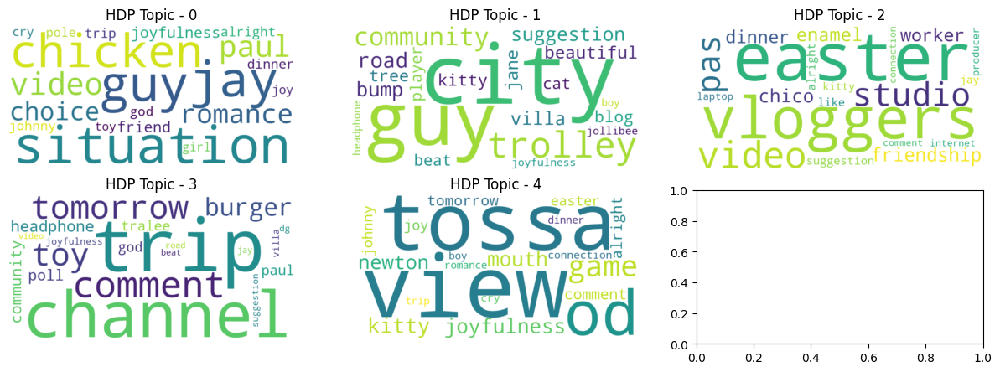

Processing file: VewZ4hRJUmA_captions.txt
HDP Coherence Score for VewZ4hRJUmA_captions.txt: 0.6139



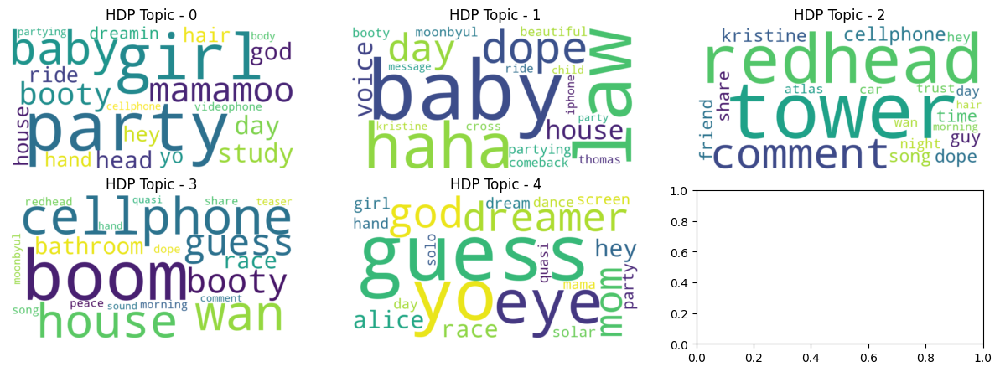

Processing file: o1QveClsSHc_captions.txt
HDP Coherence Score for o1QveClsSHc_captions.txt: 0.3068



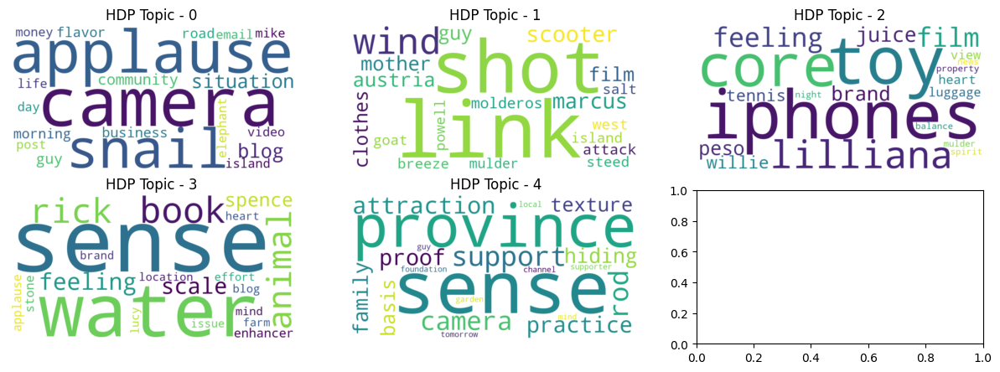

Processing file: 00cjCeXfoFE_captions.txt
HDP Coherence Score for 00cjCeXfoFE_captions.txt: 0.2437



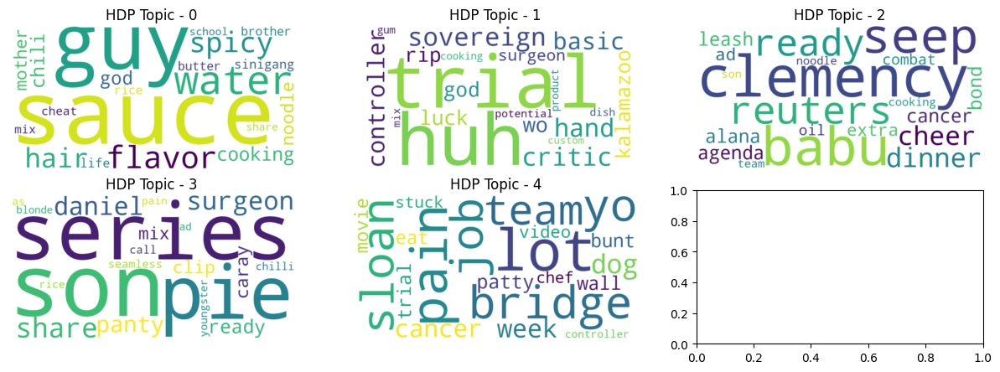

Processing file: 1SPiVRRk_Ho_captions.txt
HDP Coherence Score for 1SPiVRRk_Ho_captions.txt: 0.6400



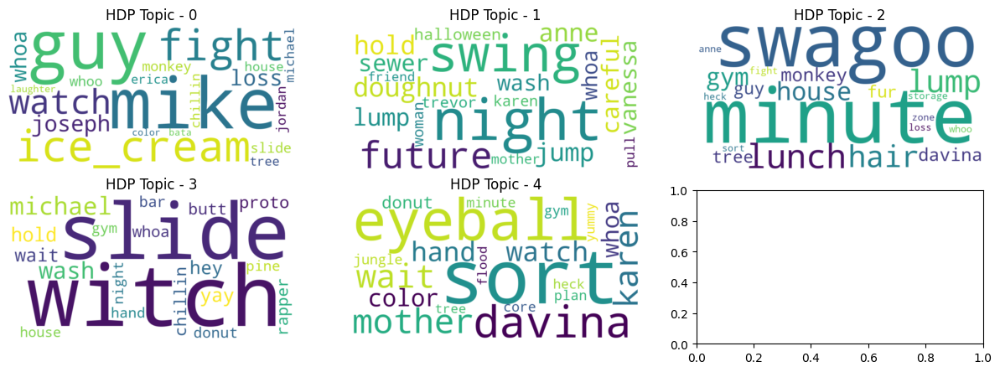

Processing file: yn01Nr8oBuA_captions.txt
HDP Coherence Score for yn01Nr8oBuA_captions.txt: 0.2748



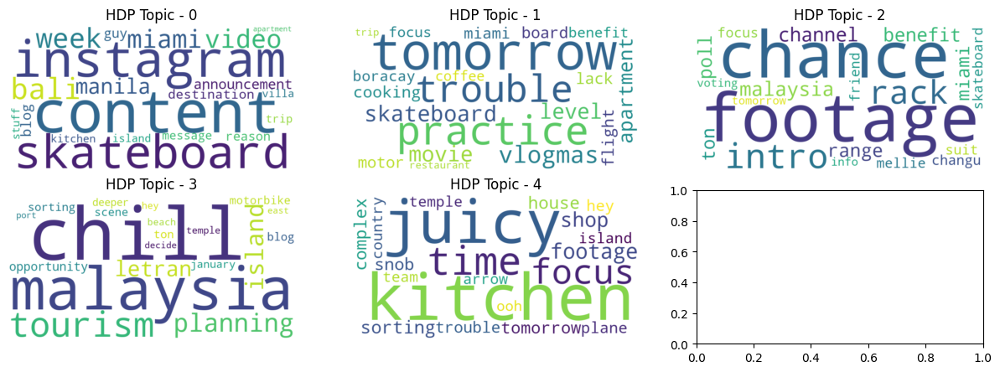

Processing file: Mg58cqXP4q4_captions.txt
HDP Coherence Score for Mg58cqXP4q4_captions.txt: 0.2585



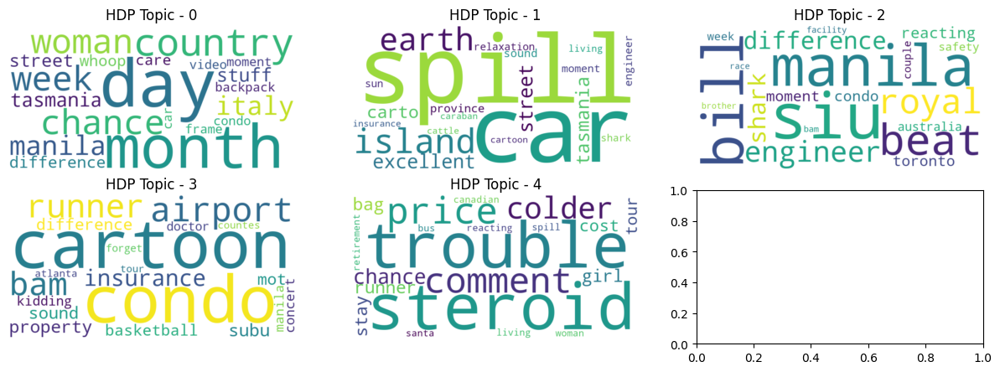

Processing file: t0wAIabbfnk_captions.txt
HDP Coherence Score for t0wAIabbfnk_captions.txt: 0.2644



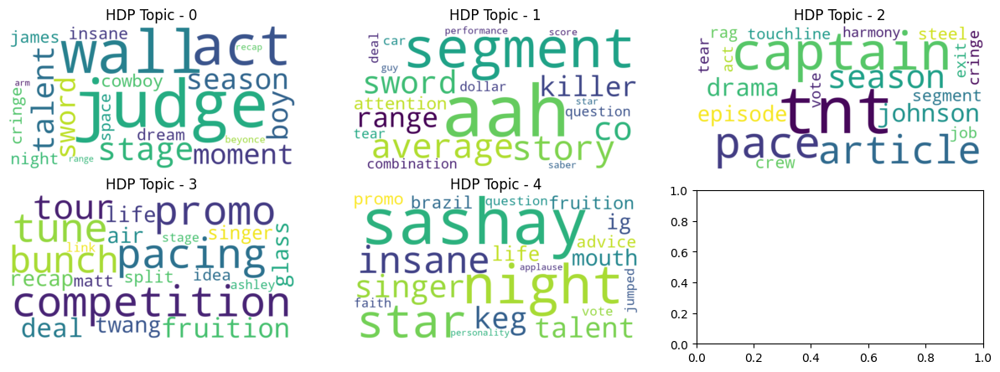

Processing file: ZEKmjwdQjBc_captions.txt
HDP Coherence Score for ZEKmjwdQjBc_captions.txt: 1.0000



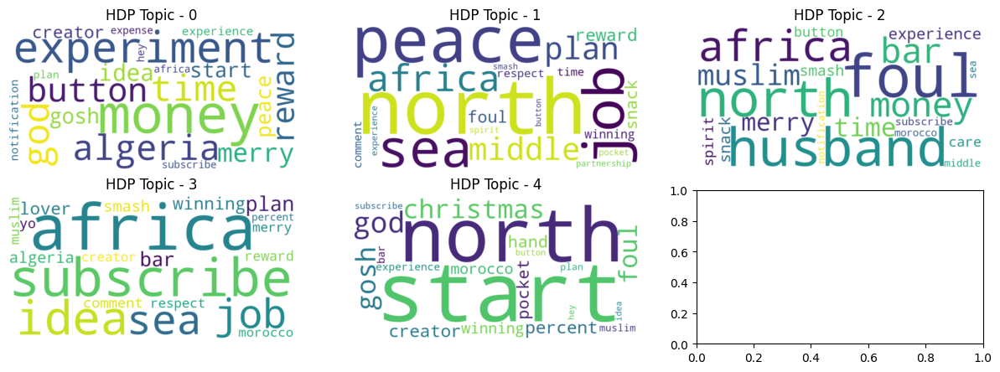

Processing file: 0xsd7DD_-zo_captions.txt
HDP Coherence Score for 0xsd7DD_-zo_captions.txt: 1.0000



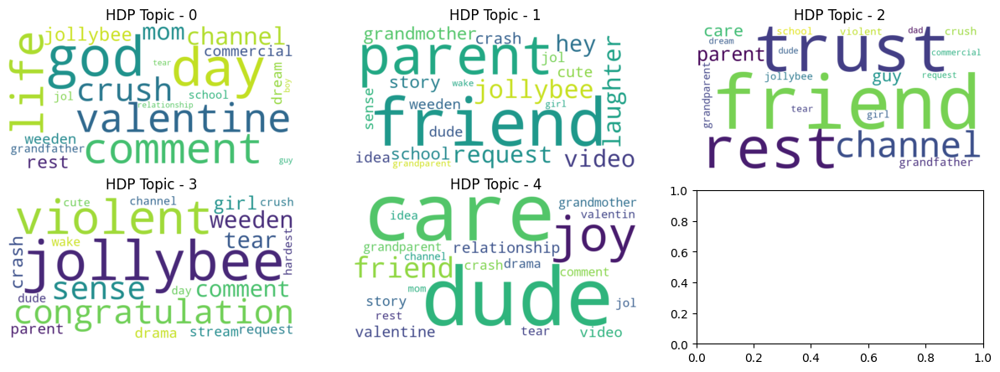

Processing file: MPY9EmLFaR0_captions.txt
HDP Coherence Score for MPY9EmLFaR0_captions.txt: 0.3992



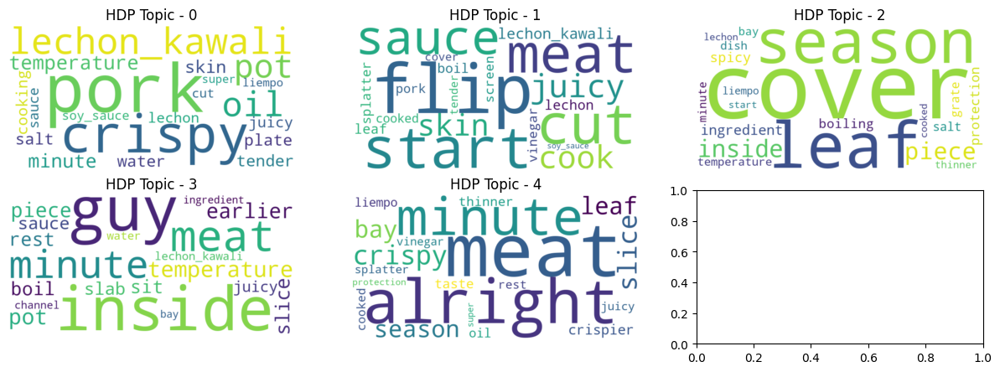

Processing file: Wtv3kgAAw5Q_captions.txt
HDP Coherence Score for Wtv3kgAAw5Q_captions.txt: 0.6837



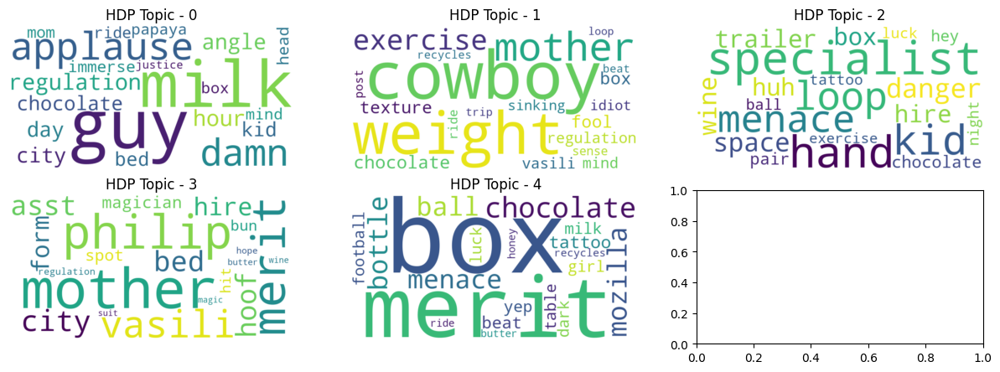

Processing file: b2TsraXmVq4_captions.txt
HDP Coherence Score for b2TsraXmVq4_captions.txt: 0.6177



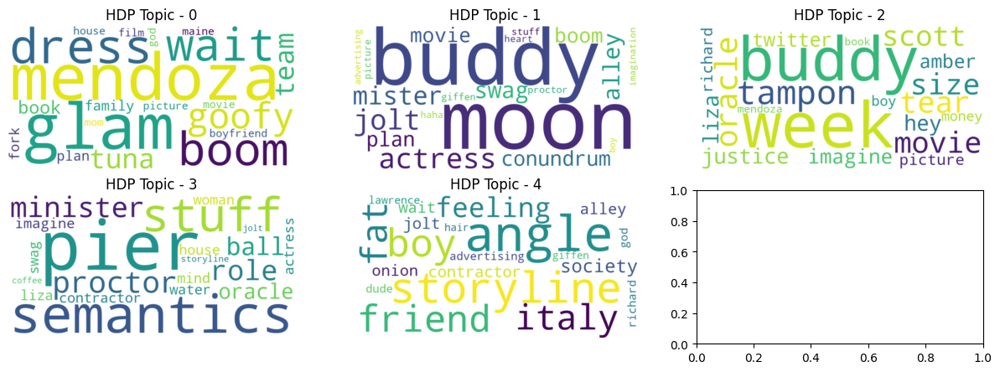

Processing file: OOcBRE4VtsA_captions.txt
HDP Coherence Score for OOcBRE4VtsA_captions.txt: 0.3054



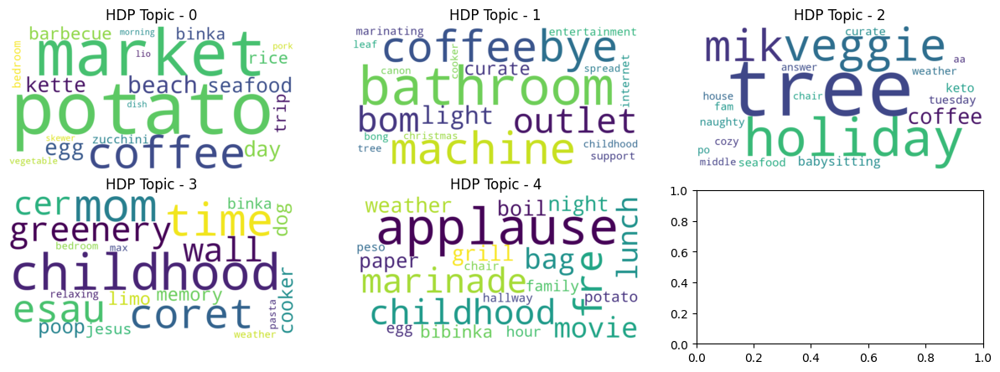

Processing file: uj0IhpcVqw8_captions.txt
HDP Coherence Score for uj0IhpcVqw8_captions.txt: 0.3585



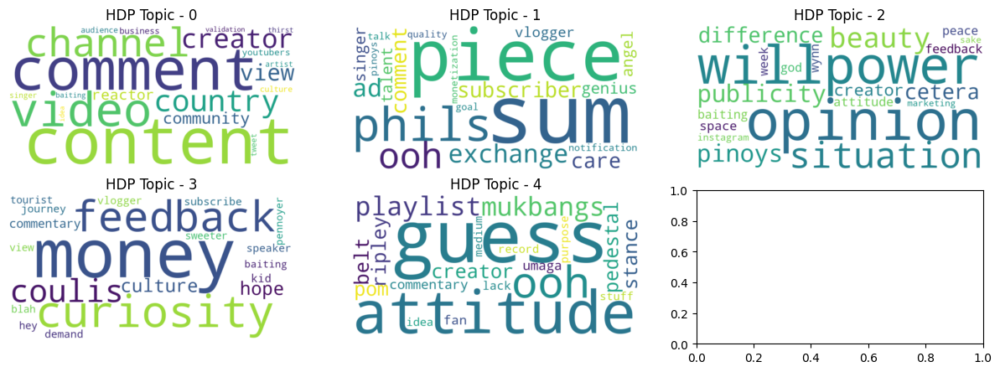

Processing file: A6JjAVj92GE_captions.txt
HDP Coherence Score for A6JjAVj92GE_captions.txt: 0.5757



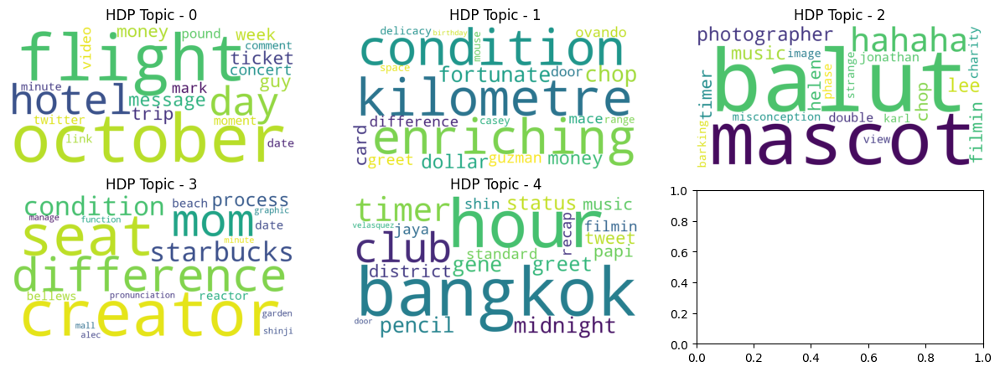

Processing file: 7UmdSTenV7I_captions.txt
HDP Coherence Score for 7UmdSTenV7I_captions.txt: 0.6134



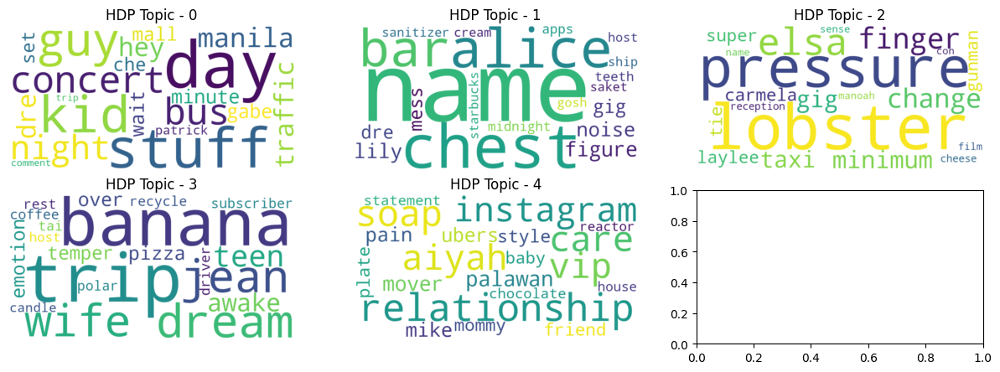

Processing file: bi__9Vzhnc4_captions.txt
HDP Coherence Score for bi__9Vzhnc4_captions.txt: 0.4256



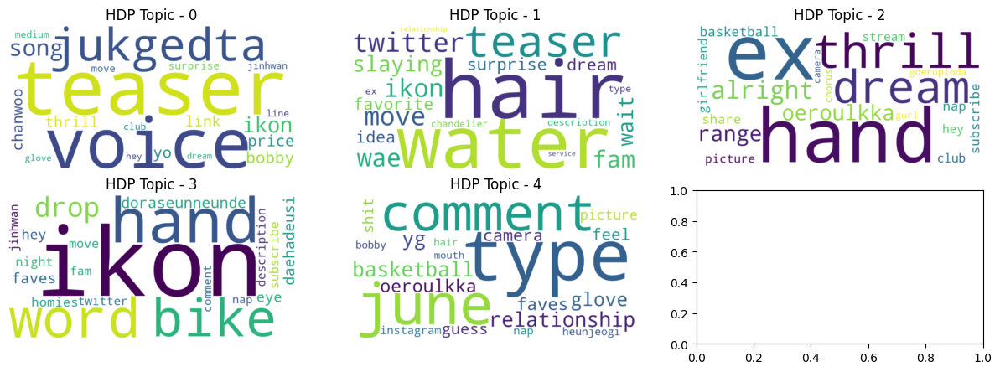

Processing file: Y4BZ9PyuoS8_captions.txt
HDP Coherence Score for Y4BZ9PyuoS8_captions.txt: 0.3593



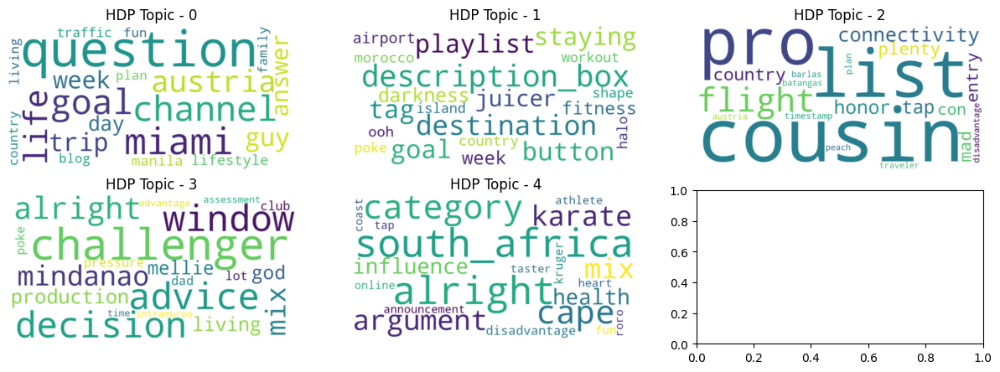

Processing file: 9lmBpGbhD4g_captions.txt
HDP Coherence Score for 9lmBpGbhD4g_captions.txt: 0.2491



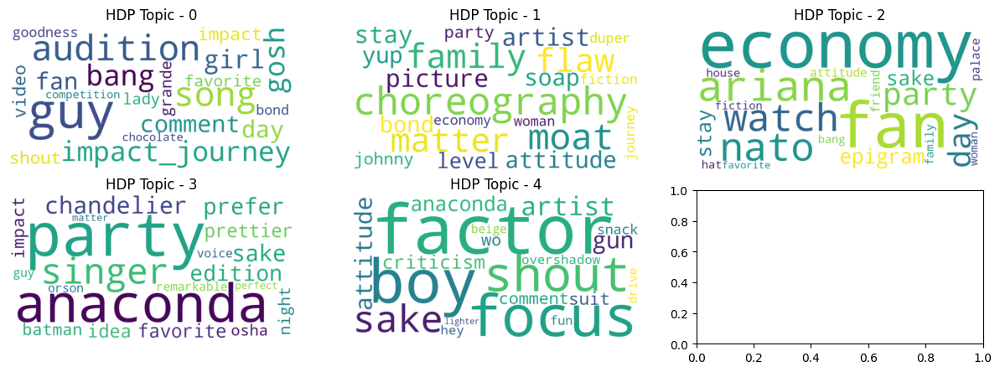

Processing file: _q1Y1ndDXBc_captions.txt
HDP Coherence Score for _q1Y1ndDXBc_captions.txt: 0.2504



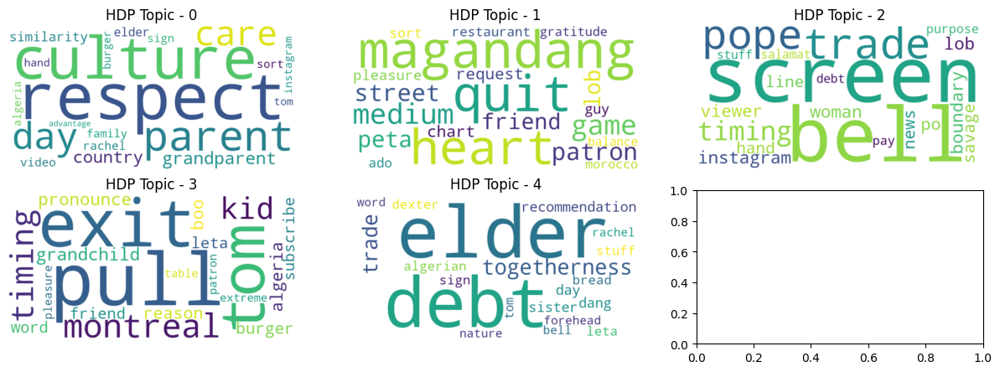

Processing file: ViCLxXvU62w_captions.txt
HDP Coherence Score for ViCLxXvU62w_captions.txt: 0.7826



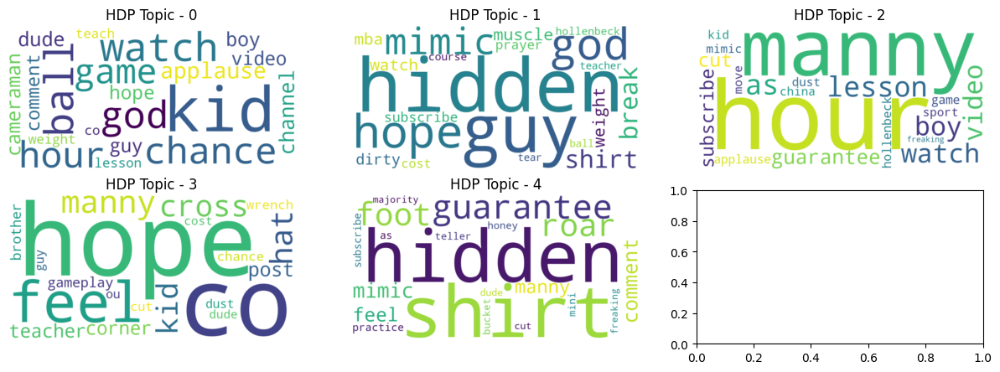

Processing file: mug2fzFkNfY_captions.txt
HDP Coherence Score for mug2fzFkNfY_captions.txt: 0.4108



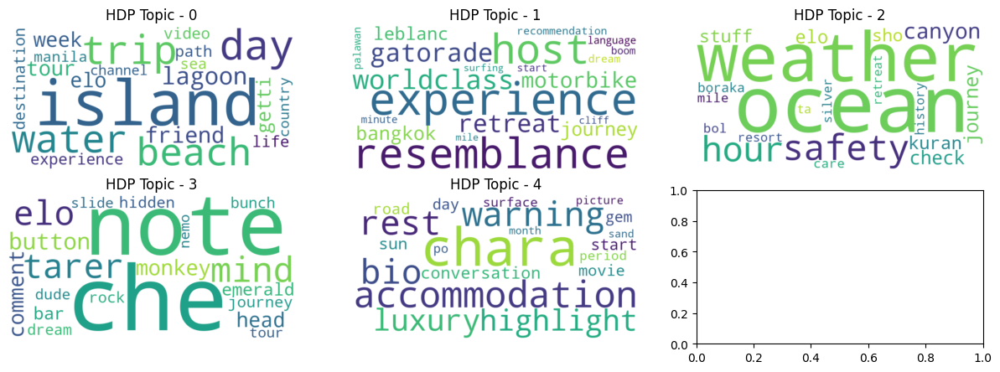

Processing file: N_XcWpa1UPM_captions.txt
HDP Coherence Score for N_XcWpa1UPM_captions.txt: 0.3647



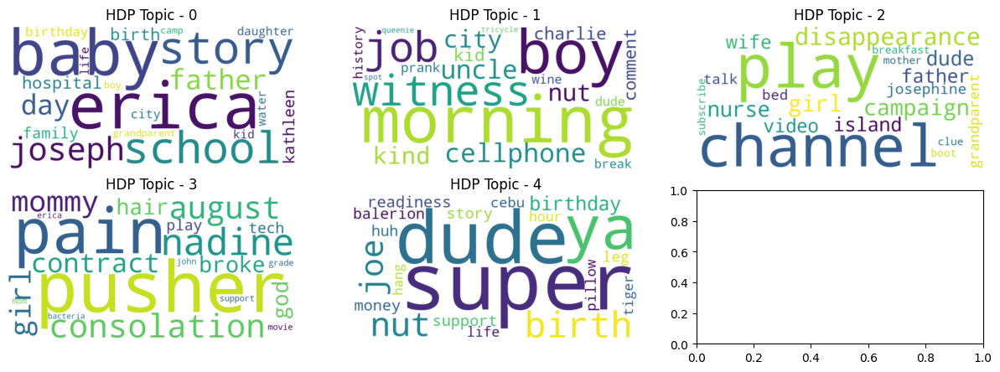

Processing file: t9Kk_obFRhI_captions.txt
HDP Coherence Score for t9Kk_obFRhI_captions.txt: 0.6340



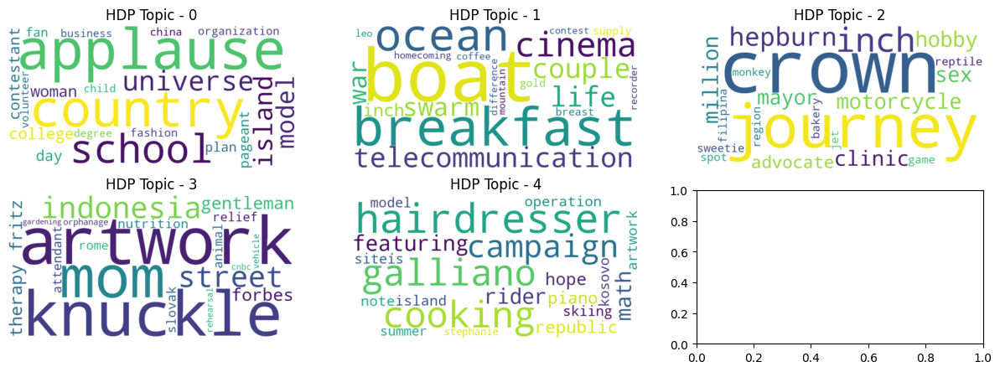

Processing file: qpNNq6QFmuM_captions.txt
HDP Coherence Score for qpNNq6QFmuM_captions.txt: 0.4984



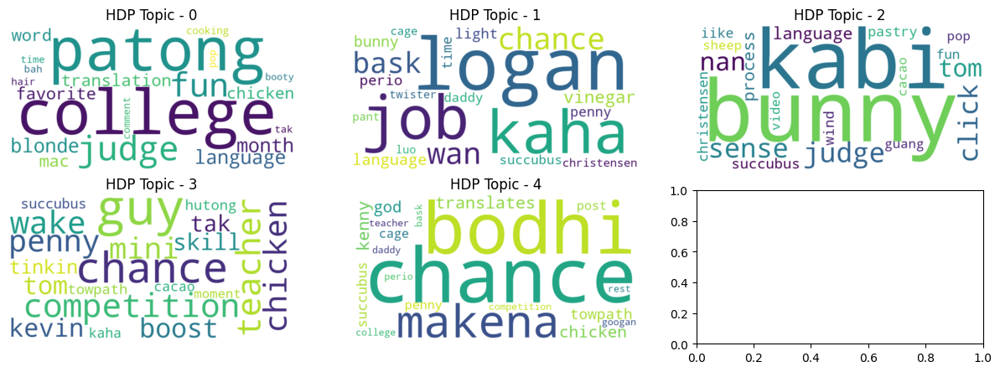

Processing file: o_5Dke3_Edc_captions.txt
HDP Coherence Score for o_5Dke3_Edc_captions.txt: 0.6786



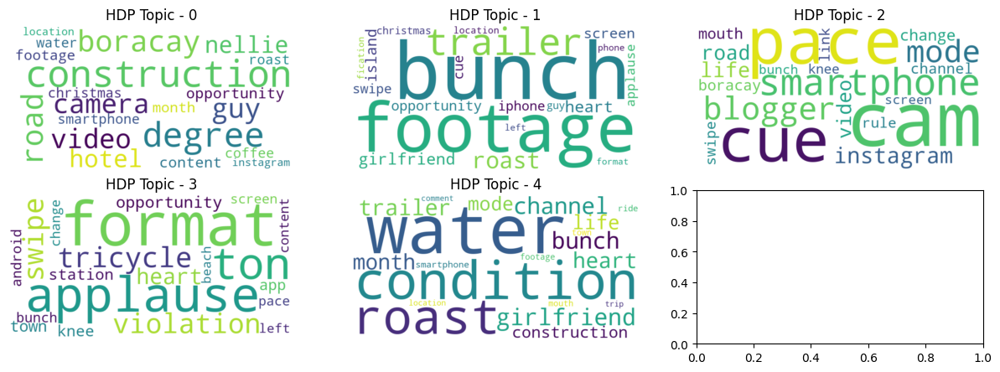

Processing file: QwEDNJWdozE_captions.txt
HDP Coherence Score for QwEDNJWdozE_captions.txt: 0.2745



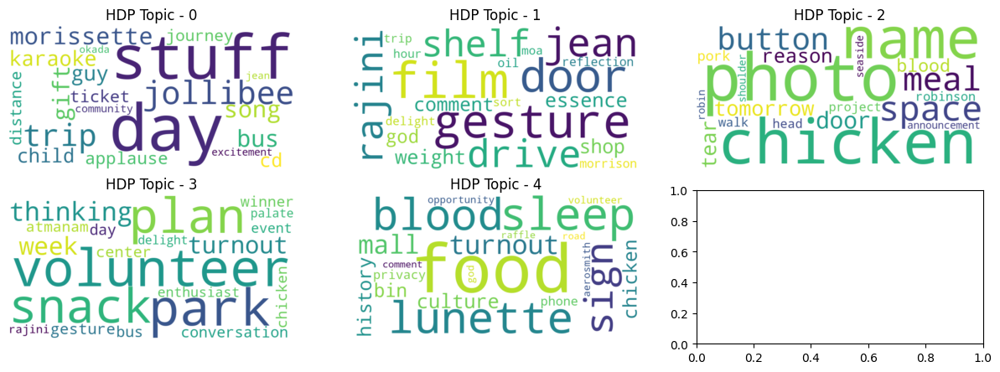

Processing file: wTlERUE8LVw_captions.txt
HDP Coherence Score for wTlERUE8LVw_captions.txt: 0.5919



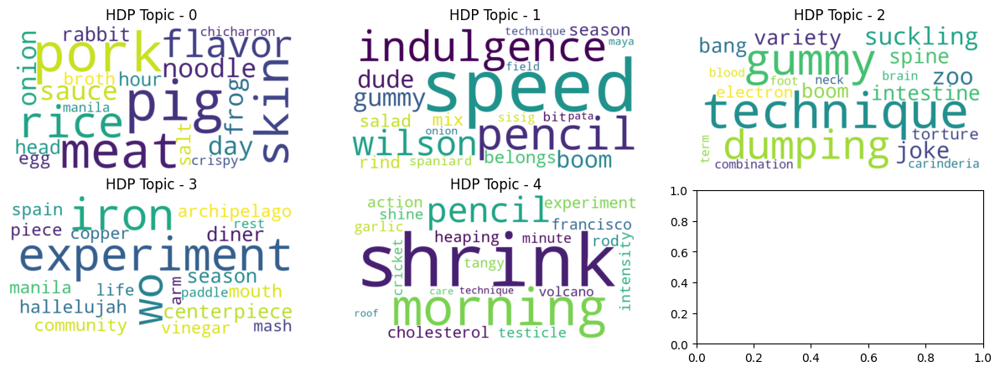

Processing file: MxCDRp4rwXg_captions.txt
HDP Coherence Score for MxCDRp4rwXg_captions.txt: 0.7028



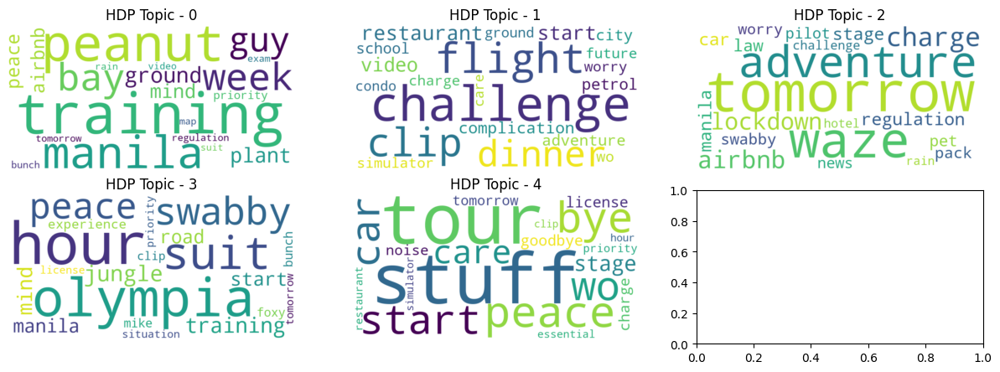

Processing file: 7Dv_TB29xwg_captions.txt
HDP Coherence Score for 7Dv_TB29xwg_captions.txt: 0.3997



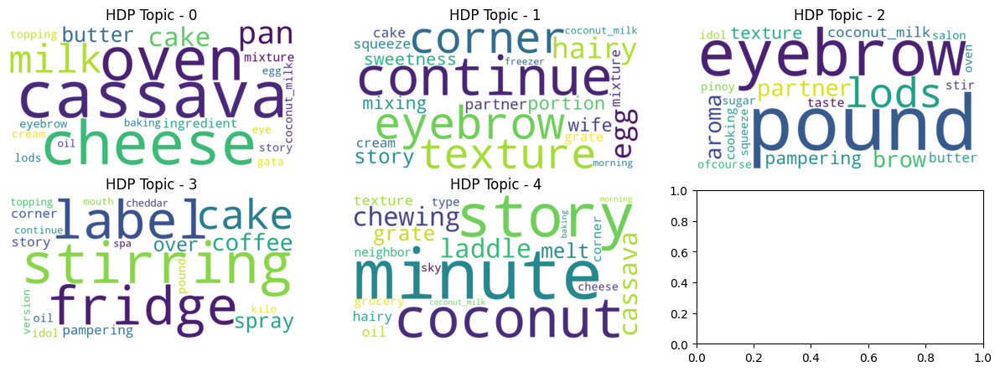

Processing file: Ar0VgO2R6EM_captions.txt
HDP Coherence Score for Ar0VgO2R6EM_captions.txt: 0.4681



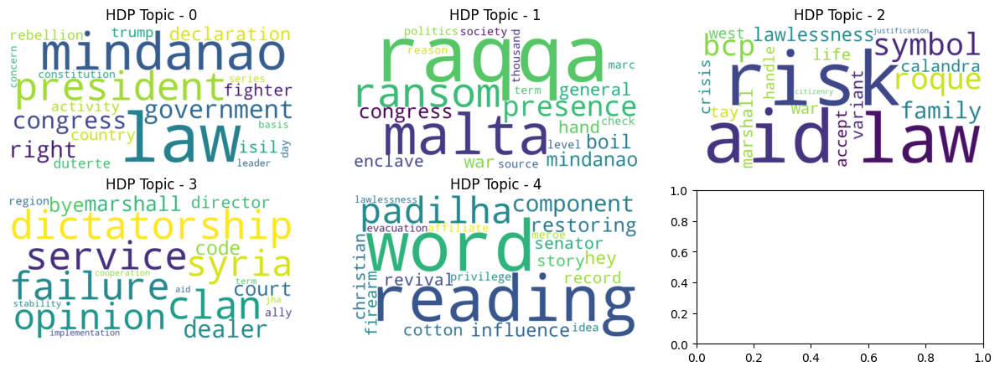

In [20]:
## Function to train HDP
def train_hdp(preprocessed_doc):
    # Create dictionary and corpus for each document
    dictionary = corpora.Dictionary([preprocessed_doc])
    corpus = [dictionary.doc2bow(preprocessed_doc)]

    # Train HDP model for the individual document
    hdp_model = HdpModel(corpus, dictionary)

    # Calculate coherence score
    coherence_model = CoherenceModel(model=hdp_model, texts=[preprocessed_doc], dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model.get_coherence()
    return hdp_model, coherence_score


## Process each document for HDP
for i, doc in enumerate(documents):
    video_id = file_names[i].split('_captions')[0]  
    print(f"Processing file: {file_names[i]}")

    preprocessed_doc = preprocess_text_with_tags(doc, video_id, bigram_model, trigram_model, tag_weight=3)
    
    if len(preprocessed_doc) > 0:
        # Train HDP
        hdp_model, hdp_coherence = train_hdp(preprocessed_doc)
        
        # Print results
        print(f"HDP Coherence Score for {file_names[i]}: {hdp_coherence:.4f}\n")
        
        # Get all topics from the HDP model and limit to 5 topics
        topics = hdp_model.show_topics(formatted=False)[:5]  # Limit to the first 5 topics
        
        # Set the number of columns and calculate the number of rows needed
        num_columns = 3
        num_rows = (len(topics) + num_columns - 1) // num_columns  
        
        # Create a figure with subplots
        fig, axes = plt.subplots(num_rows, num_columns, figsize=(15, 5), squeeze=False)
        
        # Loop through each topic and generate a word cloud
        for idx, (topic_id, topic_terms) in enumerate(topics):
            frequency_dict = {word: weight for word, weight in topic_terms}
            wordcloud_hdp = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(frequency_dict)
            
            ax = axes[idx // num_columns, idx % num_columns]
            ax.imshow(wordcloud_hdp, interpolation='bilinear')
            ax.axis('off')
            ax.set_title(f"HDP Topic - {topic_id}")

        fig.subplots_adjust(hspace=0.1, wspace=0.2)
        plt.show()


Processing file: i-jUGRMh3vQ_captions.txt
LDA Coherence Score for i-jUGRMh3vQ_captions.txt: 0.9009


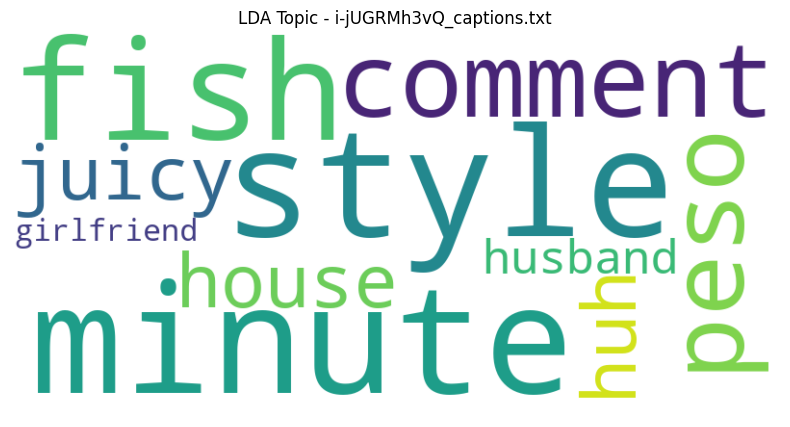

Processing file: dZdOnCkA988_captions.txt
LDA Coherence Score for dZdOnCkA988_captions.txt: 0.2822


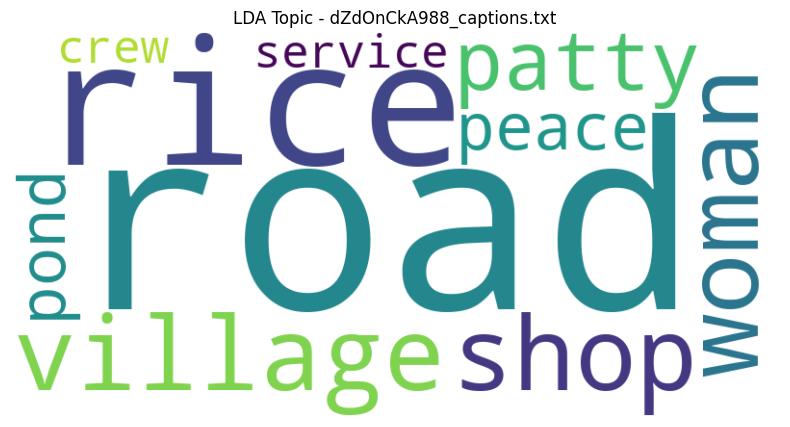

Processing file: 61AVQo4qIYg_captions.txt
LDA Coherence Score for 61AVQo4qIYg_captions.txt: 1.0000


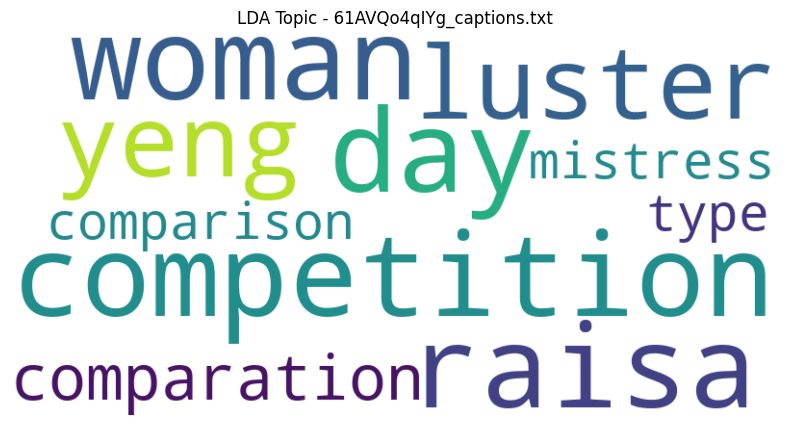

Processing file: A_HLtsg4TVA_captions.txt
LDA Coherence Score for A_HLtsg4TVA_captions.txt: 1.0000


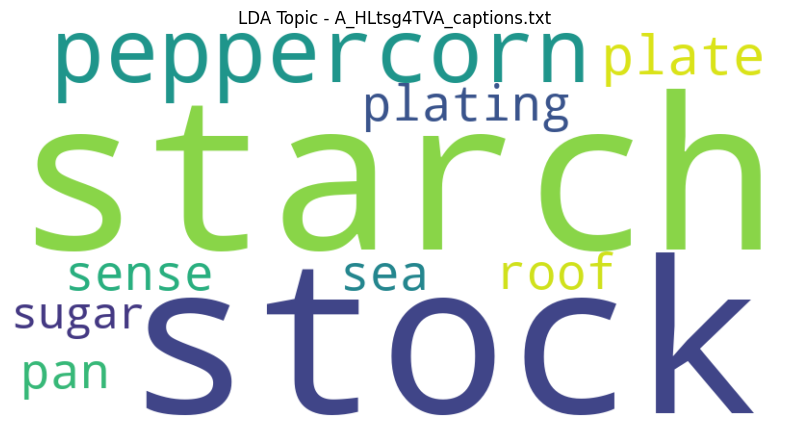

Processing file: 2DIqmd6yQBY_captions.txt
LDA Coherence Score for 2DIqmd6yQBY_captions.txt: 0.4877


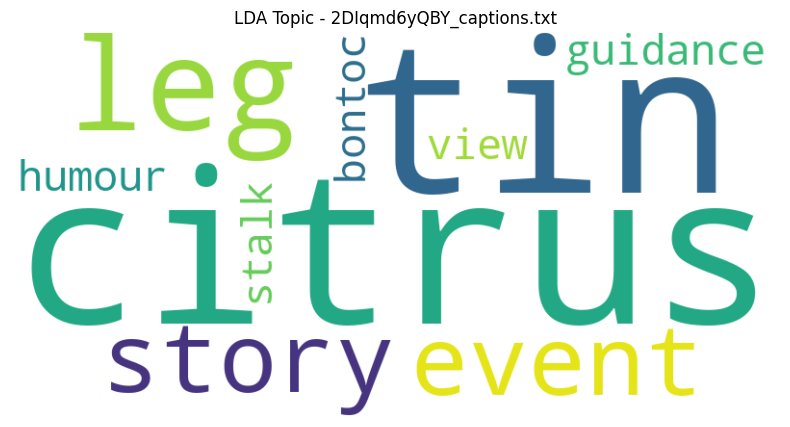

Processing file: K9h7xBf9uzA_captions.txt
LDA Coherence Score for K9h7xBf9uzA_captions.txt: 0.2445


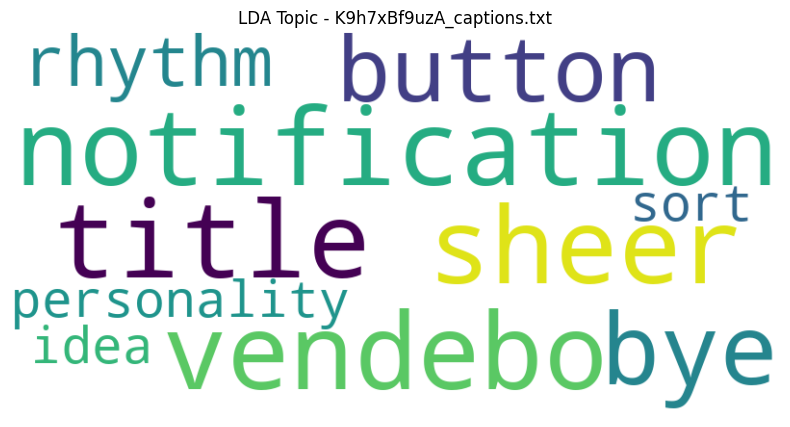

Processing file: Al7xFwszHQM_captions.txt
LDA Coherence Score for Al7xFwszHQM_captions.txt: 0.2434


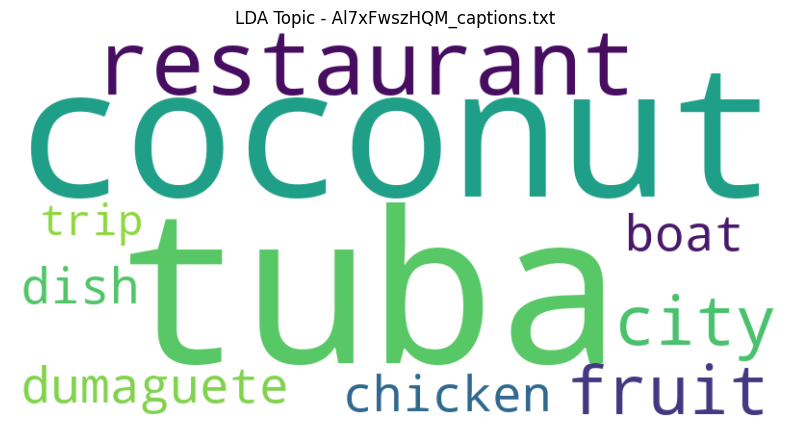

Processing file: Wfjhdicwj60_captions.txt
LDA Coherence Score for Wfjhdicwj60_captions.txt: 0.2764


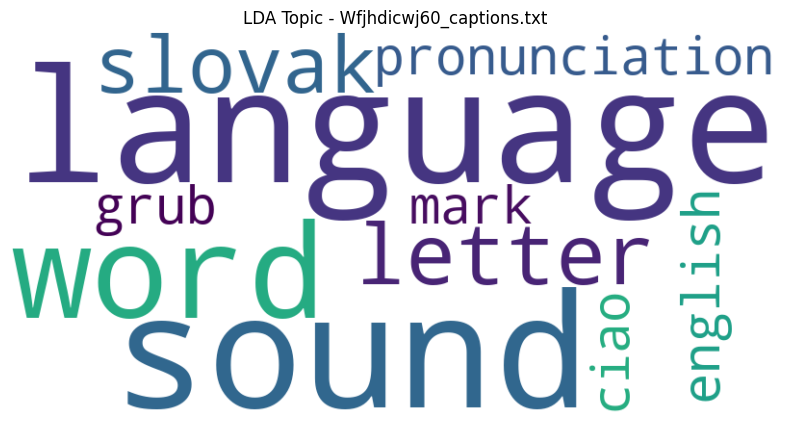

Processing file: L79qy1_s3Ak_captions.txt
LDA Coherence Score for L79qy1_s3Ak_captions.txt: 0.2585


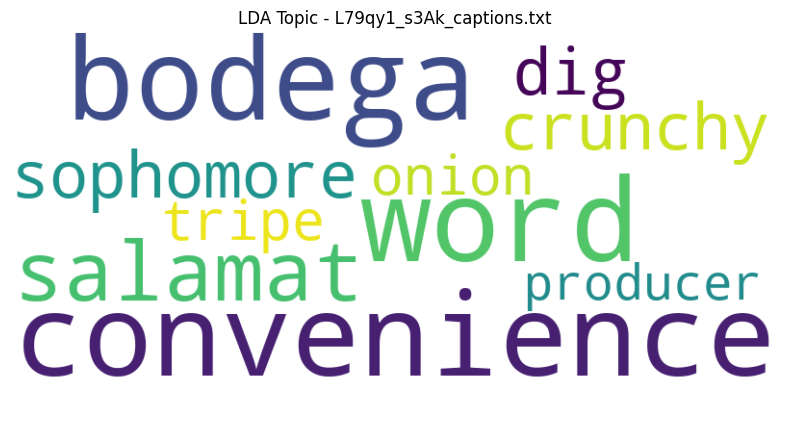

Processing file: JT5AVuqTeaE_captions.txt
LDA Coherence Score for JT5AVuqTeaE_captions.txt: 0.2877


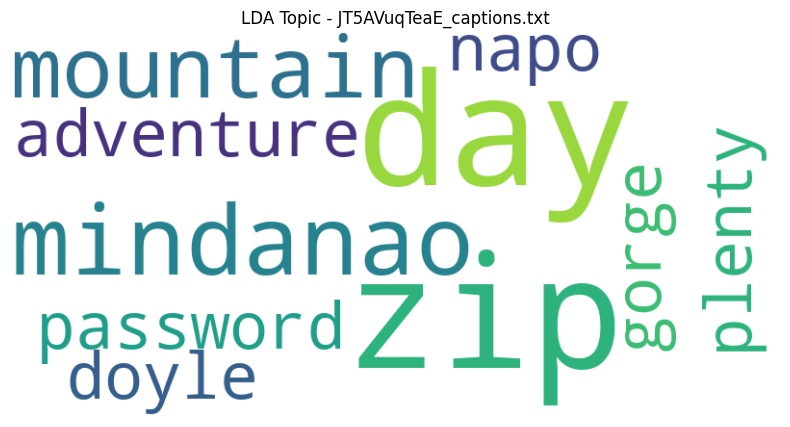

Processing file: RE9-FzyT28Q_captions.txt
LDA Coherence Score for RE9-FzyT28Q_captions.txt: 0.4627


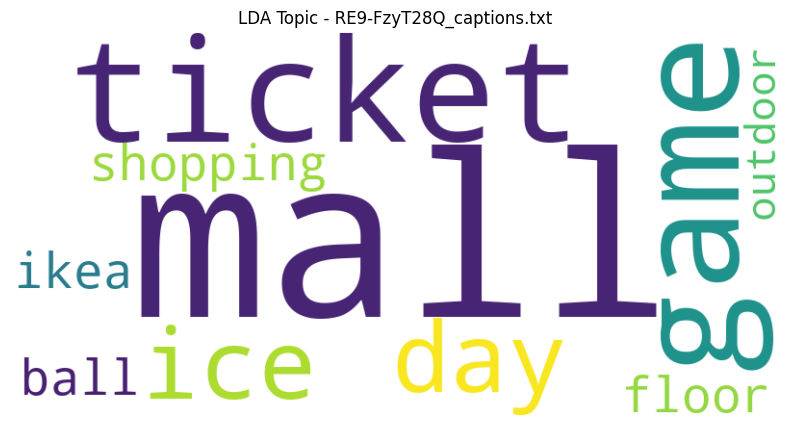

Processing file: bAn0qP3BHcI_captions.txt
LDA Coherence Score for bAn0qP3BHcI_captions.txt: 1.0000


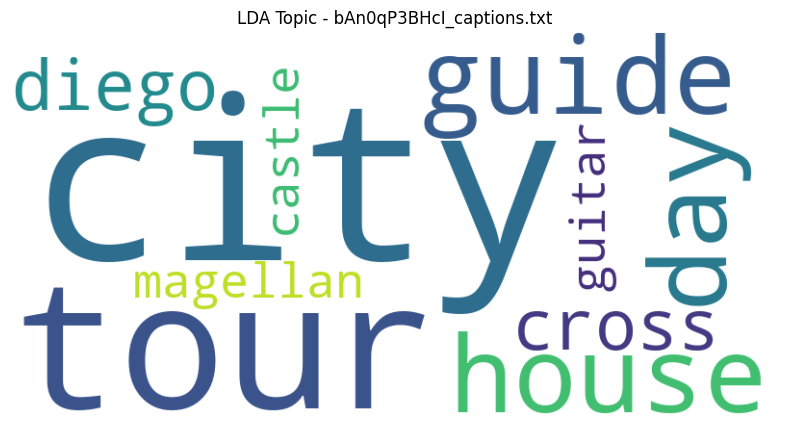

Processing file: GOnvVafj31k_captions.txt
LDA Coherence Score for GOnvVafj31k_captions.txt: 0.7553


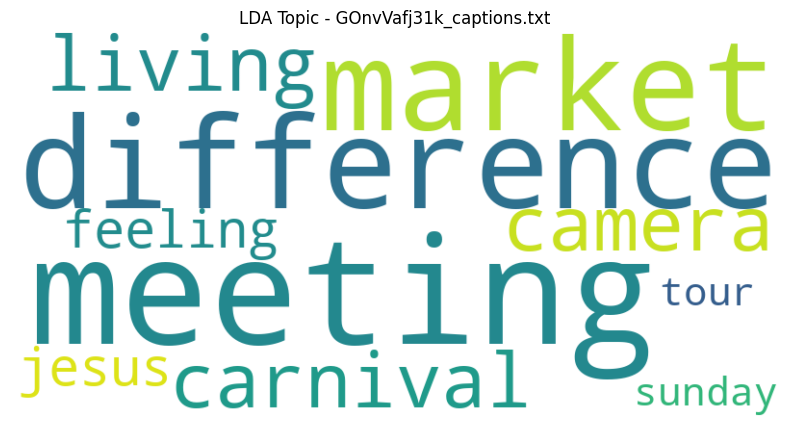

Processing file: R8IaZ0NdLC4_captions.txt
LDA Coherence Score for R8IaZ0NdLC4_captions.txt: 0.2982


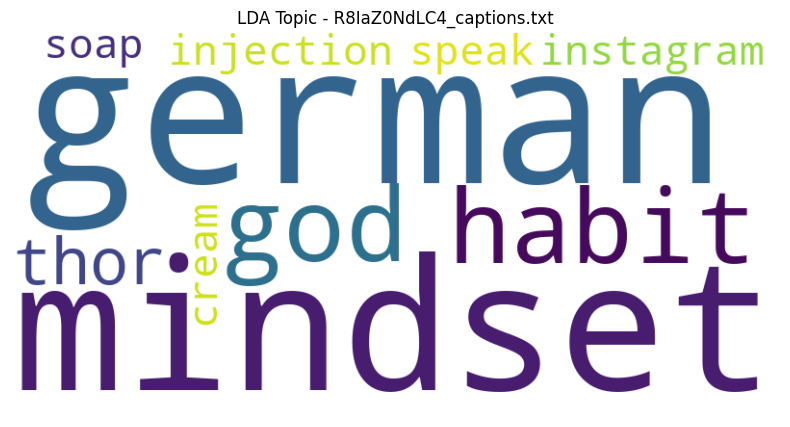

Processing file: bQBVLIkzcrw_captions.txt
LDA Coherence Score for bQBVLIkzcrw_captions.txt: 0.8218


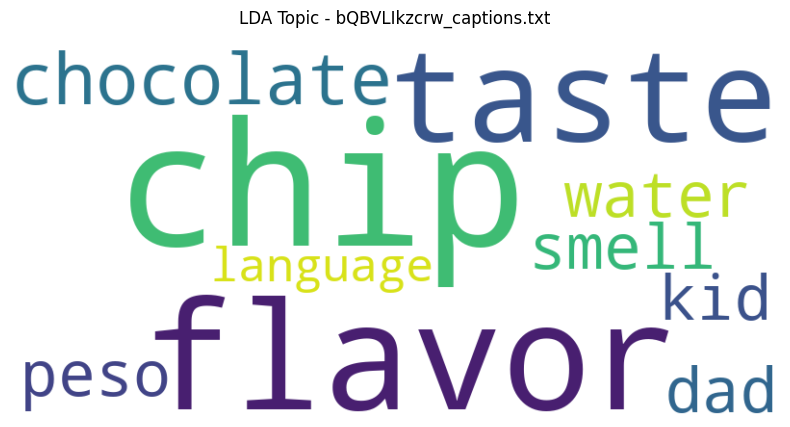

Processing file: EUkFRzflw20_captions.txt
LDA Coherence Score for EUkFRzflw20_captions.txt: 0.3720


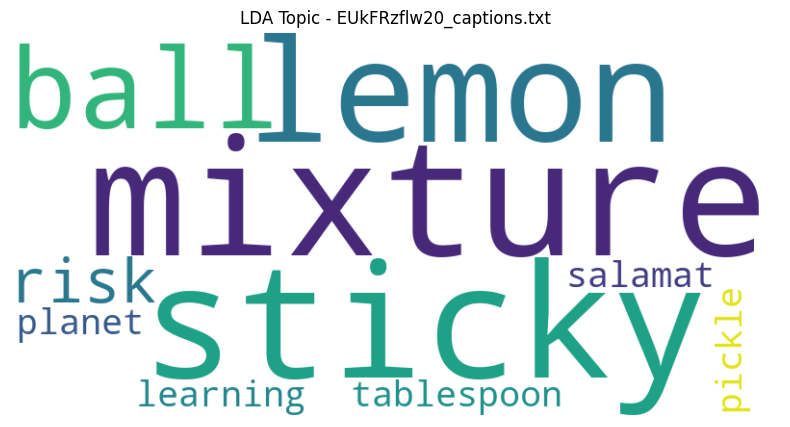

Processing file: fZ4XAWBDpFc_captions.txt
LDA Coherence Score for fZ4XAWBDpFc_captions.txt: 1.0000


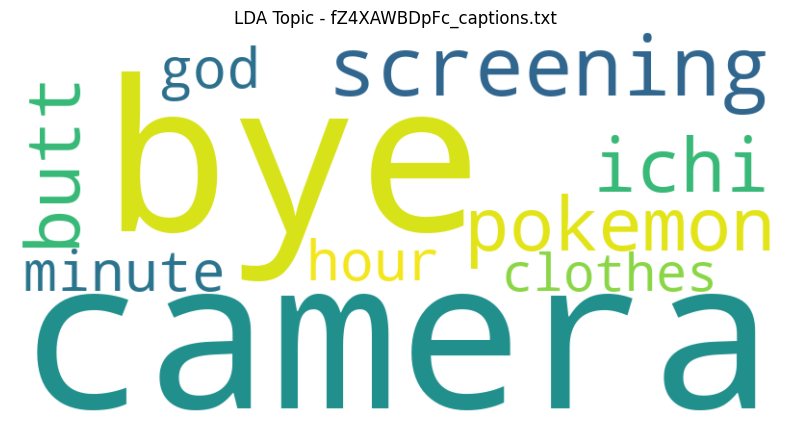

Processing file: datYaDOz2R8_captions.txt
LDA Coherence Score for datYaDOz2R8_captions.txt: 0.3064


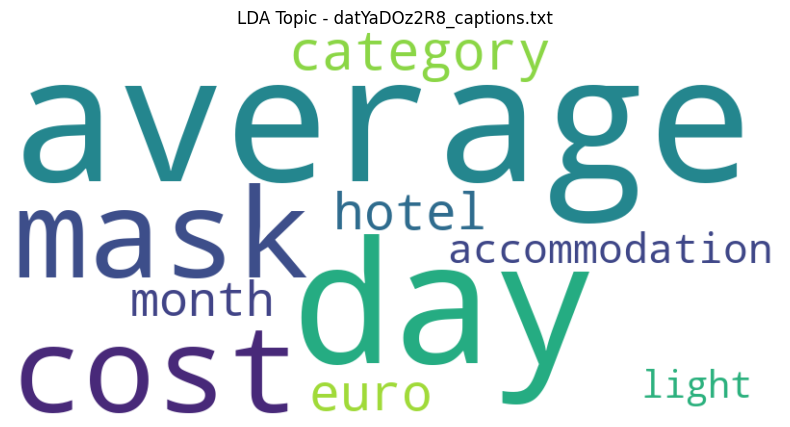

Processing file: eyqPUI8wKdc_captions.txt
LDA Coherence Score for eyqPUI8wKdc_captions.txt: 0.6895


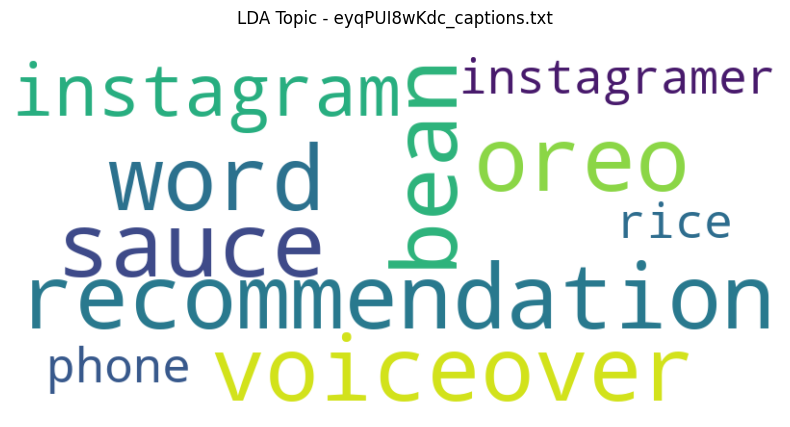

Processing file: A2_vSVmLeQs_captions.txt
LDA Coherence Score for A2_vSVmLeQs_captions.txt: 0.3111


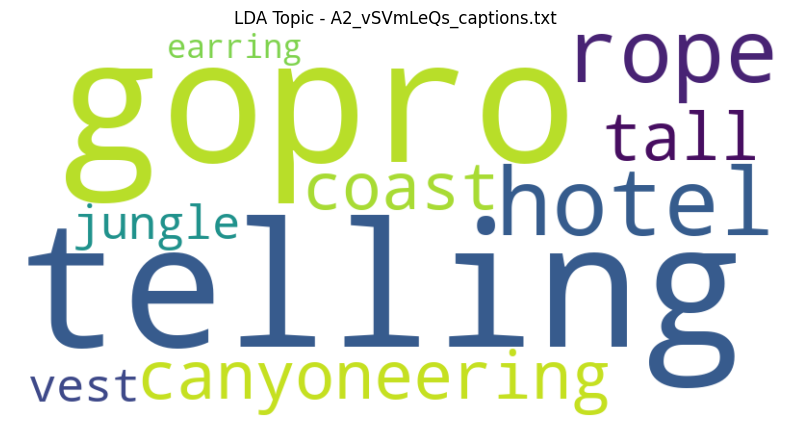

Processing file: 6TiMvS0rE2I_captions.txt
LDA Coherence Score for 6TiMvS0rE2I_captions.txt: 0.6736


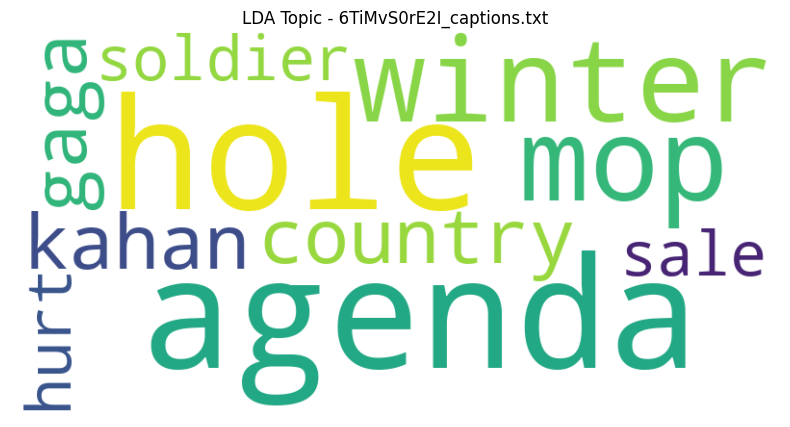

Processing file: mzlQGtKF2nc_captions.txt
LDA Coherence Score for mzlQGtKF2nc_captions.txt: 1.0000


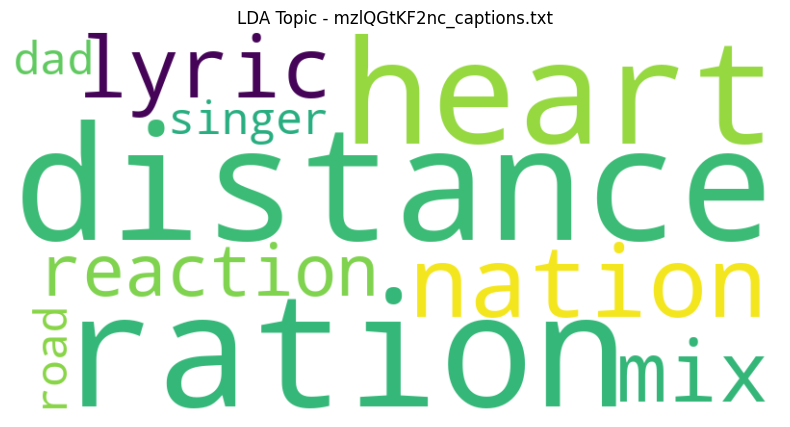

Processing file: puxKH-_9xGM_captions.txt
LDA Coherence Score for puxKH-_9xGM_captions.txt: 0.3241


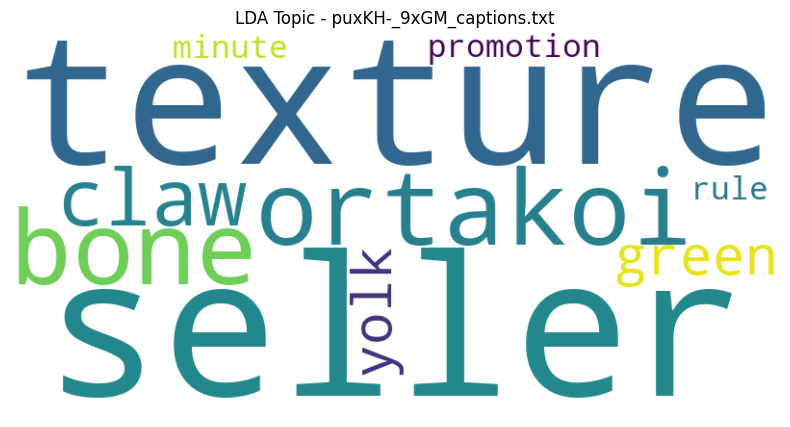

Processing file: BXSZVp68G_M_captions.txt
LDA Coherence Score for BXSZVp68G_M_captions.txt: 0.4376


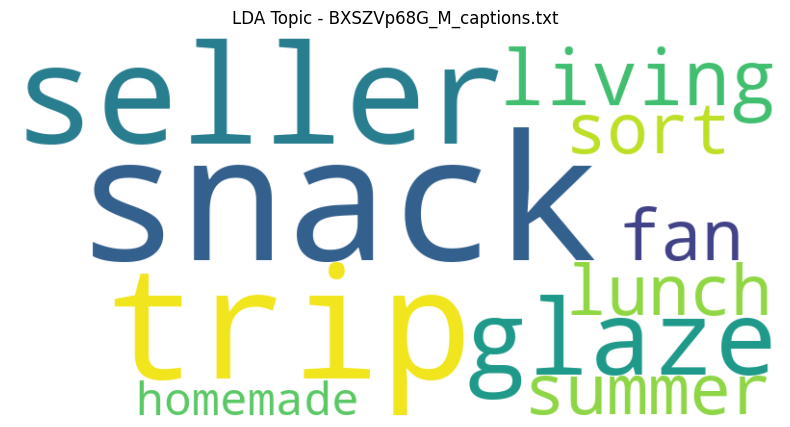

Processing file: kcUTnM5Flpg_captions.txt
LDA Coherence Score for kcUTnM5Flpg_captions.txt: 1.0000


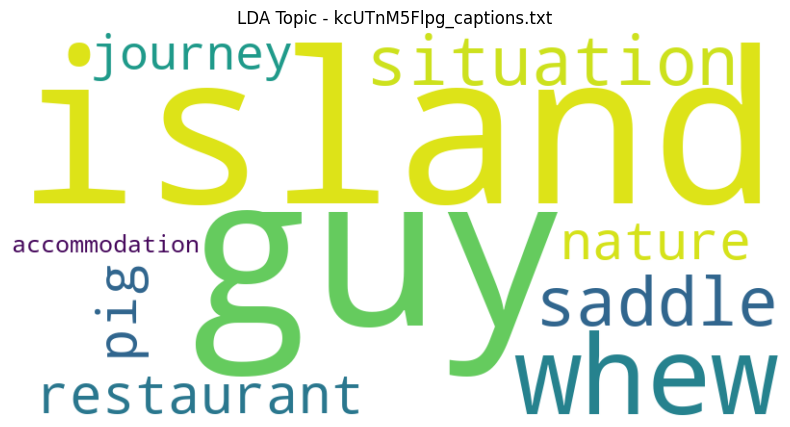

Processing file: Pcv_bImJR3s_captions.txt
LDA Coherence Score for Pcv_bImJR3s_captions.txt: 0.3487


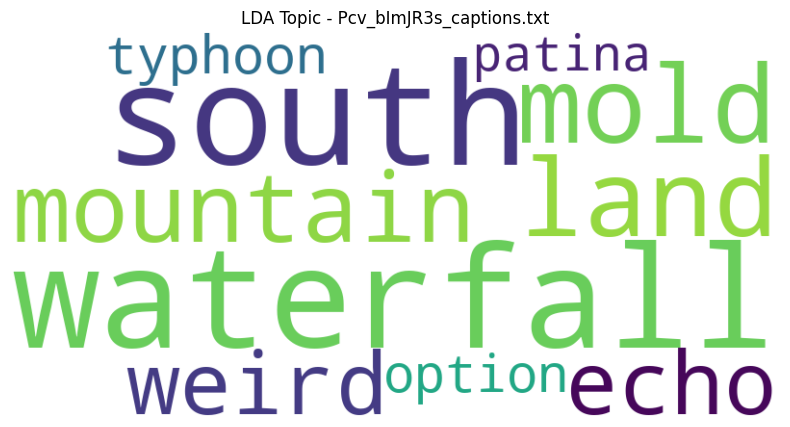

Processing file: QaumqNGe8Oc_captions.txt
LDA Coherence Score for QaumqNGe8Oc_captions.txt: 0.2556


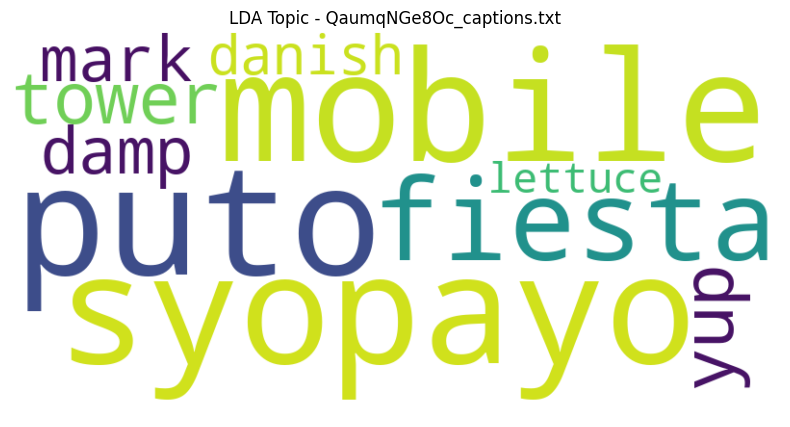

Processing file: 8WOHRXf1sj0_captions.txt
LDA Coherence Score for 8WOHRXf1sj0_captions.txt: 0.3557


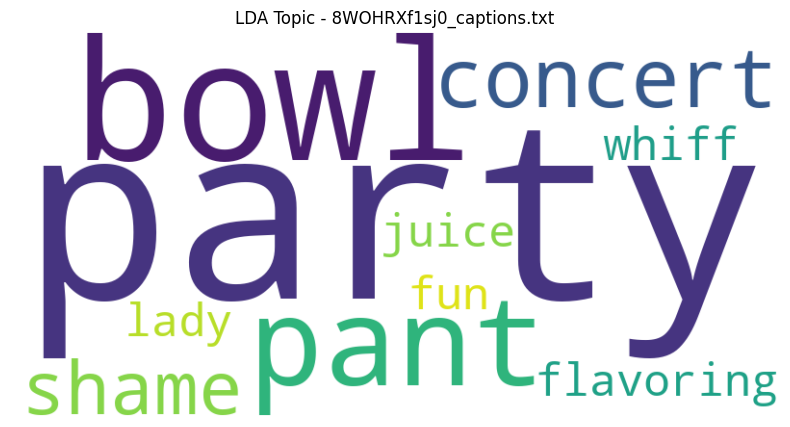

Processing file: kTrjYBGGol0_captions.txt
LDA Coherence Score for kTrjYBGGol0_captions.txt: 0.5948


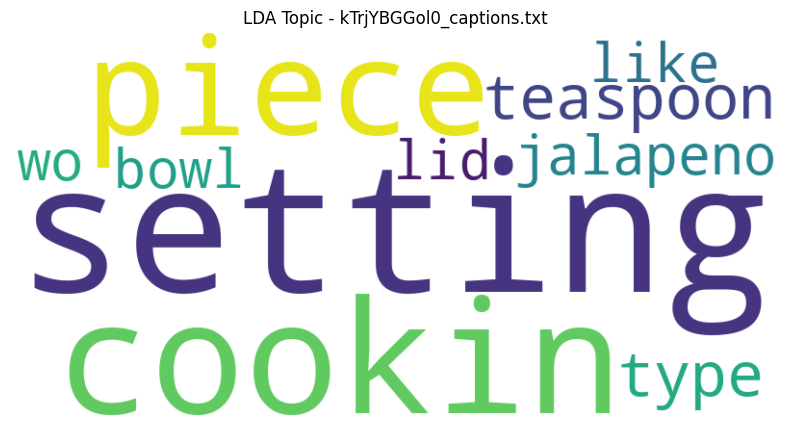

Processing file: f706f6KNCEM_captions.txt
LDA Coherence Score for f706f6KNCEM_captions.txt: 1.0000


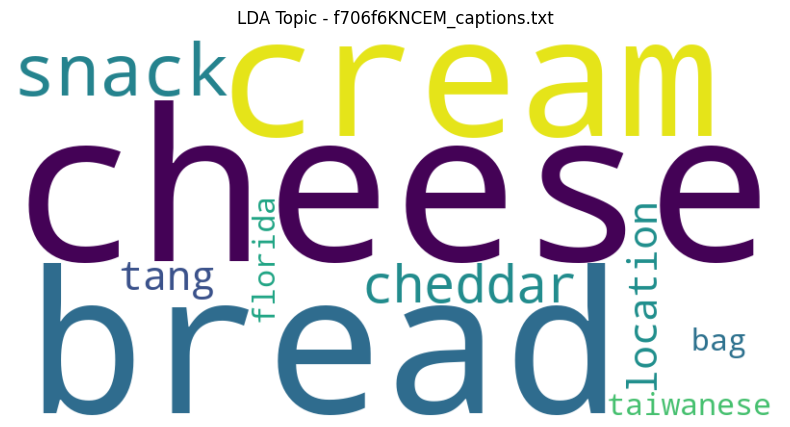

Processing file: 9_Iu3w6DVyQ_captions.txt
LDA Coherence Score for 9_Iu3w6DVyQ_captions.txt: 0.3961


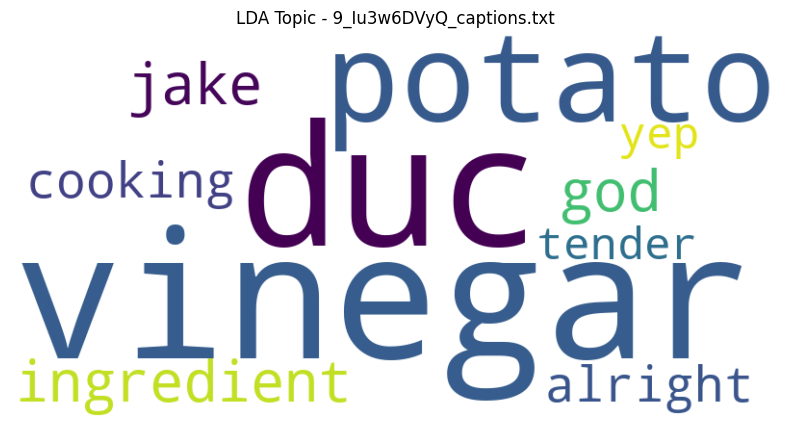

Processing file: 3kftPeWMvLk_captions.txt
LDA Coherence Score for 3kftPeWMvLk_captions.txt: 0.3195


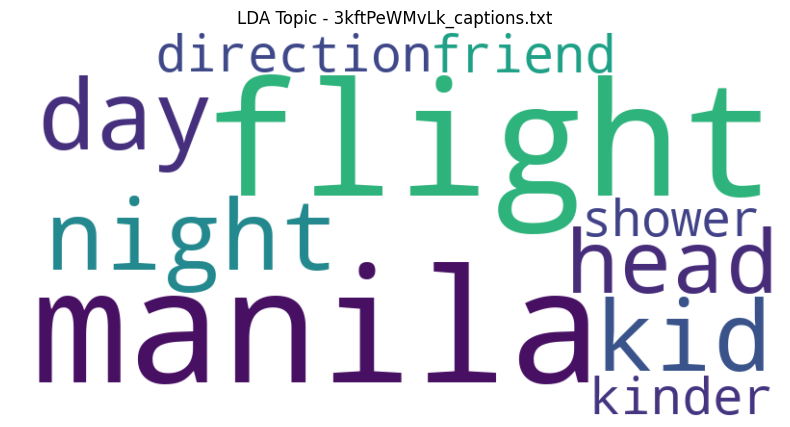

Processing file: UFQNp1v_XQU_captions.txt
LDA Coherence Score for UFQNp1v_XQU_captions.txt: 1.0000


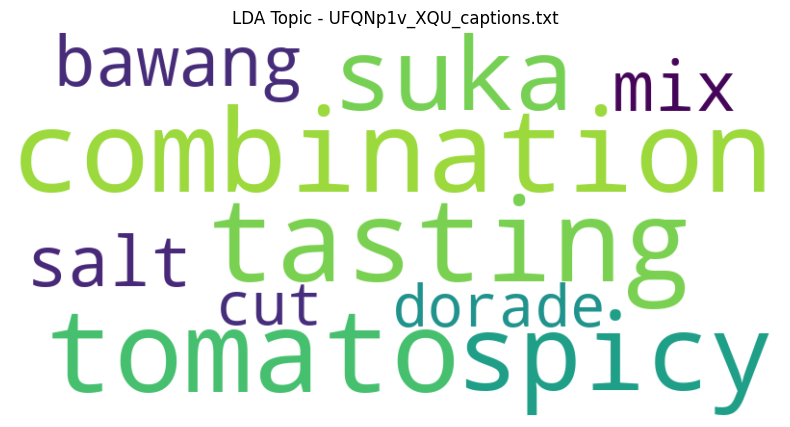

Processing file: jMLdbmElS8w_captions.txt
LDA Coherence Score for jMLdbmElS8w_captions.txt: 1.0000


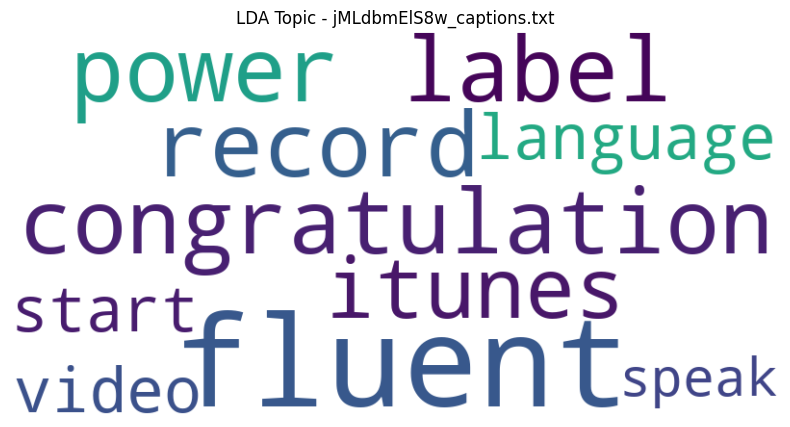

Processing file: EIFjXZ4E9Yk_captions.txt
LDA Coherence Score for EIFjXZ4E9Yk_captions.txt: 0.5277


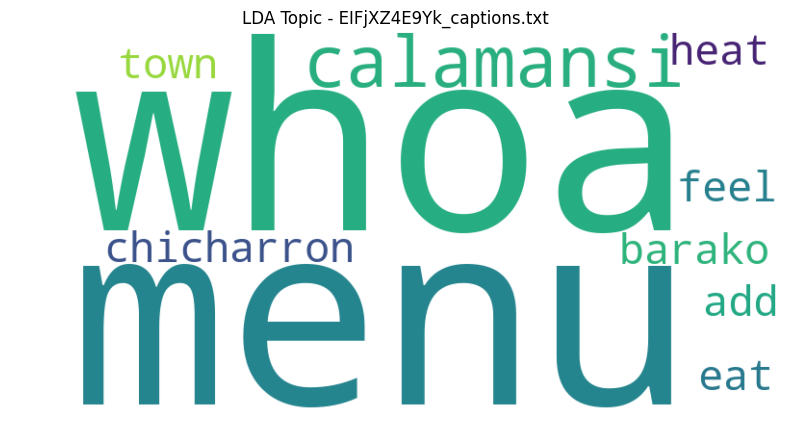

Processing file: VYMSkjeA0qg_captions.txt
LDA Coherence Score for VYMSkjeA0qg_captions.txt: 0.2676


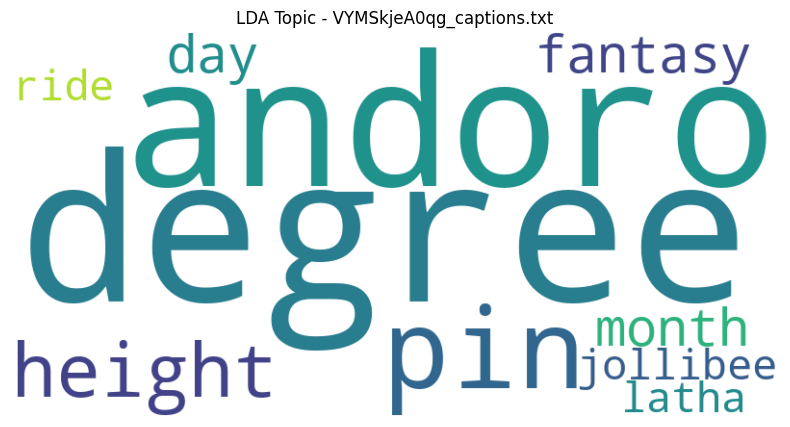

Processing file: glHqnIsRB9o_captions.txt
LDA Coherence Score for glHqnIsRB9o_captions.txt: 0.3279


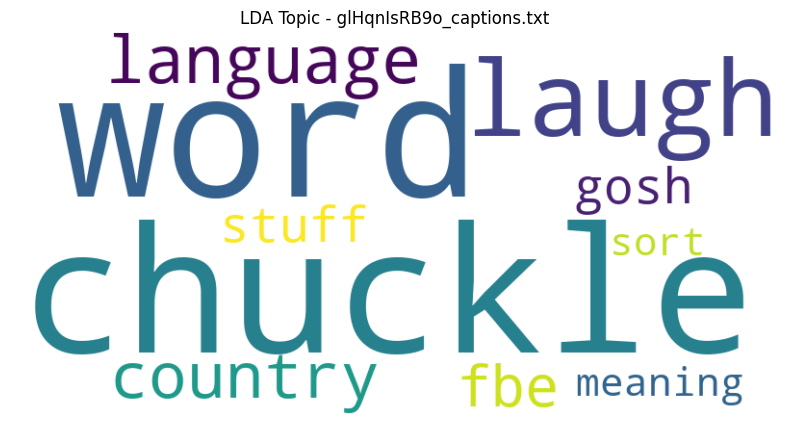

Processing file: 9H891iA0xGk_captions.txt
LDA Coherence Score for 9H891iA0xGk_captions.txt: 1.0000


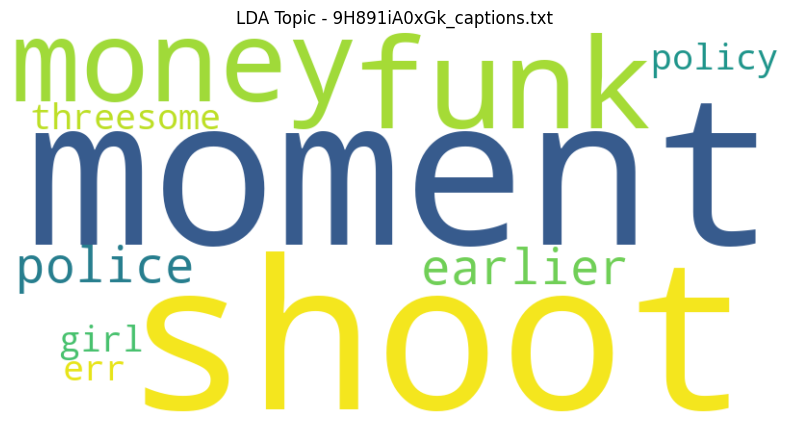

Processing file: dGxnilrs8aU_captions.txt
LDA Coherence Score for dGxnilrs8aU_captions.txt: 0.4452


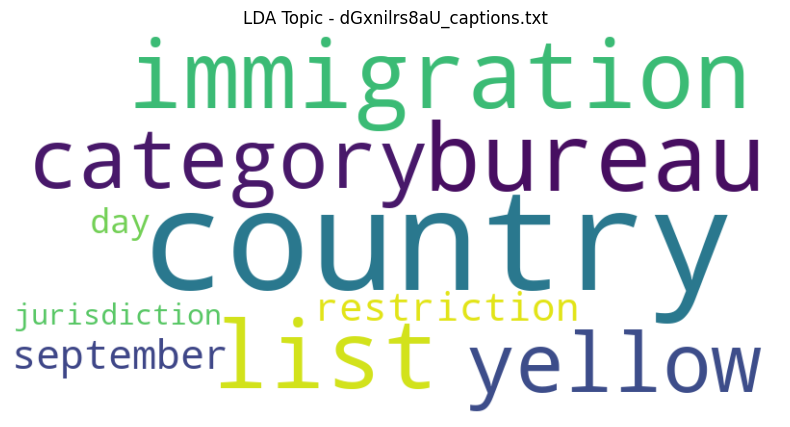

Processing file: IZA1t7vmai4_captions.txt
LDA Coherence Score for IZA1t7vmai4_captions.txt: 1.0000


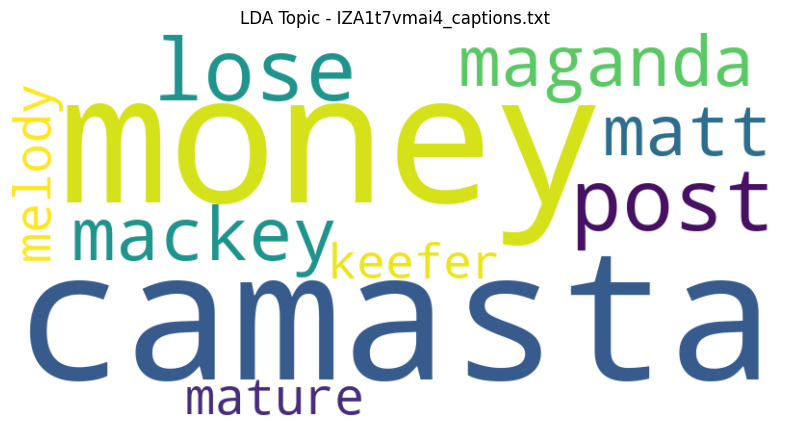

Processing file: e5mAUbRosCY_captions.txt
LDA Coherence Score for e5mAUbRosCY_captions.txt: 0.3137


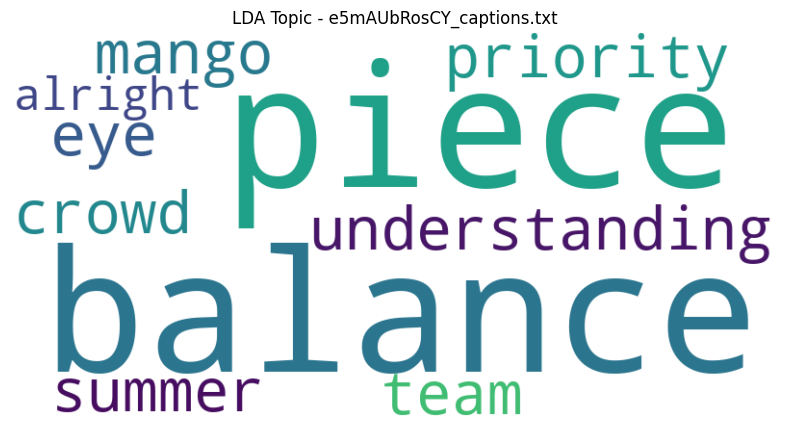

Processing file: R9ya0jtNpGs_captions.txt
LDA Coherence Score for R9ya0jtNpGs_captions.txt: 1.0000


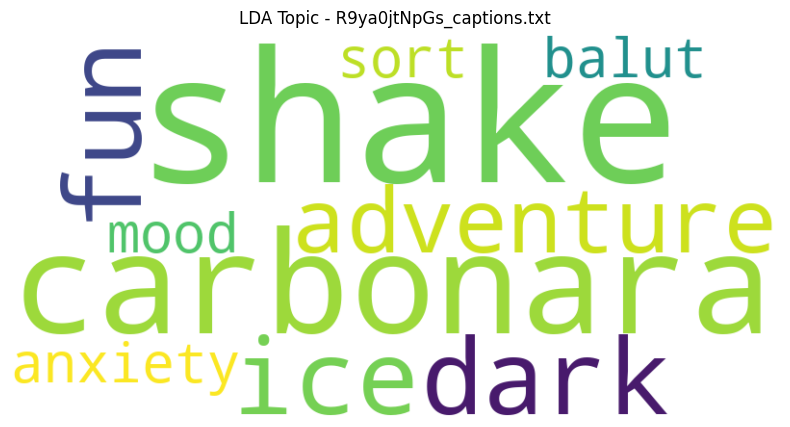

Processing file: jQaxzqZztNM_captions.txt
LDA Coherence Score for jQaxzqZztNM_captions.txt: 0.7080


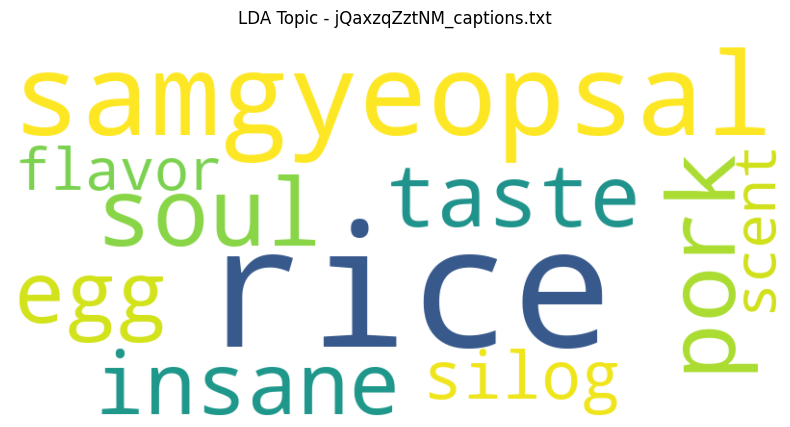

Processing file: UdwwDXhiPHA_captions.txt
LDA Coherence Score for UdwwDXhiPHA_captions.txt: 0.1994


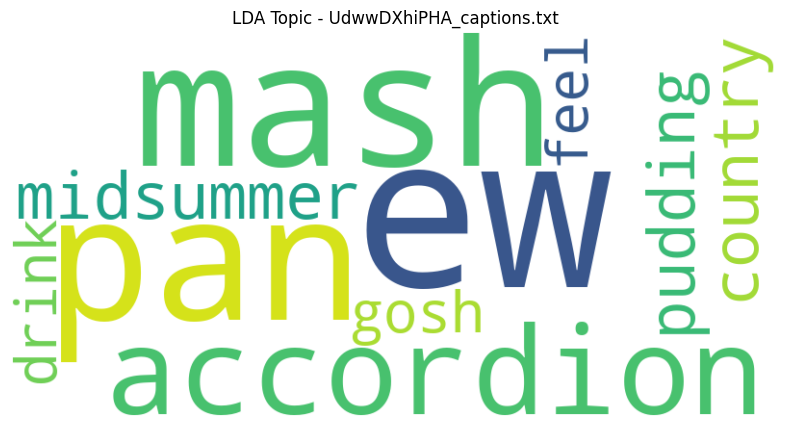

Processing file: IkusGn6DhGo_captions.txt
LDA Coherence Score for IkusGn6DhGo_captions.txt: 1.0000


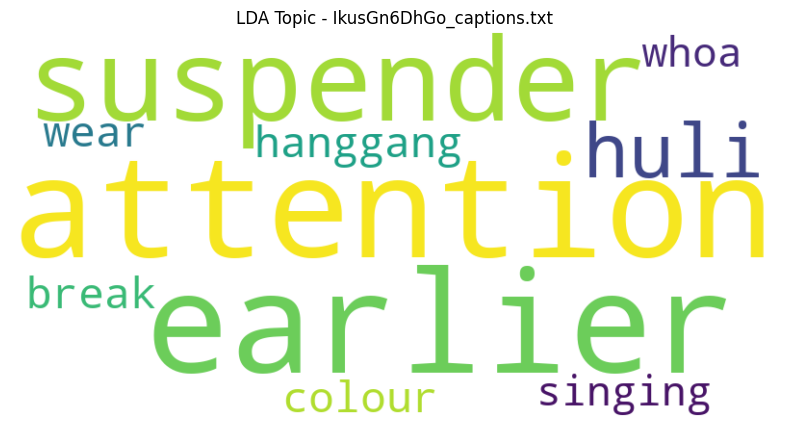

Processing file: oCjN8zrUzFM_captions.txt
LDA Coherence Score for oCjN8zrUzFM_captions.txt: 0.3139


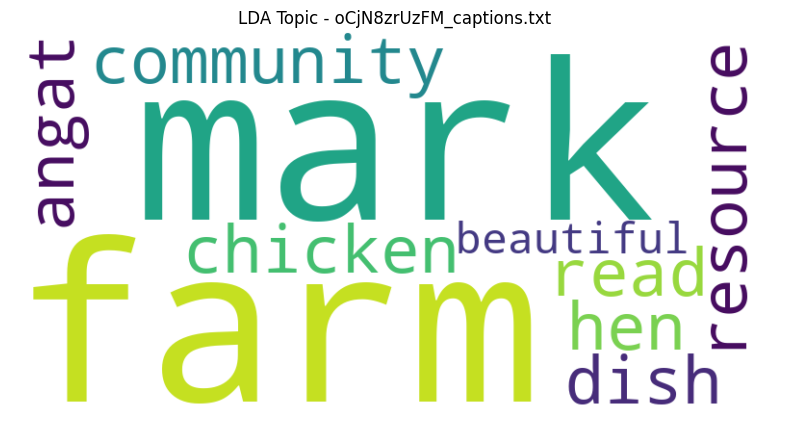

Processing file: KPOFO1kxckg_captions.txt
LDA Coherence Score for KPOFO1kxckg_captions.txt: 1.0000


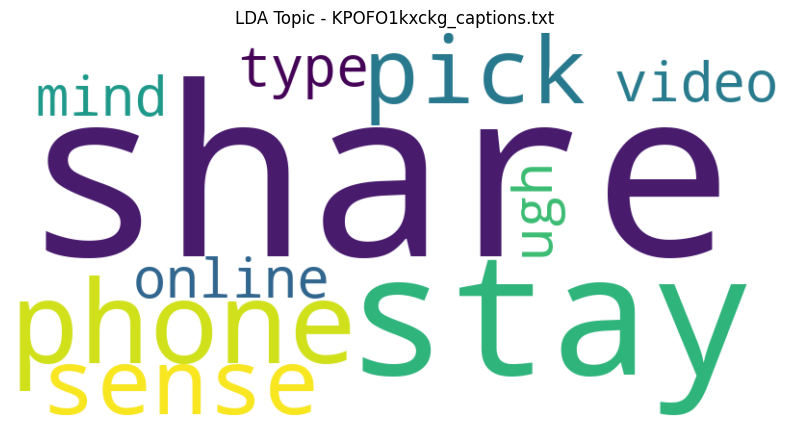

Processing file: _ximeemA3OI_captions.txt
LDA Coherence Score for _ximeemA3OI_captions.txt: 0.5537


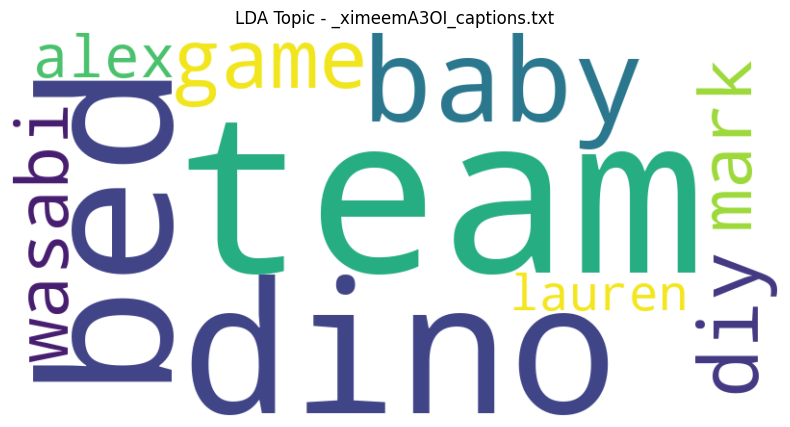

In [1]:
import os
import string
import random
import requests
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk import pos_tag
from gensim import corpora
from gensim.models.ldamodel import LdaModel
from gensim.models.coherencemodel import CoherenceModel
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Folder paths
transcripts_folder_path = 'cleaned_transcripts/'
tags_folder_path = 'tags/'  # Update with your tags folder path

# Read random sample of text files with at least 100 words
def load_random_documents(folder_path, sample_size=50):
    all_files = [file_name for file_name in os.listdir(folder_path) if file_name.endswith('.txt')]
    sampled_files = random.sample(all_files, min(sample_size, len(all_files)))  # Randomly sample files

    documents = []
    file_names = []
    for file_name in sampled_files:
        with open(os.path.join(folder_path, file_name), 'r', encoding='utf-8') as file:
            content = file.read().lower()  # Convert text to lowercase while reading
            if len(content.split()) >= 100:  # Only process files with at least 100 words
                documents.append(content)
                file_names.append(file_name)
    return documents, file_names

documents, file_names = load_random_documents(transcripts_folder_path)

# Load video tags
def load_video_tags(folder_path):
    video_tags = {}
    for file_name in os.listdir(folder_path):
        if file_name.endswith('.txt'):
            video_id = file_name.split('_')[0]  # Extract video ID from filename
            with open(os.path.join(folder_path, file_name), 'r', encoding='utf-8') as file:
                tags_content = file.read().lower()  # Read and convert to lowercase
                video_tags[video_id] = tags_content.split()  # Store tags as a list of words
    return video_tags

# Load video tags
video_tags = load_video_tags(tags_folder_path)

# Function to fetch stopwords from GitHub URL
def fetch_stopwords_from_github(url):
    response = requests.get(url)
    github_stopwords = response.text.splitlines()  # Split by new lines
    return set(github_stopwords)

# GitHub URL for stopwords
github_stopwords_url = 'https://raw.githubusercontent.com/stopwords-iso/stopwords-en/master/stopwords-en.txt'
github_stopwords = fetch_stopwords_from_github(github_stopwords_url)

stop_words = set(stopwords.words('english'))
custom_stop_words = ['like', 'yeah', 'know', 'um', 'uh', 'really', 'one', 'go', 'right', 'okay', 'well', 'said', 
                     'going', 'got', 'na', 'always', 'every', 'each', 'say', 'el', 'little', 'still', 
                     'best', 'dutch', 'nice', 'great', 'awesome', 'good', 'cool', 'love', 'amazing', 'wow' ]
broad_terms = ['philippines', 'philippine', 'british', 'filipino', 'video', 'http', 'korea', 'korean', 
               'youtube', 'google', 'united', 'america', 'american']
kpop_keywords = ['kpop', '필리핀', 'bts', 'blackpink', 'twice', 'exo', 'k-pop', 'seventeen', 
                 'stray kids', 'nct', 'kdrama', 'aespa', 'taehyung', 'jimin', 'jungkook']
more_keywords = [
    'breaking news', 'report', 'coverage', 'investigation', 'interview', 'documentary', 
    'journalist', 'headline', 'reporter', 'current events', 'special report', 
    'analysis', 'documented', 'broadcast', 'reporting', 'v', 'food', 'travel', 'react', 
    'reacts', 'reaction', 'foreigner', 'thing', 'visit', 'dc', 'japan', 'first', 'fast', 
    'asia', 'ang', 'indian', 'thai', 'vietnamese', 'russia', 'gon', 'canada', 'canadian', 'russian', 
    'russia', 'guy', 'lot', 'bit', 'diba', 'ola', 'cuz', 'thai', 'thailand', 'person', 'citizen', 'foreigner', 'foreign', 'foreigners',
    'facebook', 'filipinos', 'filipinas', 'vlog', 'vlogs', 'vlogging', 'hashtag', 'india', 'bro', 'dito', 'people', 'time', 'music'
]

# Add custom and broad terms
stop_words.update(custom_stop_words, broad_terms, kpop_keywords, more_keywords, github_stopwords)

# Lemmatizer
lemmatizer = WordNetLemmatizer()

# Function to filter out unwanted words
def is_valid_word(word, pos):
    # Regex to match patterns like [Music], [Laughter], etc., with optional whitespace
    unwanted_pattern = re.compile(r'^\s*\[.*\]\s*$', re.IGNORECASE)
    return (
        not re.search(r'(.)\1{2,}', word) and  # Avoid repeated characters
        word not in stop_words and            # Check against stop words
        pos not in ['JJ', 'RB', 'JJR', 'JJS', 'VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ'] and  # Avoid certain POS tags
        not unwanted_pattern.match(word)      # Filter out unwanted patterns
    )

# Update preprocess_text function to include tags with increased weight
def preprocess_text_with_tags(doc, video_id, tag_weight=3):
    tokens = word_tokenize(doc.lower())
    tokens_with_pos = pos_tag(tokens)
    tokens = [lemmatizer.lemmatize(word) for word, pos in tokens_with_pos if word.isalpha() and is_valid_word(word, pos)]
    
    # Include video tags for the specific video ID with increased weight
    if video_id in video_tags:
        tags = video_tags[video_id]
        # Add tags multiple times to increase their weight
        tokens += tags * tag_weight  # Repeat tags based on the weight specified
    
    return ' '.join(tokens)

# Process each document for LDA
for i, doc in enumerate(documents):
    video_id = file_names[i].split('_captions')[0]  # Extract video ID including underscores before 'captions'
    print(f"Processing file: {file_names[i]}")

    preprocessed_doc = preprocess_text_with_tags(doc, video_id)
    
    if len(preprocessed_doc) > 0:
        # Train LDA using TF-IDF
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform([preprocessed_doc])
        
        # Create dictionary and corpus from the TF-IDF matrix
        dictionary = corpora.Dictionary([preprocessed_doc.split()])
        corpus = [dictionary.doc2bow(preprocessed_doc.split())]

        # Train LDA model for the document
        lda_model = LdaModel(corpus, num_topics=3, id2word=dictionary, passes=50, random_state=42)

        # Calculate coherence score
        coherence_model = CoherenceModel(model=lda_model, texts=[preprocessed_doc.split()], dictionary=dictionary, coherence='c_v')
        coherence_score = coherence_model.get_coherence()
        
        # Print results
        print(f"LDA Coherence Score for {file_names[i]}: {coherence_score:.4f}")

        # Optionally display WordCloud for the topics
        wordcloud_lda = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(dict(lda_model.show_topic(0)))

        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud_lda, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"LDA Topic - {file_names[i]}")
        plt.show()
